In [1]:
#Abertura das Bibliotecas utilizadas
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import netCDF4 as nc
import plotly.express as px
import plotly.graph_objects as go
import cartopy.crs as ccrs # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cfeature
import matplotlib.patches as mpatches # Desenhar geometria em um mapa
import matplotlib.ticker as mticker
import rasterio

# Funções

In [2]:
def FazMapa(Base,valor,max,min):
    #Criando Mapa de Temperatura Anual média
    import matplotlib.pyplot as plt
    import numpy as np
    import cartopy.crs as ccrs # Escolha do sistema de coordenadas
    from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
    import xarray as xr
    import cartopy.feature as cfeature
    
    # Configurar o plot
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
    
    # Plotar a média da temperatura
    
    Base.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='jet',levels=np.linspace(min, max, 65), cbar_kwargs={'label': 'Temperatura (°C)'})
    
    #levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 
    
    
    #Adicionando o contorno dos continentes, países e estados do Brasil
    #Adicionando o contorno dos continentes
    ax.add_feature(cfeature.COASTLINE)
    
    #Adicionando os limites dos países
    ax.add_feature(cfeature.BORDERS)
    
    #Adicionando o oceano
    ax.add_feature(cfeature.OCEAN)
    
    #Adicionando os limites estaduais
    states = cfeature.NaturalEarthFeature(category='cultural',
                                          name='admin_1_states_provinces_lines',
                                          scale='50m',
                                          facecolor='none')
    ax.add_feature(states, edgecolor='k', linestyle='--')
    
    #Adicionando título a figura 
    ax.set_title(valor, fontsize=20, y=1.04)
    
    #Adicionando as linhas de grade
    g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)
    
    #Formatando os labels como latitude e longitude
    g1.yformatter = LATITUDE_FORMATTER
    g1.xformatter = LONGITUDE_FORMATTER
    
    #agora irei tirar as grades  superior e direita
    # Remove as linhas de grade à direita
    g1.ylabels_right = False  # Remove labels do eixo y à direita
    g1.right_labels = False  # Remove a linha de grade à direita
    g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas
    
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    g1.top_labels = False  # Remove a linha de grade no topo

In [3]:
def FazMapaperc(Base,valor,max,min):
    #Criando Mapa de Temperatura Anual média
    import matplotlib.pyplot as plt
    import numpy as np
    import cartopy.crs as ccrs # Escolha do sistema de coordenadas
    from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
    import xarray as xr
    import cartopy.feature as cfeature
    
    # Configurar o plot
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
    
    # Plotar a média da temperatura
    
    Base.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='jet',levels=np.linspace(min, max, 65), cbar_kwargs={'label': '%'})
    
    #levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 
    
    
    #Adicionando o contorno dos continentes, países e estados do Brasil
    #Adicionando o contorno dos continentes
    ax.add_feature(cfeature.COASTLINE)
    
    #Adicionando os limites dos países
    ax.add_feature(cfeature.BORDERS)
    
    #Adicionando o oceano
    ax.add_feature(cfeature.OCEAN)
    
    #Adicionando os limites estaduais
    states = cfeature.NaturalEarthFeature(category='cultural',
                                          name='admin_1_states_provinces_lines',
                                          scale='50m',
                                          facecolor='none')
    ax.add_feature(states, edgecolor='k', linestyle='--')
    
    #Adicionando título a figura 
    ax.set_title(valor, fontsize=20, y=1.04)
    
    #Adicionando as linhas de grade
    g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)
    
    #Formatando os labels como latitude e longitude
    g1.yformatter = LATITUDE_FORMATTER
    g1.xformatter = LONGITUDE_FORMATTER
    
    #agora irei tirar as grades  superior e direita
    # Remove as linhas de grade à direita
    g1.ylabels_right = False  # Remove labels do eixo y à direita
    g1.right_labels = False  # Remove a linha de grade à direita
    g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas
    
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    g1.top_labels = False  # Remove a linha de grade no topo

In [4]:
def GraficoCidade(Dado,Nome,Cidade,latitude,longitude):
    import matplotlib.pyplot as plt
    import numpy as np
    
    # Extrair os anos e as médias correspondentes de BIO01
    anos_texto = ['85','86','87','88','89','90','91','92','93','94','95','96','97','98','99',
            '00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
            '13','14', '15', '16', '17', '18', '19', '20', '21', '22','23'] # Ajuste conforme necessário
    temperaturas = []
    
    Temp = Dado.sel(lon=longitude, lat=latitude, method='nearest')
    anos = list(range(1985,2024))
    for ano in anos:
        # Acessar os dados de cada variável no BIO01
        var_name = f'{Nome} {ano}'
        temperaturas.append(Temp[var_name].values)  # Média da variável para todas as coordenadas
    
    
    # Criar o gráfico
    plt.figure(figsize=(15, 7))
    plt.plot(anos_texto,temperaturas, marker='o', linestyle='-', color='r', label='Temperatura')
    plt.title(f'{Nome} - 1985-2023 - {Cidade}', fontsize=16)
    plt.xlabel('Ano', fontsize=14)
    plt.ylabel('Temperatura (°C)', fontsize=14)
    plt.xticks(anos_texto, rotation=45, fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.legend(fontsize=12)
    
    # Salvar e mostrar o gráfico
    #plt.savefig("BIO01_Temperatura_Anual_1985-2023.png", dpi=300, bbox_inches='tight')
    plt.show()

In [5]:
import pandas as pd

# Dados das cidades
dados_cidades = {
    "Cidade": ["São Paulo", "Manaus", "Barreiras", "Goiânia", "Cuiabá", "Teresina", "Santa Maria"],
    "UF": ["SP", "AM", "BA", "GO", "MT", "PI", "RS"],
    "Latitude": [-23.5505, -3.1190, -12.1462, -16.6869, -15.6014, -5.0910, -29.6868],
    "Longitude": [-46.6333, -60.0217, -44.9908, -49.2647, -56.0979, -42.8038, -53.8069]
}

# Criar o DataFrame
df_cidades = pd.DataFrame(dados_cidades)

# Exibir o DataFrame
display(df_cidades)
df_cidades.iloc[0, :]
df_cidades['Cidade'][0]

,Cidade,UF,Latitude,Longitude
0,São Paulo,SP,-23.5505,-46.6333
1,Manaus,AM,-3.1190,-60.0217
2,Barreiras,BA,-12.1462,-44.9908
3,Goiânia,GO,-16.6869,-49.2647
4,Cuiabá,MT,-15.6014,-56.0979
5,Teresina,PI,-5.0910,-42.8038
6,Santa Maria,RS,-29.6868,-53.8069


'São Paulo'

In [6]:
import pandas as pd

# Dados das cidades
dados_capitais_AS = {
    "Cidade": ["Buenos Aires", "Santiago", "Cusco", "La Paz", "Quito", "Bogotá"],
    "Latitude": [-35.4, -33.45, -13.52, -16.49, -0.23, 4.61],
    "Longitude": [-58.37, -70.67, -71.98, -68.12, -78.52, -74.08]
}

# Criar o DataFrame
df_cap_AS = pd.DataFrame(dados_capitais_AS)

# Exibir o DataFrame
display(df_cap_AS)
df_cap_AS.iloc[0, :]
df_cap_AS['Cidade'][0]

,Cidade,Latitude,Longitude
0,Buenos Aires,-35.40,-58.37
1,Santiago,-33.45,-70.67
2,Cusco,-13.52,-71.98
3,La Paz,-16.49,-68.12
4,Quito,-0.23,-78.52
5,Bogotá,4.61,-74.08


'Buenos Aires'

# WorldClim

https://www.worldclim.org/data/bioclim.html

## Bioclimatic variables

BIO1 = Annual Mean Temperature

BIO2 = Mean Diurnal Range (Mean of monthly (max temp - min temp)

BIO3 = Isothermality (BIO2/BIO7) (×00)

BIO4 = Temperature Seasonality (standard deviation×100)

BIO5 = Max Temperature of Warmet Month

BIO6 = Min Temperature of Colest Month

BIO7 = Temperature Annual Range

BIO8 = Mean Temperature of Wettest Quarter

BIO9 = Mean Temperature of Driest Quarter

BIO10 = Mean Temperature of Warmest Quarter

BIO11 = Mean Temperature of Coldest Quartr

BIO12 = Annual Precipitaion

BIO13 = Precipitation of WettestMonth

BIO14 = Precipitation of Driet Month

BIO15 = Precipitation Seasonality (Coefficient of ariation)

BIO16 = Precipitation of Wetest Quarter

BIO17 = Precipitation of Driest Quarter

BIO18 = Precipitation of Warmest Quarter

BIO19 = Precipitation of Coldest Quarter


# Abertura Raster

## Tmax - Temperatura Máxima Média Mensal

In [7]:
import rasterio
import numpy as np

#Abre o arquivo de Tmax tif.
tmax_raster_1 = rasterio.open("Dados_tmin_tmax/01-Tmax_01_1985_02_1990.tif").read()
print('01-Tmax_01_1985_02_1990',tmax_raster_1.shape)

#Abre o arquivo de Tmax tif.
tmax_raster_2 = rasterio.open("Dados_tmin_tmax/02-Tmax_03_1990_12_1994.tif").read()
print('02-Tmax_03_1990_12_1994',tmax_raster_2.shape)

#Abre o arquivo de Tmax tif.
tmax_raster_3 = rasterio.open("Dados_tmin_tmax/03-Tmax_01_1995_12_1999.tif").read()
print('03-Tmax_01_1995_12_1999',tmax_raster_3.shape)

#Abre o arquivo de Tmax tif.
tmax_raster_4 = rasterio.open("Dados_tmin_tmax/04-Tmax_01_2000_12_2004.tif").read()
print('04-Tmax_01_2000_12_2004',tmax_raster_4.shape)

#Abre o arquivo de Tmax tif.
tmax_raster_5 = rasterio.open("Dados_tmin_tmax/05-Tmax_01_2005_12_2009.tif").read()
print('05-Tmax_01_2005_12_2009',tmax_raster_5.shape)

#Abre o arquivo de Tmax tif.
tmax_raster_6 = rasterio.open("Dados_tmin_tmax/06-Tmax_01_2010_12_2014.tif").read()
print('06-Tmax_01_2010_12_2014',tmax_raster_6.shape)

#Abre o arquivo de Tmax tif.
tmax_raster_7 = rasterio.open("Dados_tmin_tmax/07-Tmax_01_2015_12_2019.tif").read()
print('07-Tmax_01_2015_12_2019',tmax_raster_7.shape)

#Abre o arquivo de Tmax tif.
tmax_raster_8 = rasterio.open("Dados_tmin_tmax/08-Tmax_01_2020_02_2024.tif").read()
print('08-Tmax_01_2020_02_2024',tmax_raster_8.shape)

01-Tmax_01_1985_02_1990 (62, 750, 551)
02-Tmax_03_1990_12_1994 (58, 750, 551)
03-Tmax_01_1995_12_1999 (60, 750, 551)
04-Tmax_01_2000_12_2004 (60, 750, 551)
05-Tmax_01_2005_12_2009 (60, 750, 551)
06-Tmax_01_2010_12_2014 (60, 750, 551)
07-Tmax_01_2015_12_2019 (60, 750, 551)
08-Tmax_01_2020_02_2024 (50, 750, 551)


In [8]:
import numpy as np
# Adicionar a nova camada temporal
tmax_raster = np.concatenate((tmax_raster_1, tmax_raster_2,tmax_raster_3,tmax_raster_4,tmax_raster_5,tmax_raster_6,tmax_raster_7,tmax_raster_8), axis=0)

# Verificar as novas dimensões
print("Dimensões após adicionar camada temporal:", tmax_raster.shape)

# Separa os valores do shape
mesesTmax, latitudeTmax, longitudeTmax = tmax_raster.shape

# Imprime os valores separados
print('Número de dados de tempo:', mesesTmax)
print('Número de latitudes:', latitudeTmax)
print('Número de longitudes:', longitudeTmax)

Dimensões após adicionar camada temporal: (470, 750, 551)
Número de dados de tempo: 470
Número de latitudes: 750
Número de longitudes: 551


In [9]:
import gc

del tmax_raster_1, tmax_raster_2, tmax_raster_3, tmax_raster_4, tmax_raster_5, tmax_raster_6, tmax_raster_7, tmax_raster_8
gc.collect()

0

## Tmin - Temperatura Mínima Média Mensal

In [10]:
import rasterio
#Abre o arquivo de Tmax tif.
tmin_raster_1 = rasterio.open("Dados_tmin_tmax/01-Tmin_01_1985_02_1990.tif").read()
print('01-Tmin_01_1985_02_1990',tmin_raster_1.shape)

#Abre o arquivo de Tmax tif.
tmin_raster_2 = rasterio.open("Dados_tmin_tmax/02-Tmin_03_1990_12_1994.tif").read()
print('02-Tmin_03_1990_12_1994',tmin_raster_2.shape)

#Abre o arquivo de Tmax tif.
tmin_raster_3 = rasterio.open("Dados_tmin_tmax/03-Tmin_01_1995_12_1999.tif").read()
print('03-Tmin_01_1995_12_1999',tmin_raster_3.shape)

#Abre o arquivo de Tmax tif.
tmin_raster_4 = rasterio.open("Dados_tmin_tmax/04-Tmin_01_2000_12_2004.tif").read()
print('04-Tmin_01_2000_12_2004',tmin_raster_4.shape)

#Abre o arquivo de Tmax tif.
tmin_raster_5 = rasterio.open("Dados_tmin_tmax/05-Tmin_01_2005_12_2009.tif").read()
print('05-Tmin_01_2005_12_2009',tmin_raster_5.shape)

#Abre o arquivo de Tmax tif.
tmin_raster_6 = rasterio.open("Dados_tmin_tmax/06-Tmin_01_2010_12_2014.tif").read()
print('06-Tmin_01_2010_12_2014',tmin_raster_6.shape)

#Abre o arquivo de Tmax tif.
tmin_raster_7 = rasterio.open("Dados_tmin_tmax/07-Tmin_01_2015_12_2019.tif").read()
print('07-Tmin_01_2015_12_2019',tmin_raster_7.shape)

#Abre o arquivo de Tmax tif.
tmin_raster_8 = rasterio.open("Dados_tmin_tmax/08-Tmin_01_2020_02_2024.tif").read()
print('08-Tmin_01_2020_02_2024',tmin_raster_8.shape)

01-Tmin_01_1985_02_1990 (62, 750, 551)
02-Tmin_03_1990_12_1994 (58, 750, 551)
03-Tmin_01_1995_12_1999 (60, 750, 551)
04-Tmin_01_2000_12_2004 (60, 750, 551)
05-Tmin_01_2005_12_2009 (60, 750, 551)
06-Tmin_01_2010_12_2014 (60, 750, 551)
07-Tmin_01_2015_12_2019 (60, 750, 551)
08-Tmin_01_2020_02_2024 (50, 750, 551)


In [11]:
import numpy as np
# Adicionar a nova camada temporal
tmin_raster = np.concatenate((tmin_raster_1, tmin_raster_2,tmin_raster_3,tmin_raster_4,tmin_raster_5,tmin_raster_6,tmin_raster_7,tmin_raster_8), axis=0)

# Verificar as novas dimensões
print("Dimensões após adicionar camada temporal:", tmin_raster.shape)

# Separa os valores do shape
mesesTmin, latitudeTmin, longitudeTmin = tmin_raster.shape

# Imprime os valores separados
print('Número de dados de tempo:', mesesTmin)
print('Número de latitudes:', latitudeTmin)
print('Número de longitudes:', longitudeTmin)

Dimensões após adicionar camada temporal: (470, 750, 551)
Número de dados de tempo: 470
Número de latitudes: 750
Número de longitudes: 551


In [12]:
import gc

del tmin_raster_1, tmin_raster_2,tmin_raster_3,tmin_raster_4,tmin_raster_5,tmin_raster_6,tmin_raster_7,tmin_raster_8
gc.collect()

0

## Latititude e Longitude 

In [13]:
import rasterio
#Abre os dados de latitude e longitude
latlon_raster = rasterio.open("latlonERA5.tif").read()#Latitude e longitude
latlon_raster.shape

(2, 750, 551)

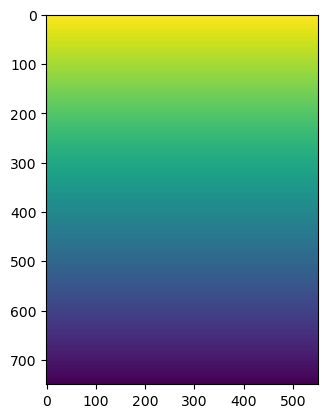

In [14]:
import matplotlib.pyplot as plt

#Visualização de variação da variável
plt.imshow(latlon_raster[1])#Latitude 

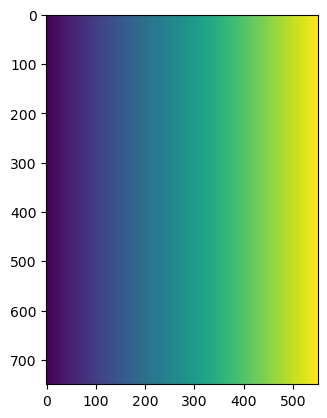

In [15]:
import matplotlib.pyplot as plt

#Visualização de variação da variável
plt.imshow(latlon_raster[0])#longitude


In [16]:
import numpy as np
import pandas as pd

# Remover duplicados
latitudes_unicas = pd.Series(latlon_raster[1].flatten()).drop_duplicates().tolist()
latitudes_unicas = np.round(latitudes_unicas,2)
print("latitude", len(latitudes_unicas))

# Remover duplicados
longitudes_unicas = pd.Series(latlon_raster[0].flatten()).drop_duplicates().tolist()
longitudes_unicas  = np.round(longitudes_unicas ,2)
print("longitude", len(longitudes_unicas))

latitude 750
longitude 551


In [17]:
import gc

del latlon_raster
gc.collect()

20

In [18]:
# Valor alvo
longitude_SP = -46.63
latitude_SP = -23.53
# Encontrar o índice do valor mais próximo
indice_lon_SP = np.abs(longitudes_unicas - longitude_SP).argmin()
indice_lat_SP = np.abs(latitudes_unicas - latitude_SP).argmin()
# Resultado
print(f"O índice do valor mais próximo de {longitude_SP} é {indice_lon_SP}.")
print(f"O índice do valor mais próximo de {latitude_SP} é {indice_lat_SP}.")

O índice do valor mais próximo de -46.63 é 383.
O índice do valor mais próximo de -23.53 é 385.


## Criação de dados de Tempo

### Tempo Tmax

In [19]:
import numpy as np

#Definição da data inicial
data_inicial_tmax=np.datetime64('1985-01', 'M')

#Criação de uma lista com as datas mensais - levando em consideração o número de linha de tempo presentes nos dados
data_Tmax = np.arange(data_inicial_tmax,data_inicial_tmax+mesesTmax, dtype="datetime64[M]")

data_Tmax = np.array(data_Tmax, dtype="datetime64[ns]") 
print("Dados de tempo:",data_Tmax.shape)
data_Tmax[:10]

Dados de tempo: (470,)


array(['1985-01-01T00:00:00.000000000', '1985-02-01T00:00:00.000000000',
       '1985-03-01T00:00:00.000000000', '1985-04-01T00:00:00.000000000',
       '1985-05-01T00:00:00.000000000', '1985-06-01T00:00:00.000000000',
       '1985-07-01T00:00:00.000000000', '1985-08-01T00:00:00.000000000',
       '1985-09-01T00:00:00.000000000', '1985-10-01T00:00:00.000000000'],
      dtype='datetime64[ns]')

In [20]:
import numpy as np

#Definição da data inicial
data_inicial_tmin=np.datetime64('1985-01', 'M')

#Criação de uma lista com as datas mensais - levando em consideração o número de linha de tempo presentes nos dados
data_Tmin = np.arange(data_inicial_tmin,data_inicial_tmin+mesesTmin, dtype="datetime64[M]")

data_Tmin = np.array(data_Tmin, dtype="datetime64[ns]") 
print("Dados de tempo:",data_Tmin.shape)
data_Tmin[:10]

Dados de tempo: (470,)


array(['1985-01-01T00:00:00.000000000', '1985-02-01T00:00:00.000000000',
       '1985-03-01T00:00:00.000000000', '1985-04-01T00:00:00.000000000',
       '1985-05-01T00:00:00.000000000', '1985-06-01T00:00:00.000000000',
       '1985-07-01T00:00:00.000000000', '1985-08-01T00:00:00.000000000',
       '1985-09-01T00:00:00.000000000', '1985-10-01T00:00:00.000000000'],
      dtype='datetime64[ns]')

In [21]:
#Criação de Array com as datas
#laço com os meses 1 - 12 com a adição de um zero antes do número e o corte de apenas dois números deixando números menores do que 10 com um zero antes.
datas = np.array([[ str(ano)+"-"+("0"+str(mes))[-2:] for mes in range(1,13)] for ano in range(1985, 2024)]).flatten()
#exibe shape
print(type(datas))

extra =  ['2024-01','2024-02']
datas = np.append(datas, extra)


# Converter para datetime64[ns]
datas_datetime = np.array(datas, dtype="datetime64[ns]")  # 'M' para precisão mensal

# Exibir shape e preview
print(datas_datetime.shape)
print(datas_datetime[:10])  # Visualizar as primeiras datas


<class 'numpy.ndarray'>
(470,)
['1985-01-01T00:00:00.000000000' '1985-02-01T00:00:00.000000000'
 '1985-03-01T00:00:00.000000000' '1985-04-01T00:00:00.000000000'
 '1985-05-01T00:00:00.000000000' '1985-06-01T00:00:00.000000000'
 '1985-07-01T00:00:00.000000000' '1985-08-01T00:00:00.000000000'
 '1985-09-01T00:00:00.000000000' '1985-10-01T00:00:00.000000000']


# Criação de DataArray

In [22]:
import xarray as xr
# Criação do DataArray
tmax = xr.DataArray(
    data=tmax_raster - 273.15,  # Converte de Kelvin para Celsius
    dims=["time","lat","lon"],  # Dimensões
    coords=dict(
        time=datas_datetime,     # Datas transformadas em nano segundos
        lat=latitudes_unicas,  # Coordenadas de latitude (única)
        lon=longitudes_unicas  # Coordenadas de longitude (única)
    ),
    attrs=dict(
        description="Temperatura máxima mensal em °C",
        units="°C"
    )
)

# Visualização dos dados
display(tmax)


<xarray.DataArray (time: 470, lat: 750, lon: 551)> Size: 2GB
array([[[25.26229346, 24.91815609, 24.92818161, ...,         nan,
                 nan,         nan],
        [24.87181712, 24.77843136, 24.94740079, ...,         nan,
                 nan,         nan],
        [25.25998102, 25.40706787, 25.42082638, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[25.91962422, 25.66729507, 25.76626413, ...,         nan,
                 nan,         nan],
        [25.51535459, 25.52357418, 25.77357254, ...,         nan,
                 nan,         nan],
        [25.93863122, 26.17577569, 26.28590655, ...,         nan,
                 nan,         nan],
...
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[27.99764141, 27.89135868, 28.07477459, ...,         nan,
                 nan,         nan],
        [27.82477564, 27.9035694 , 27.79018397, ...,         nan,
                 nan,         nan],
        [28.49470331, 28.456791  , 28.29270903, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]]])
Coordinates:
  * time     (time) datetime64[ns] 4kB 1985-01-01 1985-02-01 ... 2024-02-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Attributes:
    description:  Temperatura máxima mensal em °C
    units:        °C

In [23]:
import xarray as xr
# Criação do DataArray
tmin = xr.DataArray(
    data=tmin_raster - 273.15,  # Converte de Kelvin para Celsius
    dims=["time","lat","lon"],  # Dimensões
    coords=dict(
        time=datas_datetime,     # Datas transformadas em nano segundos
        lat=latitudes_unicas,  # Coordenadas de latitude (única)
        lon=longitudes_unicas  # Coordenadas de longitude (única)
    ),
    attrs=dict(
        description="Temperatura mínima mensal em °C",
        units="°C"
    )
)

# Visualização dos dados
display(tmin)

<xarray.DataArray (time: 470, lat: 750, lon: 551)> Size: 2GB
array([[[18.12098526, 17.94049496, 18.02748137, ...,         nan,
                 nan,         nan],
        [17.87719412, 17.8349002 , 18.19470835, ...,         nan,
                 nan,         nan],
        [18.093168  , 18.40111793, 18.71117111, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[19.09758257, 18.96579078, 19.14120091, ...,         nan,
                 nan,         nan],
        [18.77380905, 18.88168542, 19.2285444 , ...,         nan,
                 nan,         nan],
        [19.07961916, 19.38955187, 19.70089602, ...,         nan,
                 nan,         nan],
...
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[19.27376341, 19.3272181 , 20.07184911, ...,         nan,
                 nan,         nan],
        [19.13617385, 19.47154573, 19.78894801, ...,         nan,
                 nan,         nan],
        [19.65984497, 19.91322716, 19.78703013, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]]])
Coordinates:
  * time     (time) datetime64[ns] 4kB 1985-01-01 1985-02-01 ... 2024-02-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Attributes:
    description:  Temperatura mínima mensal em °C
    units:        °C

In [24]:
import gc

del tmax_raster, tmin_raster
gc.collect()

0

# Dados de Precipitação

# Definição do Tavg

In [27]:
#Teste de criação de um arquivo vazio para preencher com os valores em lista, avaliando se havia esse problema de alimentação de dados
import xarray as xr
import numpy as np

Tavgi = xr.Dataset()

tmax_temp = tmax/2
#display(tmax_temp)

tmin_temp = tmin/2
#display(tmin_temp)

Tavgi = tmax_temp+tmin_temp
Tavgi

# Adicionando atributos
Tavgi.attrs = {
    'description': 'Média entre as temperaturas máximas e mínimas mensais',
    'units': '°C',  # Unidade dos dados
    'source': 'ERA-5 Land',  # Fonte dos dados
    'year': '1985 - 2023'   # Ano de referência dos dados
}

# Calcular o desvio padrão anual para cada ponto geográfico (lat, lon)
# Primeiro, agrupe pelos anos
Tavgi['year'] = Tavgi['time'].dt.year
display(Tavgi)
Tavgi.to_netcdf("Tavgi_1985-2023.nc")

<xarray.DataArray (time: 470, lat: 750, lon: 551)> Size: 2GB
array([[[21.69163936, 21.42932552, 21.47783149, ...,         nan,
                 nan,         nan],
        [21.37450562, 21.30666578, 21.57105457, ...,         nan,
                 nan,         nan],
        [21.67657451, 21.9040929 , 22.06599874, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[22.5086034 , 22.31654293, 22.45373252, ...,         nan,
                 nan,         nan],
        [22.14458182, 22.2026298 , 22.50105847, ...,         nan,
                 nan,         nan],
        [22.50912519, 22.78266378, 22.99340128, ...,         nan,
                 nan,         nan],
...
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[23.63570241, 23.60928839, 24.07331185, ...,         nan,
                 nan,         nan],
        [23.48047475, 23.68755756, 23.78956599, ...,         nan,
                 nan,         nan],
        [24.07727414, 24.18500908, 24.03986958, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]]])
Coordinates:
  * time     (time) datetime64[ns] 4kB 1985-01-01 1985-02-01 ... 2024-02-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 4kB 1985 1985 1985 1985 1985 ... 2023 2023 2024 2024
Attributes:
    description:  Média entre as temperaturas máximas e mínimas mensais
    units:        °C
    source:       ERA-5 Land
    year:         1985 - 2023

# BIO 01
BIO1 = Annual Mean Temperature


![Equação_BIO_01](Equações/Equacao_BIO01.png)

In [79]:
import xarray as xr
import numpy as np
import pandas as pd

BIO01 = xr.Dataset()

for ano in range(Tavgi['time'].dt.year.min().values,Tavgi['time'].dt.year.max().values):
    
    # Somar ao longo da dimensão 'time', ignorando NaN, e depois dividir por 12
    BIO01[f'BIO 01 {ano}'] = Tavgi.where(Tavgi['time'].dt.year == ano, drop=True).mean(dim='time')

# Adicionando atributos
BIO01.attrs = {
    'title':'BIO 01 - Temperatura Média Anual',
    'description':'Temperatura média do Ar próximo a superfície (2m)',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'Cálculado a partir da média entre a temperatura máxima (Tmáx) e mínima (Tmin) entre os doze meses do ano. Sendo os valores de Tmax e Tmin determinados pela média mensal da temperatura máxima e mínima diarias, respectivamente ',
    'uncertainty': 'Erro Médio de 0,75°C, sendo a erro máximo de ± 3,41°C. Cabe destacar que a maior parte do país tem correspondencia (Coef. de Pearson) maior do que 95%, cabendo destacar o Estado do Tocantins a parte Sudeste do estado do Amazonas, que corresponde a uma zona de transição de Bioma e Clima, tem corespondência de 79%, por não conseguir corresponder o comportamento da temperatura entre Julho e Setembro',
    'comments': 'Erro Determinado da climatologia entre os anos de 1981 e 2010, comparada a climatologia de 310 estações meteriológias automáticas - INMET, com dados estatísticos MBE (Mean Bias Correction), RMSE (Erro quadrático médio) e Coeficiente de Pearson',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO01)
BIO01.to_netcdf("Variaveis_BIOClimaticas/BIO_01_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:      (lat: 750, lon: 551)
Coordinates:
  * lat          (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon          (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO 01 1985  (lat, lon) float64 3MB 24.16 23.95 24.07 24.31 ... nan nan nan
    BIO 01 1986  (lat, lon) float64 3MB 24.13 23.95 24.07 24.33 ... nan nan nan
    BIO 01 1987  (lat, lon) float64 3MB 24.92 24.77 24.88 25.17 ... nan nan nan
    BIO 01 1988  (lat, lon) float64 3MB 24.74 24.58 24.68 24.93 ... nan nan nan
    BIO 01 1989  (lat, lon) float64 3MB 24.29 24.07 24.19 24.46 ... nan nan nan
    BIO 01 1990  (lat, lon) float64 3MB 24.47 24.29 24.41 24.66 ... nan nan nan
    ...           ...
    BIO 01 2018  (lat, lon) float64 3MB 24.65 24.46 24.57 24.85 ... nan nan nan
    BIO 01 2019  (lat, lon) float64 3MB 25.22 24.98 25.07 25.35 ... nan nan nan
    BIO 01 2020  (lat, lon) float64 3MB 25.37 25.19 25.27 25.53 ... nan nan nan
    BIO 01 2021  (lat, lon) float64 3MB 24.91 24.69 24.78 25.03 ... nan nan nan
    BIO 01 2022  (lat, lon) float64 3MB 24.61 24.39 24.5 24.8 ... nan nan nan
    BIO 01 2023  (lat, lon) float64 3MB 25.6 25.39 25.5 25.79 ... nan nan nan
Attributes: (12/15)
    title:                BIO 01 - Temperatura Média Anual
    description:          Temperatura média do Ar próximo a superfície (2m)
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    temporal_resolution:  Anual
    methodology:          Cálculado a partir da média entre a temperatura máx...
    uncertainty:          Erro Médio de 0,75°C, sendo a erro máximo de ± 3,41...
    comments:             Erro Determinado da climatologia entre os anos de 1...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

In [29]:
teste = BIO01['BIO 01 1985']-BIO01['BIO 01 2023']
teste

<xarray.DataArray (lat: 750, lon: 551)> Size: 3MB
array([[-1.44582481, -1.44206556, -1.42945522, ...,         nan,
                nan,         nan],
       [-1.35052413, -1.42419759, -1.43506379, ...,         nan,
                nan,         nan],
       [-1.30589883, -1.4167789 , -1.42636679, ...,         nan,
                nan,         nan],
       ...,
       [        nan,         nan,         nan, ...,         nan,
                nan,         nan],
       [        nan,         nan,         nan, ...,         nan,
                nan,         nan],
       [        nan,         nan,         nan, ...,         nan,
                nan,         nan]])
Coordinates:
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95

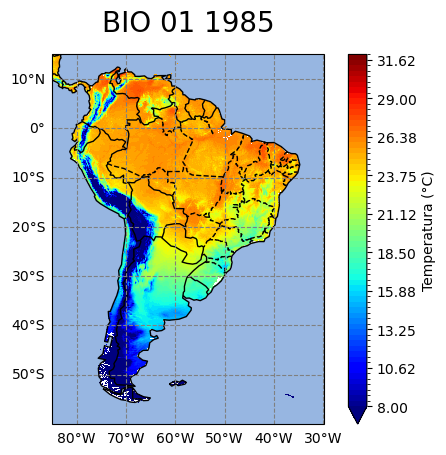

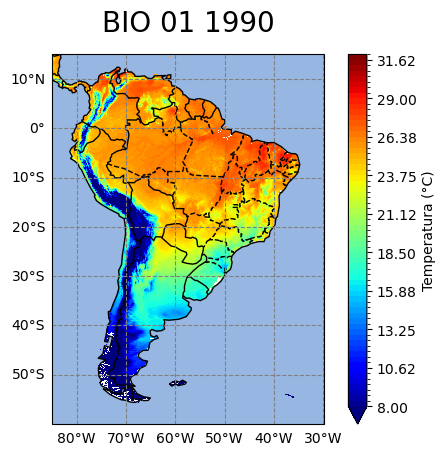

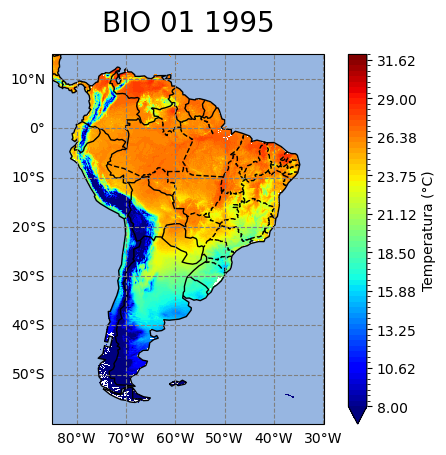

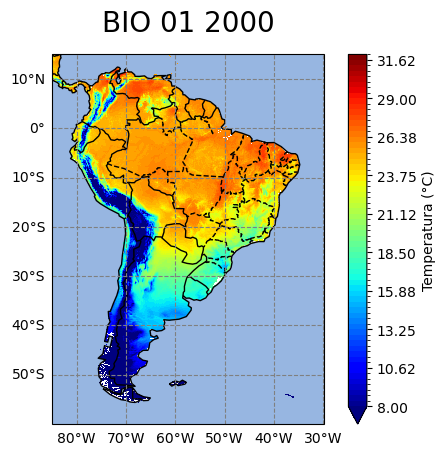

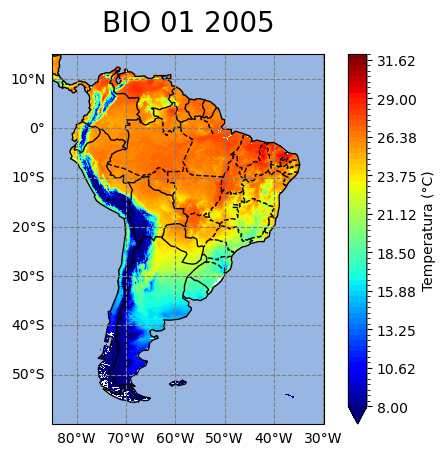

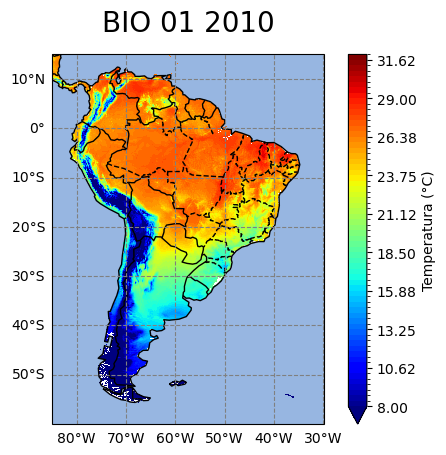

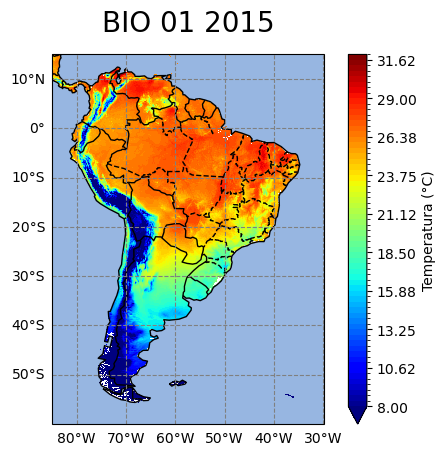

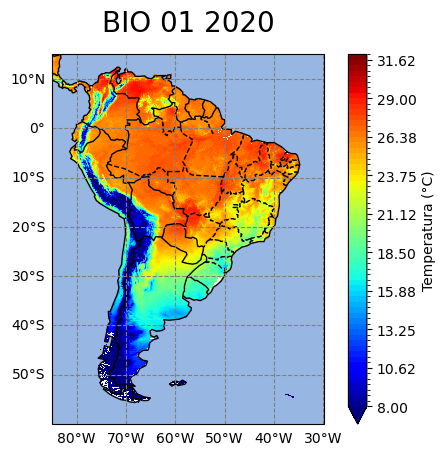

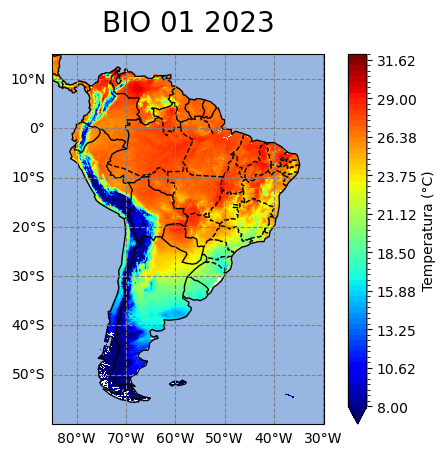

In [30]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 01 {ano}'               
    Base= BIO01[valor]
    max = 32
    min = 8
    FazMapa(Base,valor,max,min)

## Gráfico de Cidades

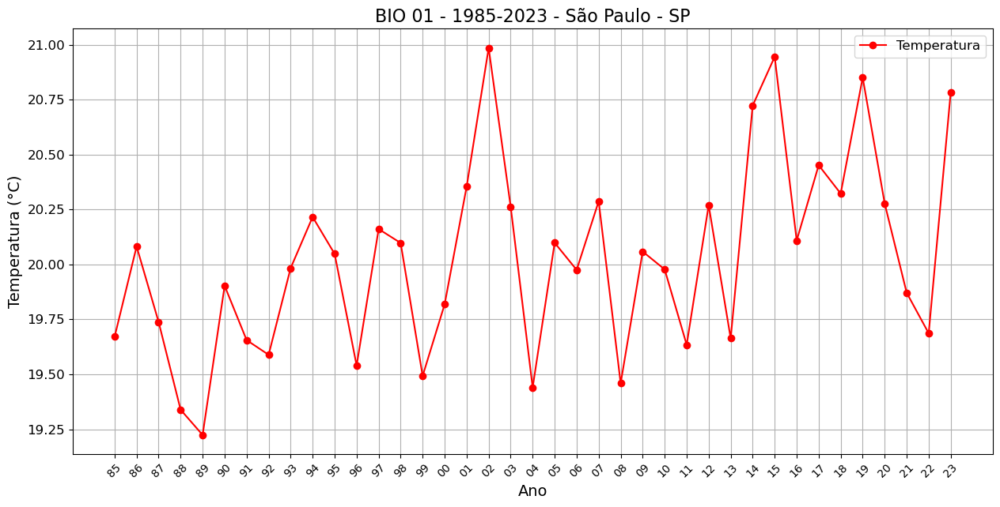

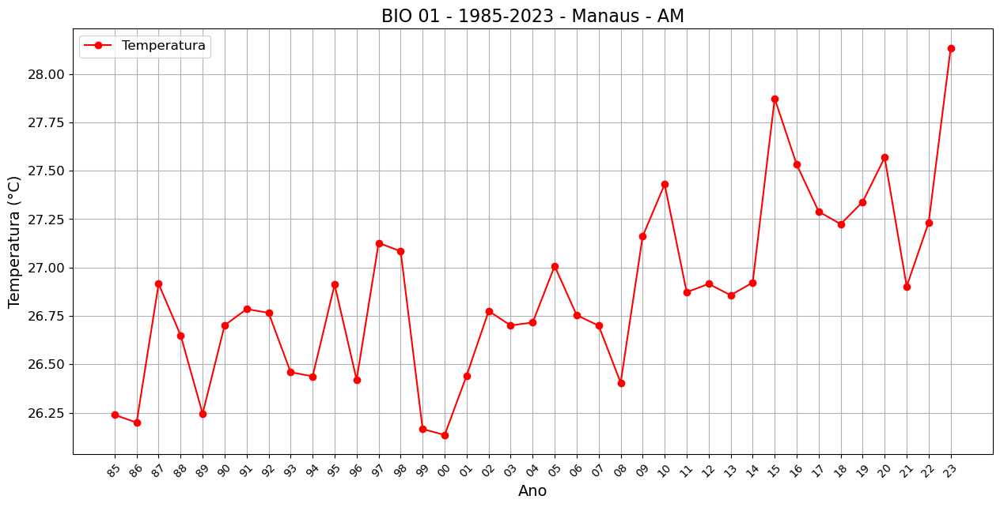

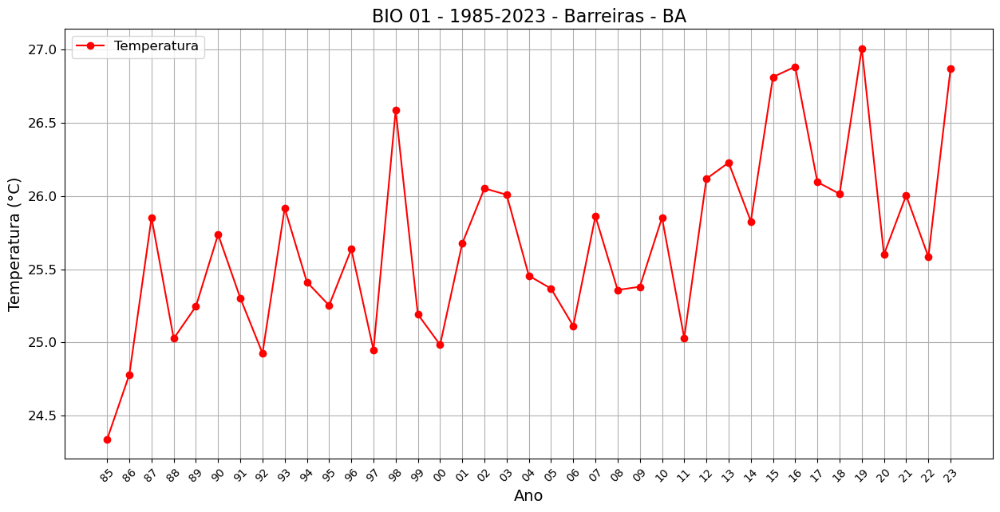

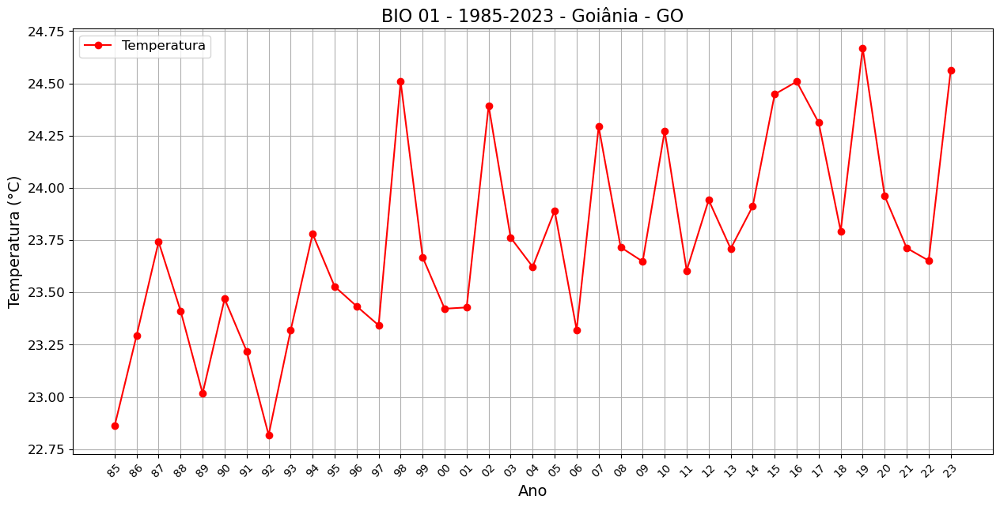

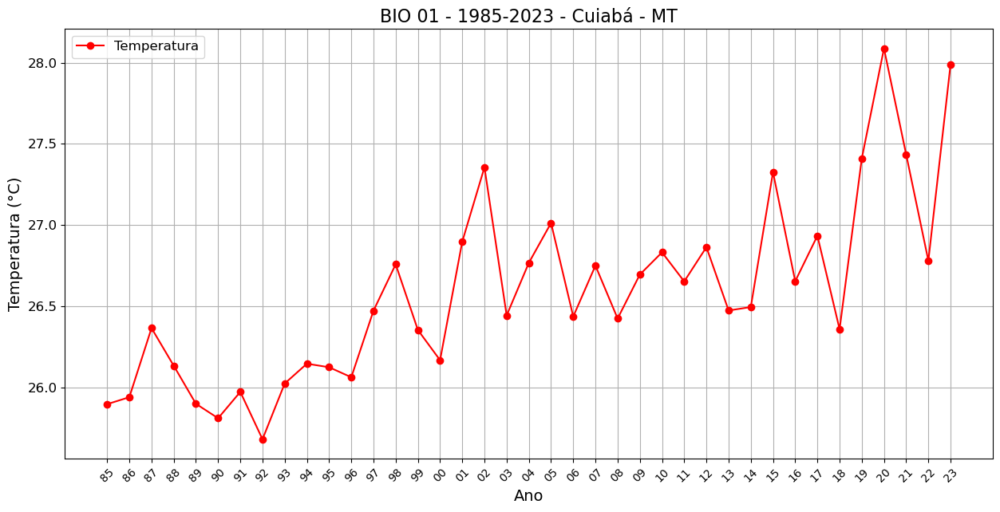

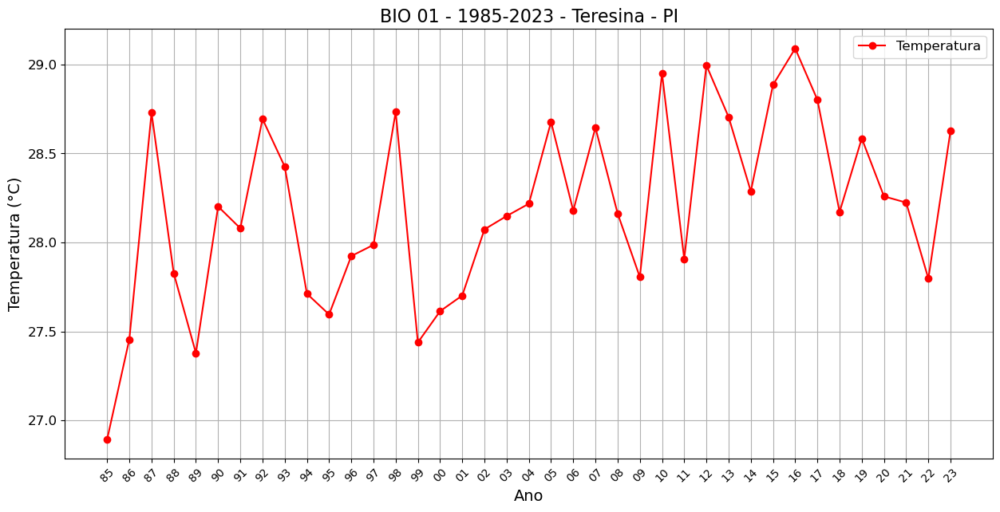

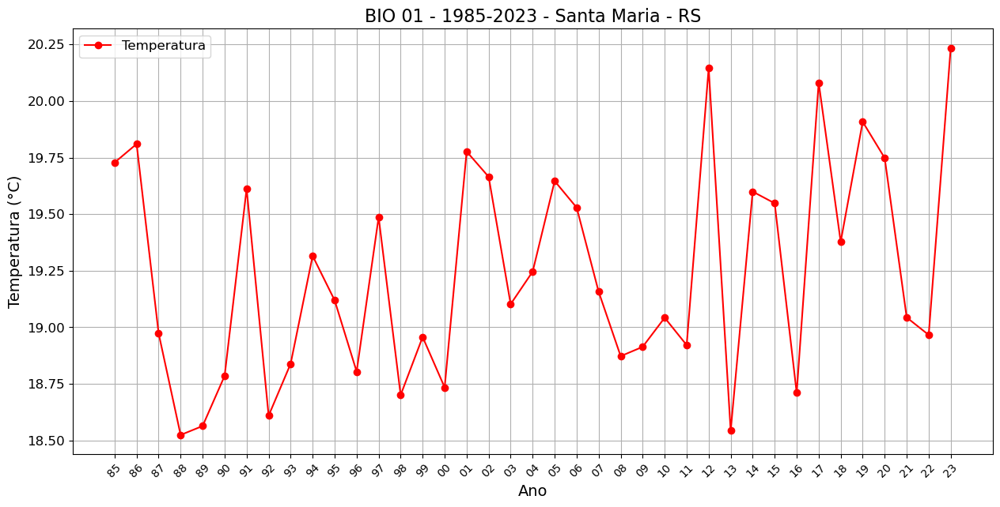

In [31]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO01
    Nome = 'BIO 01'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)


In [32]:
import gc

del BIO01
gc.collect()

44573

# BIO 02

BIO2 = Faixa de Diurna Média (Média Mensal (max temp - min temp)

![Equação_BIO_02](Equações/Equacao_BIO02.png)

In [33]:
import xarray as xr
import numpy as np
import pandas as pd

temp = tmax-tmin

BIO02 = xr.Dataset()

for ano in range(tmax['time'].dt.year.min().values,tmax['time'].dt.year.max().values+1):
    
    # Somar ao longo da dimensão 'time', ignorando NaN, e depois dividir por 12
    BIO02[f'BIO 02 {ano}'] = temp.where(temp['time'].dt.year == ano, drop=True).mean(dim='time')

# Adicionando atributos
BIO02.attrs = {
    'title':'BIO 02 - Intervalo Diurno médio',
    'description':'Este índice pode ajudar a fornecer informações relativo à relevância da flutuação de temperatura para diferentes espécies.',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'Cálculado a partir da média da diferença entre a temperatura máxima (Tmáx) e mínima (Tmin) entre os doze meses do ano. Sendo os valores de Tmax e Tmin determinados pela média mensal da temperatura máxima e mínima diarias, respectivamente',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO02)
BIO02.to_netcdf("Variaveis_BIOClimaticas/BIO_02_1985-2023.nc")

<xarray.Dataset> Size: 132MB
Dimensions:      (lat: 750, lon: 551)
Coordinates:
  * lat          (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon          (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/40)
    BIO 02 1985  (lat, lon) float64 3MB 7.204 7.083 7.009 6.884 ... nan nan nan
    BIO 02 1986  (lat, lon) float64 3MB 7.18 7.06 6.954 6.803 ... nan nan nan
    BIO 02 1987  (lat, lon) float64 3MB 7.966 7.796 7.623 7.305 ... nan nan nan
    BIO 02 1988  (lat, lon) float64 3MB 7.372 7.223 7.083 6.873 ... nan nan nan
    BIO 02 1989  (lat, lon) float64 3MB 7.25 7.127 7.002 6.869 ... nan nan nan
    BIO 02 1990  (lat, lon) float64 3MB 6.839 6.767 6.674 6.558 ... nan nan nan
    ...           ...
    BIO 02 2019  (lat, lon) float64 3MB 7.64 7.46 7.348 7.143 ... nan nan nan
    BIO 02 2020  (lat, lon) float64 3MB 7.553 7.412 7.251 7.054 ... nan nan nan
    BIO 02 2021  (lat, lon) float64 3MB 7.351 7.187 7.02 6.838 ... nan nan nan
    BIO 02 2022  (lat, lon) float64 3MB 7.329 7.194 7.063 6.827 ... nan nan nan
    BIO 02 2023  (lat, lon) float64 3MB 7.664 7.565 7.503 7.305 ... nan nan nan
    BIO 02 2024  (lat, lon) float64 3MB 7.551 7.43 7.075 6.839 ... nan nan nan
Attributes: (12/13)
    title:                BIO 02 - Intervalo Diurno médio
    description:          Este índice pode ajudar a fornecer informações rela...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    methodology:          Cálculado a partir da média da diferença entre a te...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

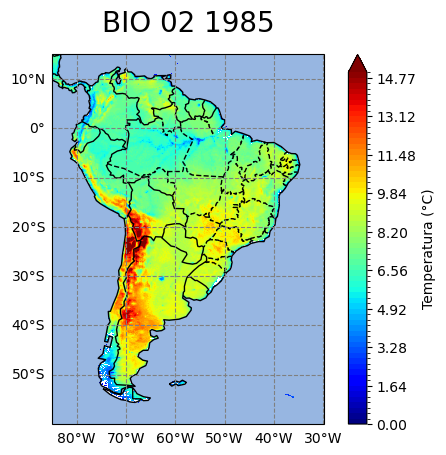

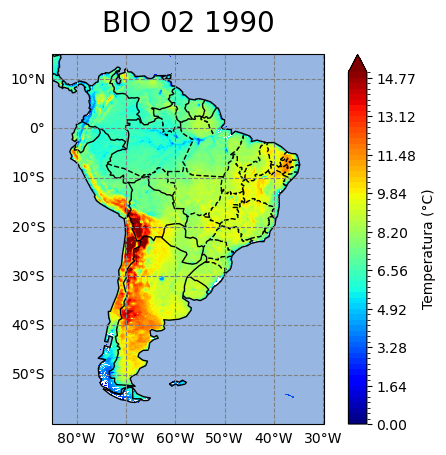

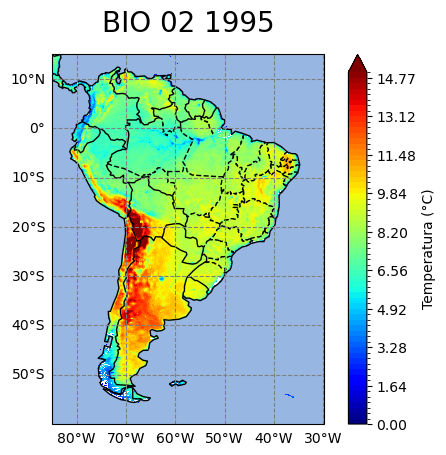

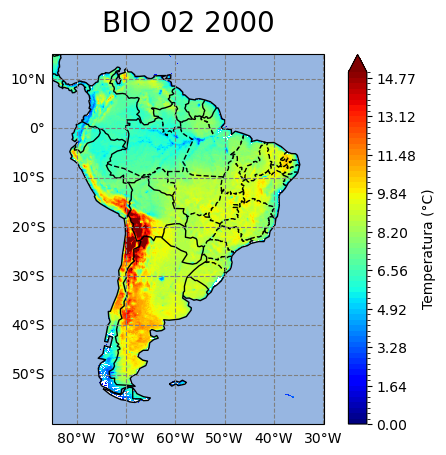

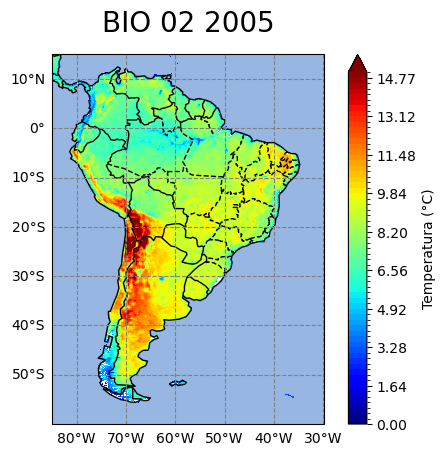

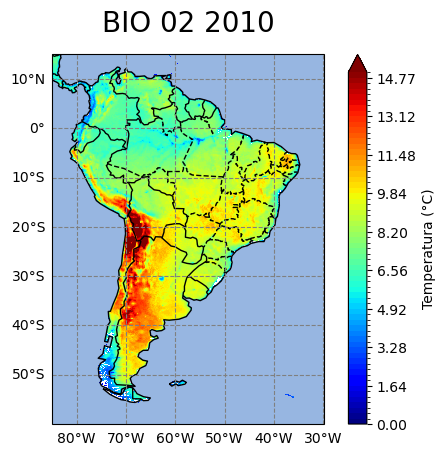

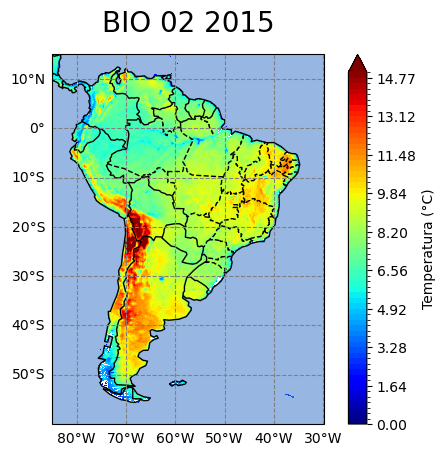

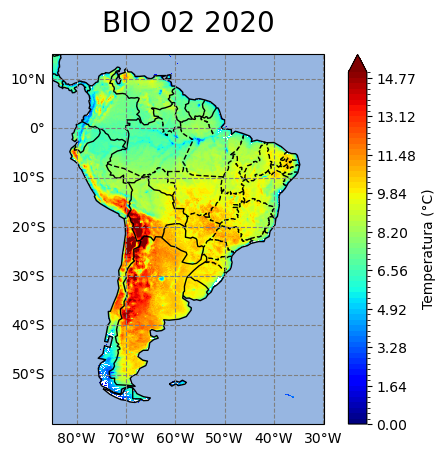

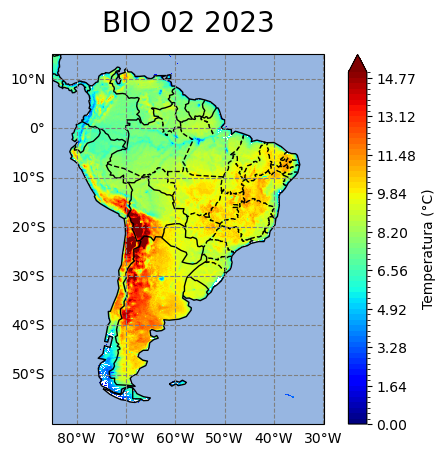

In [34]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 02 {ano}'               
    Base= BIO02[valor]
    max = 15
    min = 0
    FazMapa(Base,valor,max,min)

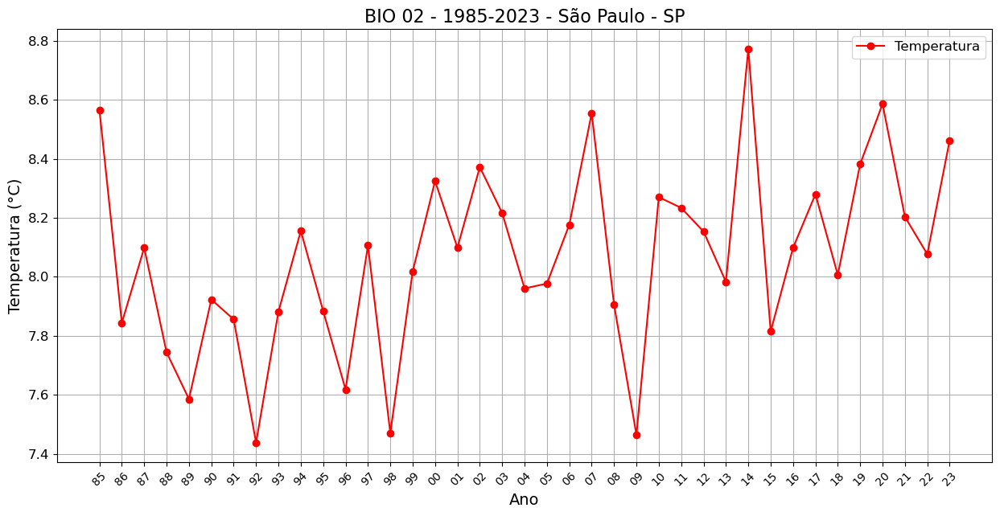

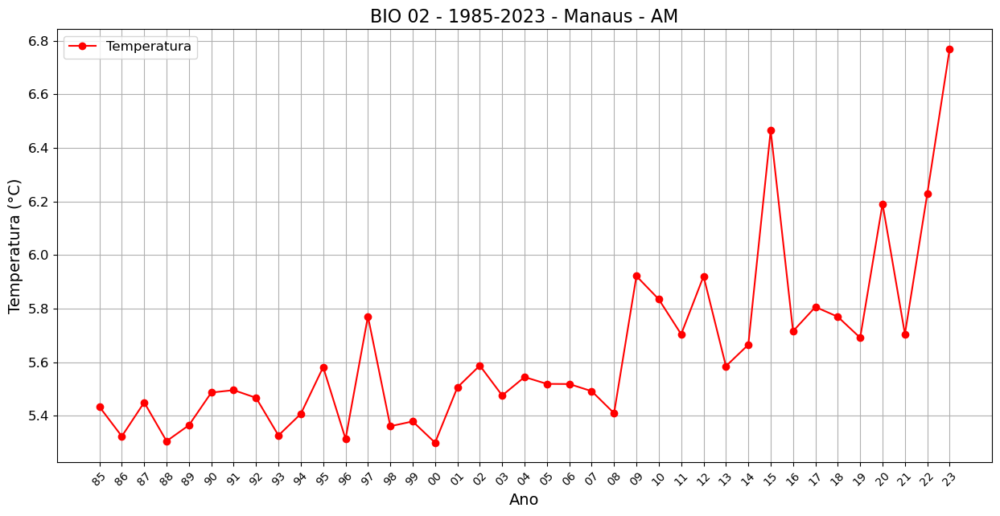

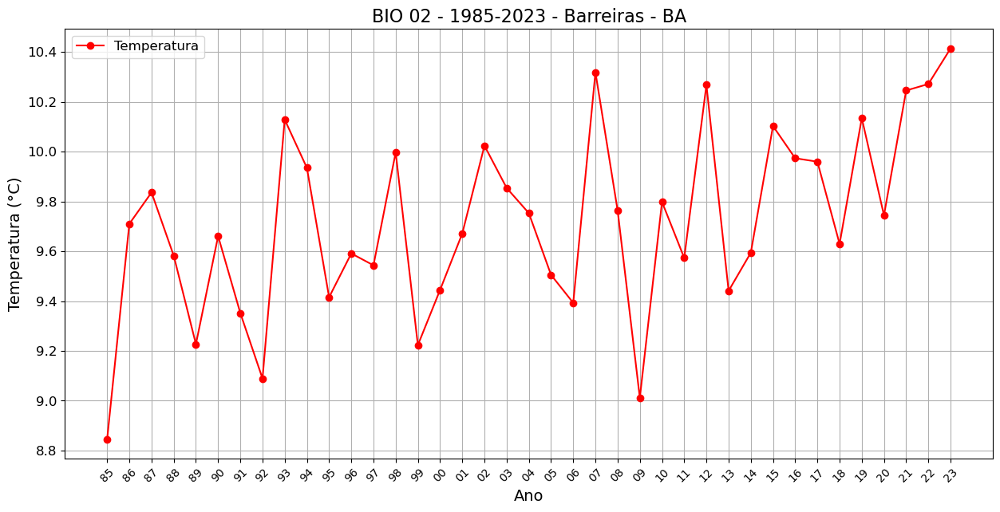

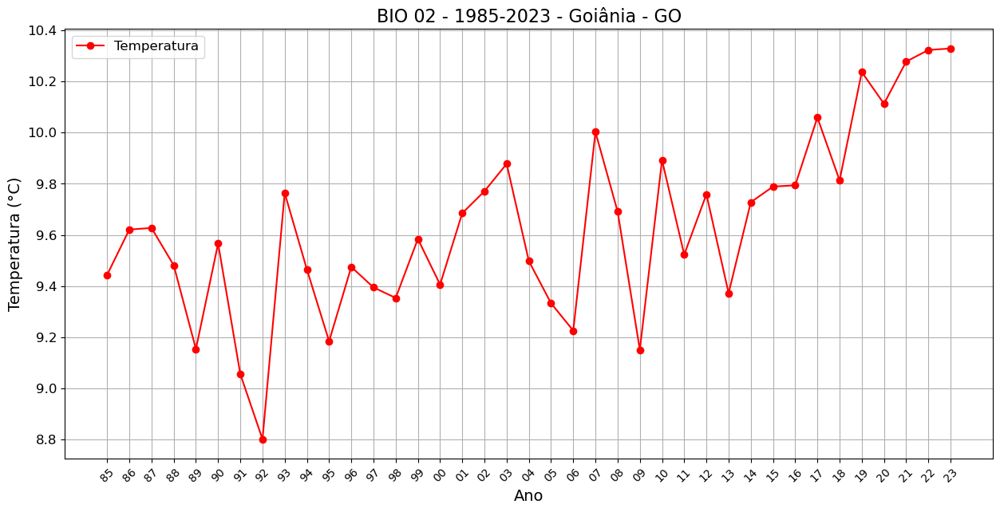

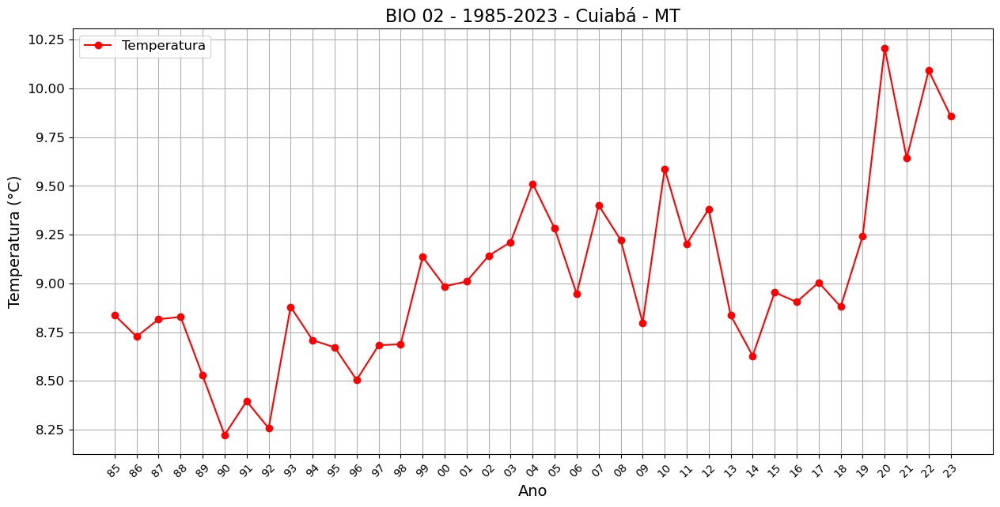

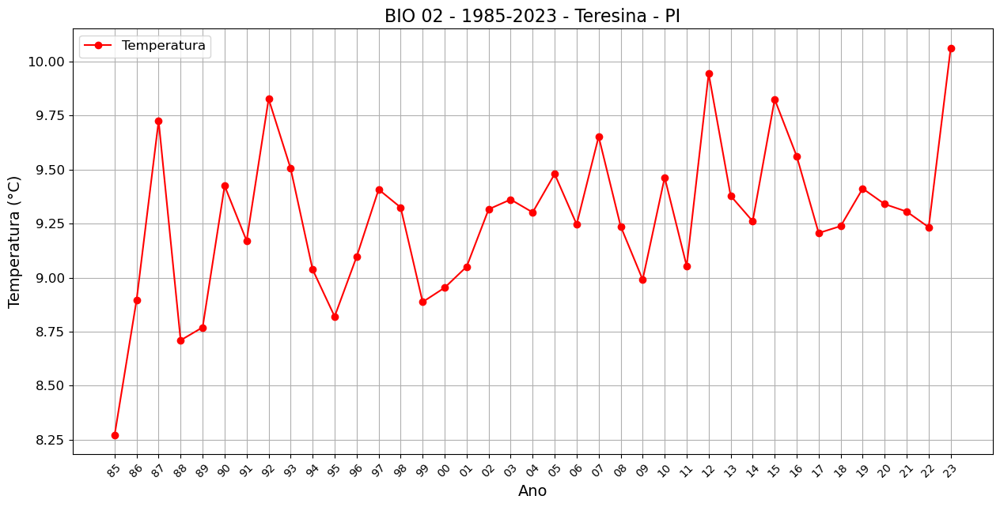

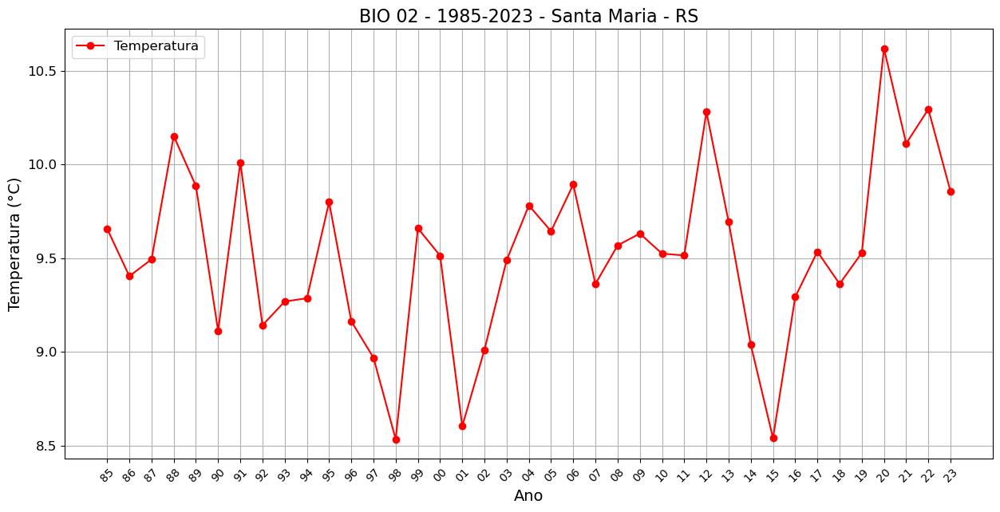

In [35]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO02
    Nome = 'BIO 02'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# BIO 04 

BIO4 = Sazonalidade de Temperatura (standard deviation×100)

## Equação
![Equação_BIO_04](Equações/Equacao_BIO04.png)

In [36]:
import xarray as xr
import numpy as np
import pandas as pd

temp = tmax-tmin

BIO04 = xr.Dataset()

for ano in range(tmax['time'].dt.year.min().values,tmax['time'].dt.year.max().values):
    
    # Somar ao longo da dimensão 'time', ignorando NaN, e depois dividir por 12
    
    BIO04[f'BIO 04 {ano}'] = 100*Tavgi.where(Tavgi['time'].dt.year == ano, drop=True).std(dim='time')

# Adicionando atributos
BIO04.attrs = {
    'title':'BIO 04 - Sazonalidade da Temperatura (Desvio Padrão)',
    'description':'Sazonalidade da Temperatura é uma medida da variação da temperatura ao longo do ano (Modelo AML®, desenvolvido por Robert Hijmans).',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'Cálculado a partir do desvio padrão entre as médias entre a temperatura máxima (Tmáx) e mínima (Tmin) mensais para cada ano. Sendo os valores de Tmax e Tmin determinados pela média mensal da temperatura máxima e mínima diarias, respectivamente',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO04)
BIO04.to_netcdf("Variaveis_BIOClimaticas/BIO_04_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:      (lat: 750, lon: 551)
Coordinates:
  * lat          (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon          (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO 04 1985  (lat, lon) float64 3MB 126.1 125.7 124.8 122.8 ... nan nan nan
    BIO 04 1986  (lat, lon) float64 3MB 117.9 117.3 114.4 108.6 ... nan nan nan
    BIO 04 1987  (lat, lon) float64 3MB 119.7 120.5 119.2 114.1 ... nan nan nan
    BIO 04 1988  (lat, lon) float64 3MB 131.4 132.6 130.2 128.9 ... nan nan nan
    BIO 04 1989  (lat, lon) float64 3MB 126.8 125.2 123.2 121.1 ... nan nan nan
    BIO 04 1990  (lat, lon) float64 3MB 98.28 98.21 97.5 97.93 ... nan nan nan
    ...           ...
    BIO 04 2018  (lat, lon) float64 3MB 105.7 105.8 104.2 104.2 ... nan nan nan
    BIO 04 2019  (lat, lon) float64 3MB 117.0 117.4 116.8 115.2 ... nan nan nan
    BIO 04 2020  (lat, lon) float64 3MB 133.7 135.6 132.3 132.3 ... nan nan nan
    BIO 04 2021  (lat, lon) float64 3MB 106.4 107.4 105.3 101.9 ... nan nan nan
    BIO 04 2022  (lat, lon) float64 3MB 97.79 102.7 102.9 100.1 ... nan nan nan
    BIO 04 2023  (lat, lon) float64 3MB 150.1 150.9 150.0 146.5 ... nan nan nan
Attributes: (12/13)
    title:                BIO 04 - Sazonalidade da Temperatura (Desvio Padrão)
    description:          Sazonalidade da Temperatura é uma medida da variaçã...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    methodology:          Cálculado a partir do desvio padrão entre as médias...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

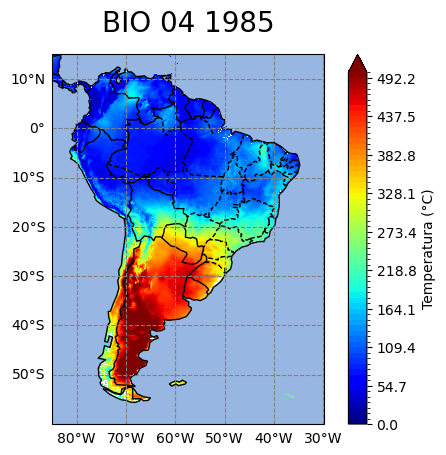

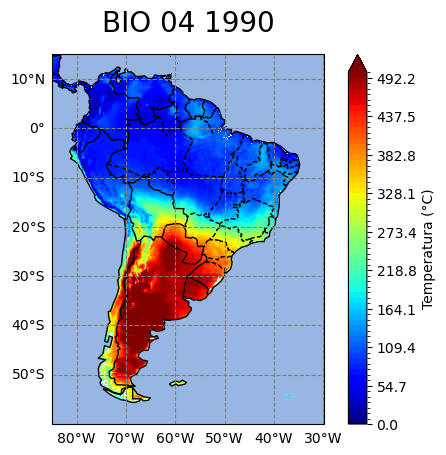

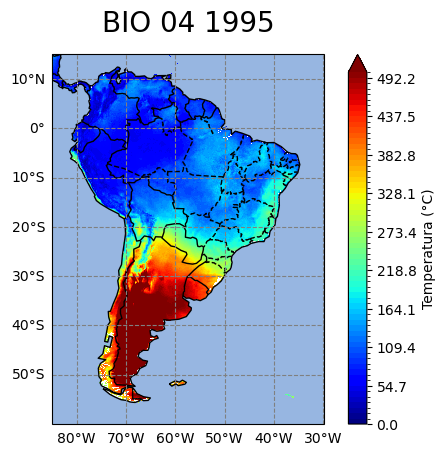

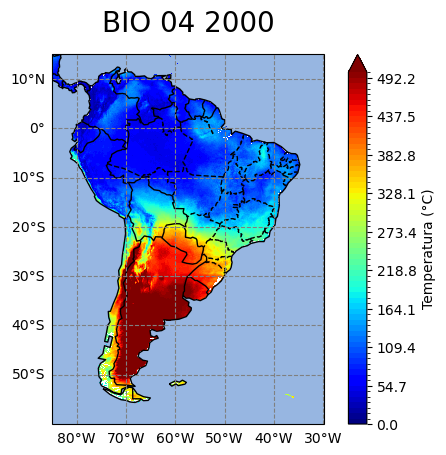

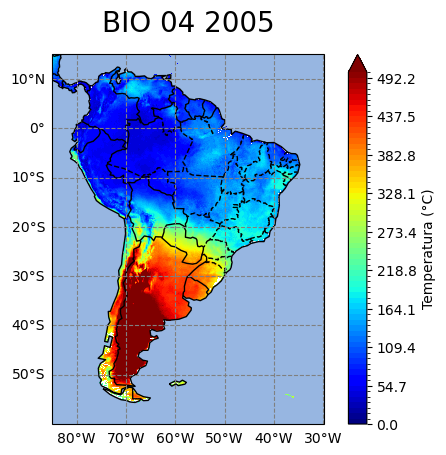

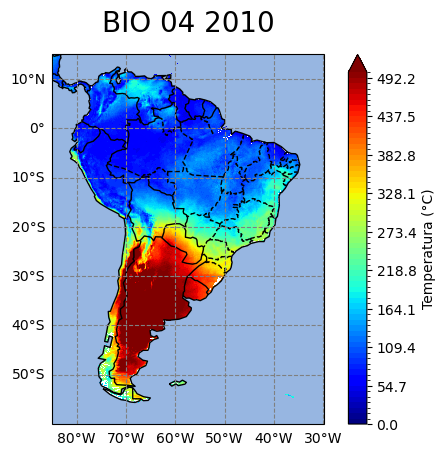

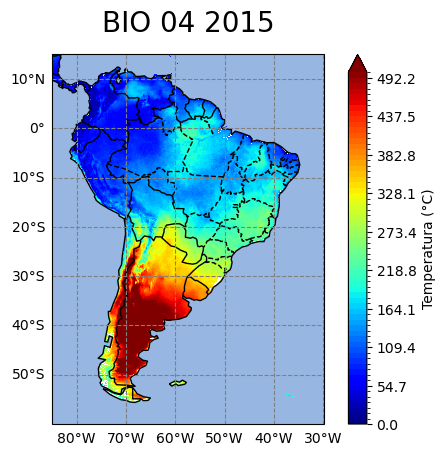

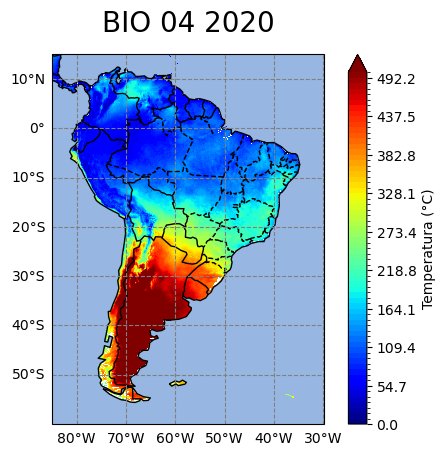

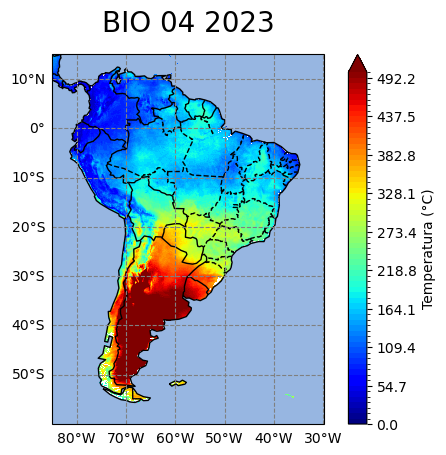

In [37]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 04 {ano}'               
    Base= BIO04[valor]
    max = 500
    min = 0
    FazMapa(Base,valor,max,min)

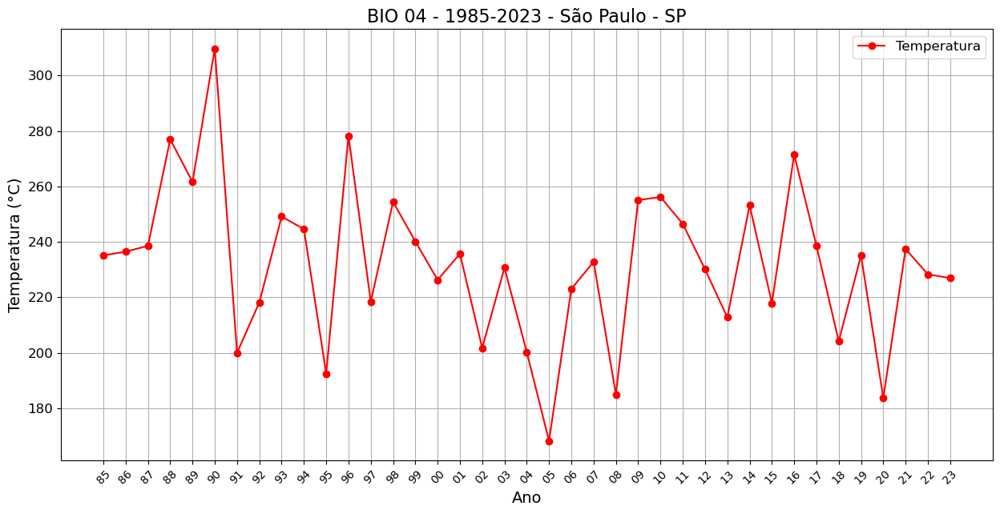

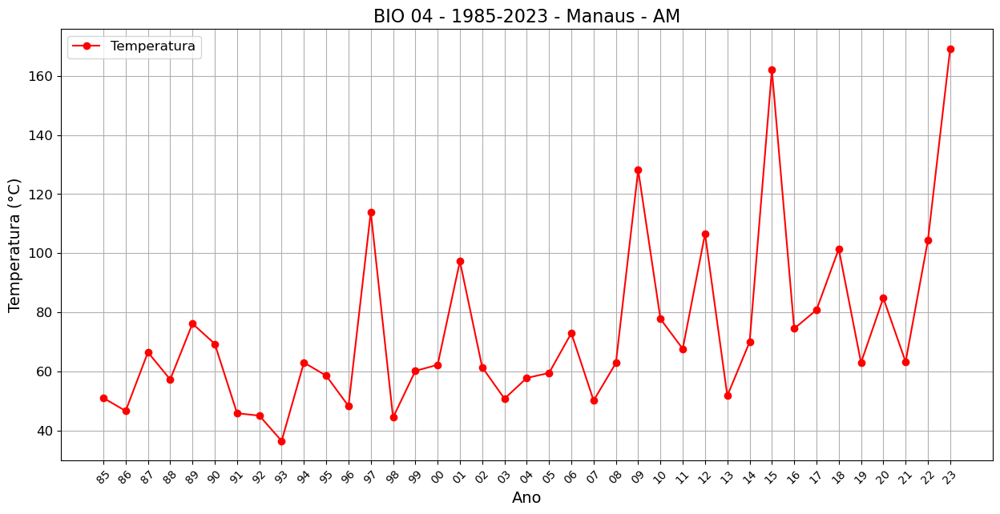

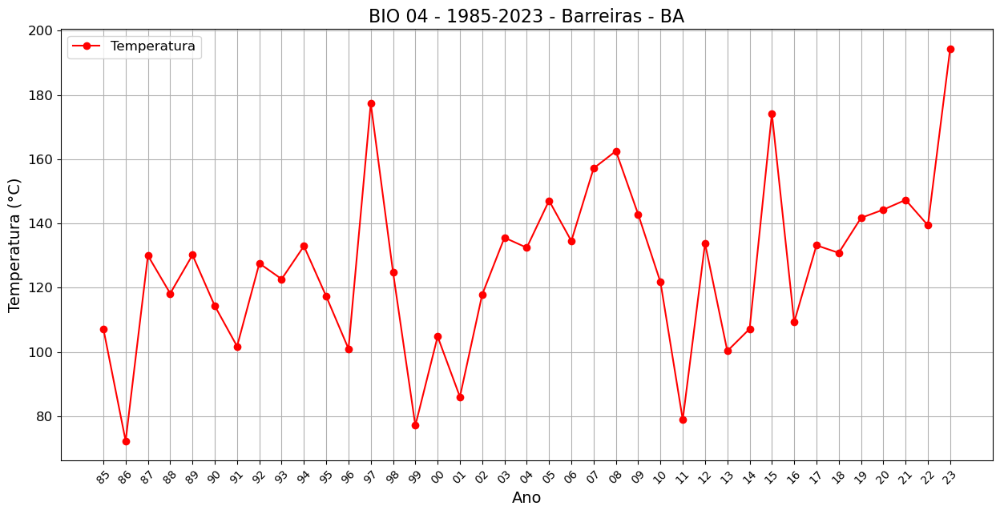

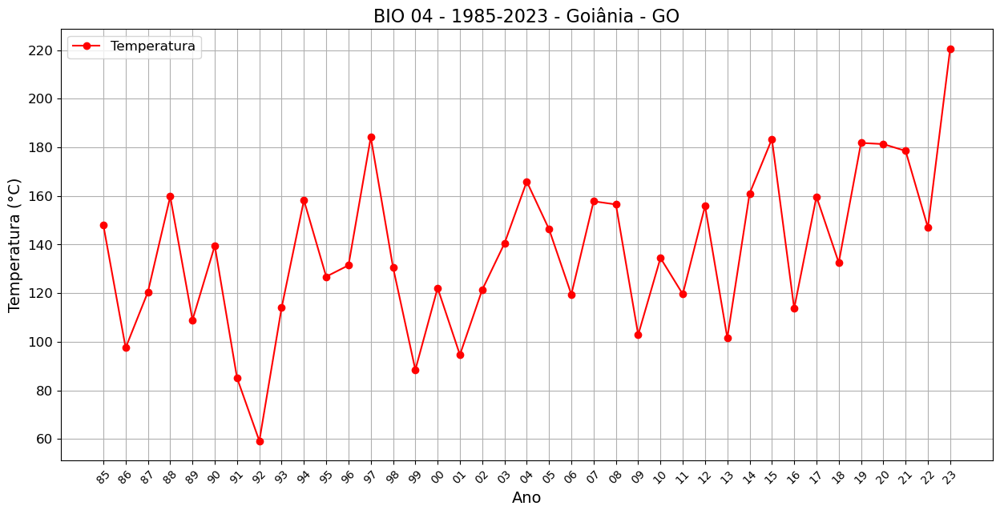

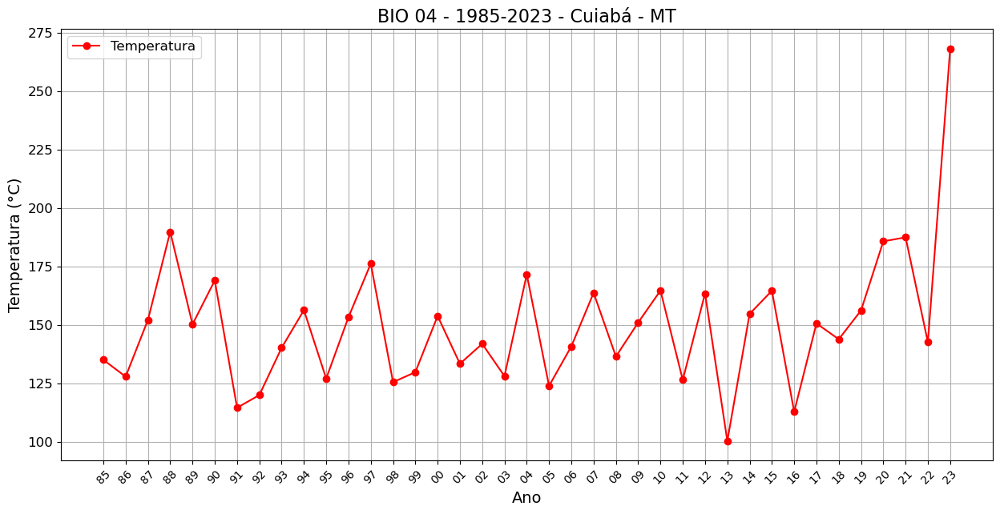

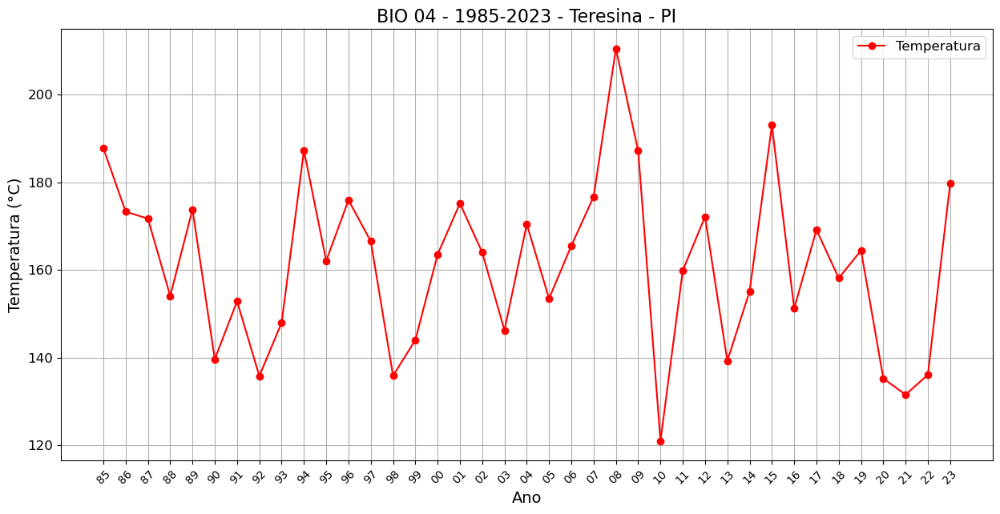

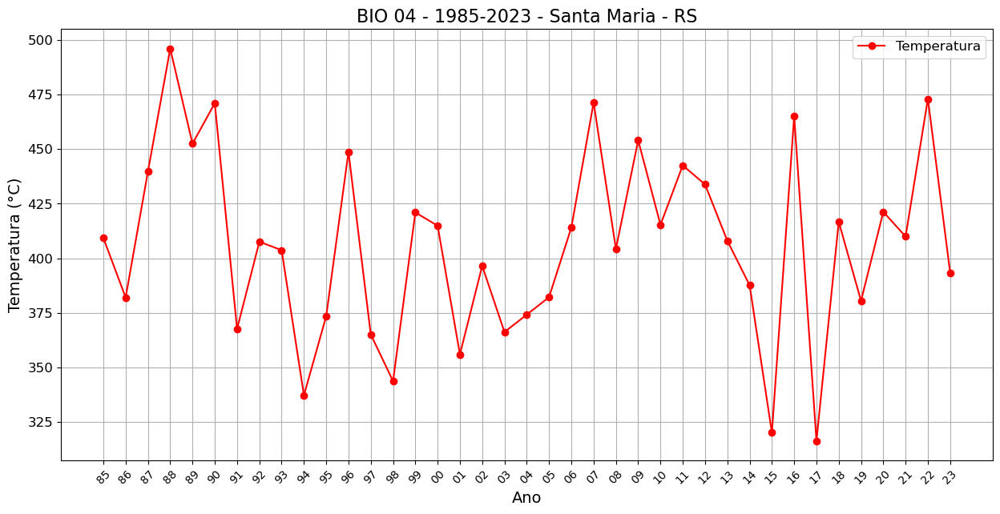

In [38]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO04
    Nome = 'BIO 04'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# BIO 05
BIO5 = Max Temperature of Warmet Month

## Equação
![Equação_BIO_05](Equações/Equacao_BIO05.png)

In [39]:
import xarray as xr
import numpy as np
import pandas as pd

BIO05 = xr.Dataset()

for ano in range(tmax['time'].dt.year.min().values,tmax['time'].dt.year.max().values):
    
    # Somar ao longo da dimensão 'time', ignorando NaN, e depois dividir por 12
    
    BIO05[f'BIO 05 {ano}'] = tmax.where(tmax['time'].dt.year == ano, drop=True).max(dim='time')

# Adicionando atributos
BIO05.attrs = {
    'title':'BIO 05 - Temperatura máxima mês mais quente ',
    'description':'Esta informação é útil para saber se as distribuições das espécies são afetadas pelo calor e anomalias de temperatura ao longo do ano.',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'Cálculado temperatura máxima média do mês mais quente para cada ano. Sendo os valores de Tmax é determinado pela média mensal da temperatura máxima',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO05)
BIO05.to_netcdf("Variaveis_BIOClimaticas/BIO_05_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:      (lat: 750, lon: 551)
Coordinates:
  * lat          (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon          (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO 05 1985  (lat, lon) float64 3MB 30.47 30.06 30.01 30.11 ... nan nan nan
    BIO 05 1986  (lat, lon) float64 3MB 30.38 30.05 29.97 29.95 ... nan nan nan
    BIO 05 1987  (lat, lon) float64 3MB 31.56 31.3 31.3 31.25 ... nan nan nan
    BIO 05 1988  (lat, lon) float64 3MB 31.83 31.6 31.65 31.7 ... nan nan nan
    BIO 05 1989  (lat, lon) float64 3MB 29.72 29.44 29.53 29.65 ... nan nan nan
    BIO 05 1990  (lat, lon) float64 3MB 29.8 29.41 29.38 29.46 ... nan nan nan
    ...           ...
    BIO 05 2018  (lat, lon) float64 3MB 30.25 29.89 29.83 29.93 ... nan nan nan
    BIO 05 2019  (lat, lon) float64 3MB 31.29 30.81 30.68 30.84 ... nan nan nan
    BIO 05 2020  (lat, lon) float64 3MB 33.51 33.19 33.13 33.41 ... nan nan nan
    BIO 05 2021  (lat, lon) float64 3MB 30.78 30.5 30.52 30.6 ... nan nan nan
    BIO 05 2022  (lat, lon) float64 3MB 30.23 29.77 29.69 29.72 ... nan nan nan
    BIO 05 2023  (lat, lon) float64 3MB 32.79 32.48 32.56 32.49 ... nan nan nan
Attributes: (12/13)
    title:                BIO 05 - Temperatura máxima mês mais quente 
    description:          Esta informação é útil para saber se as distribuiçõ...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    methodology:          Cálculado temperatura máxima média do mês mais quen...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

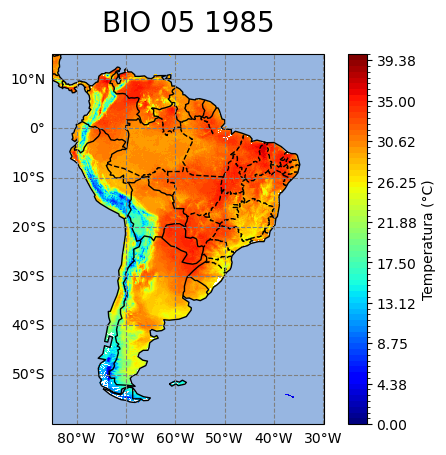

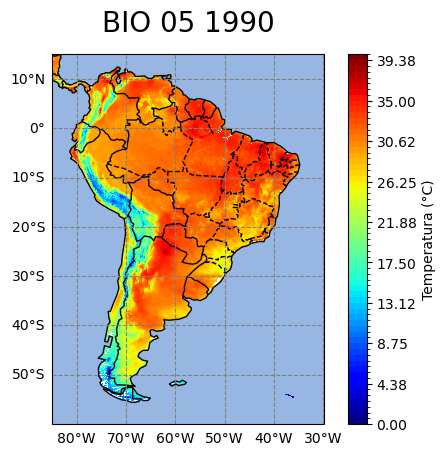

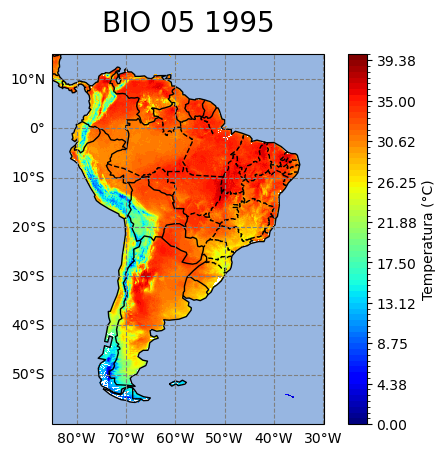

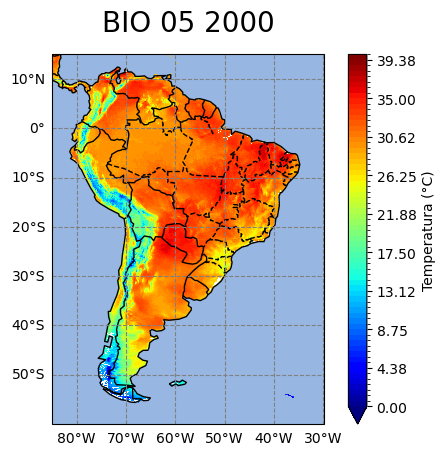

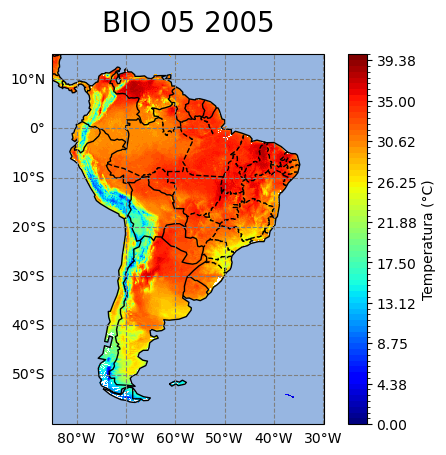

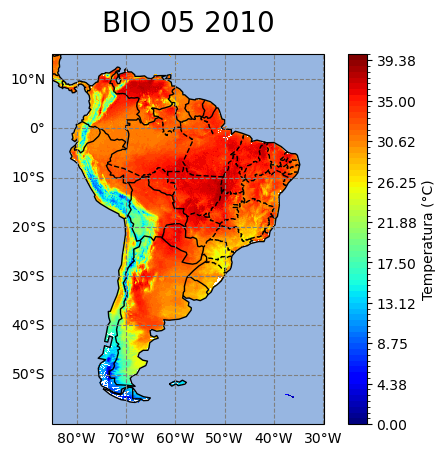

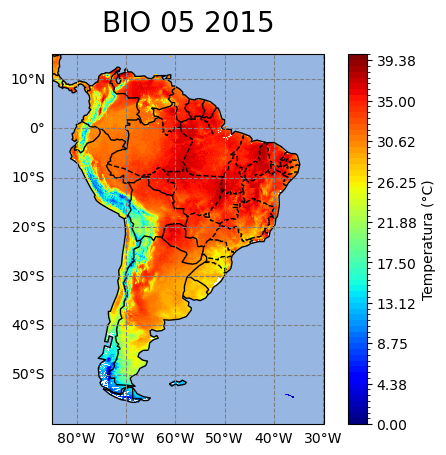

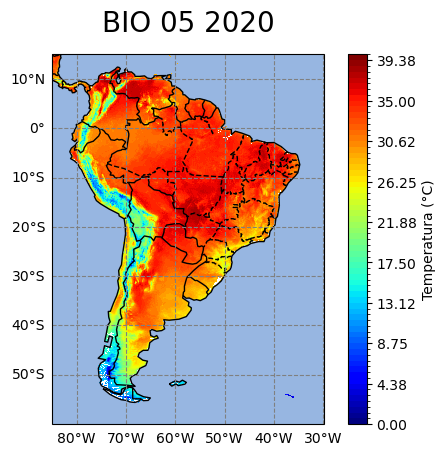

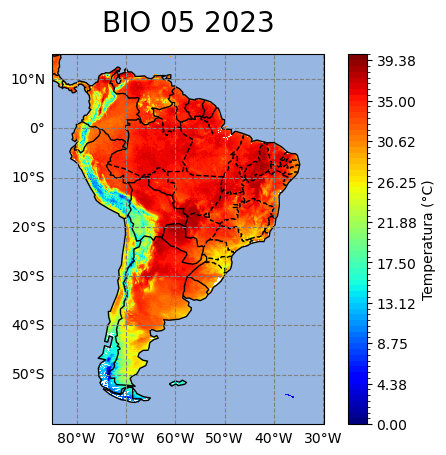

In [40]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 05 {ano}'               
    Base= BIO05[valor]
    max = 40
    min = 0
    FazMapa(Base,valor,max,min)

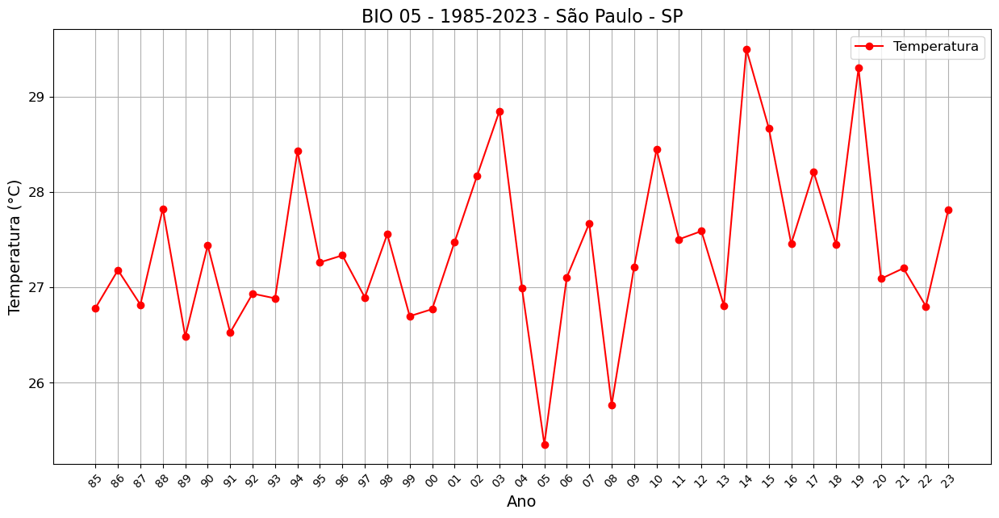

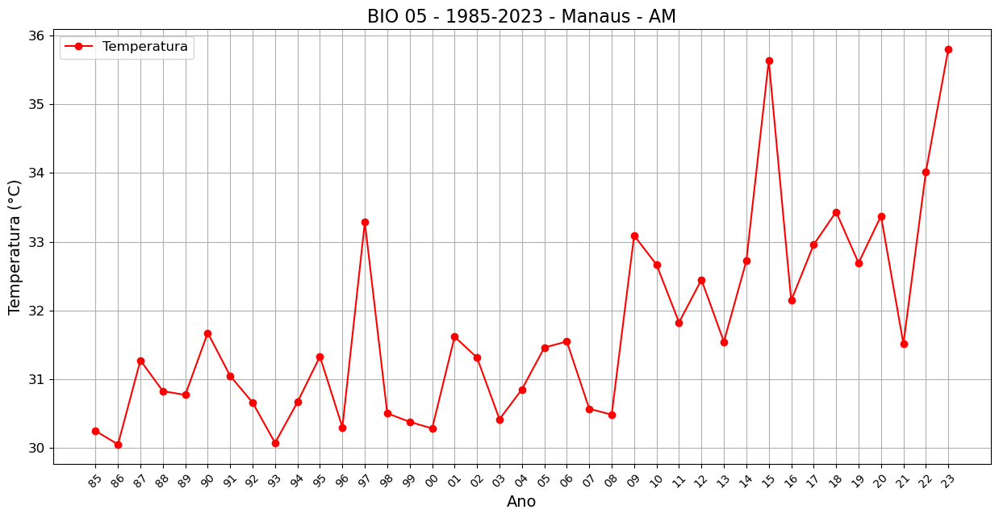

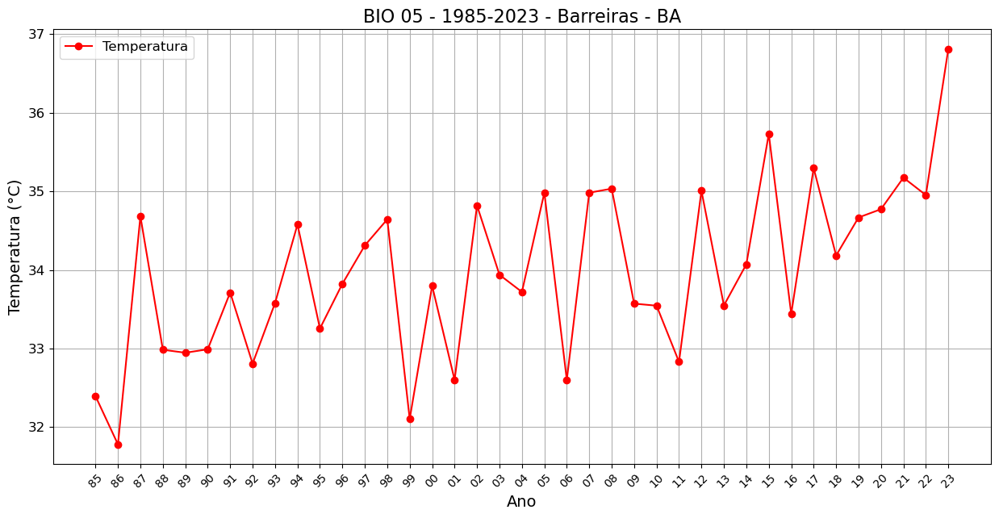

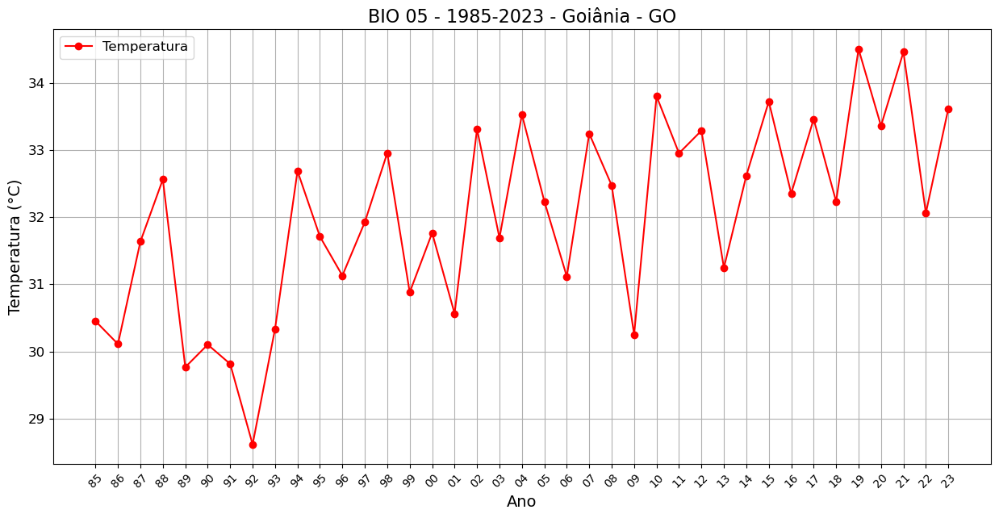

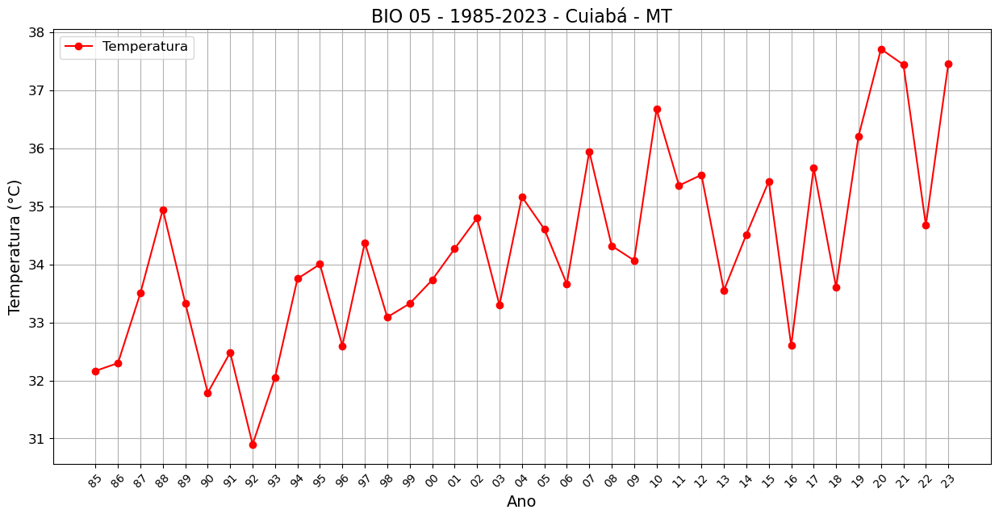

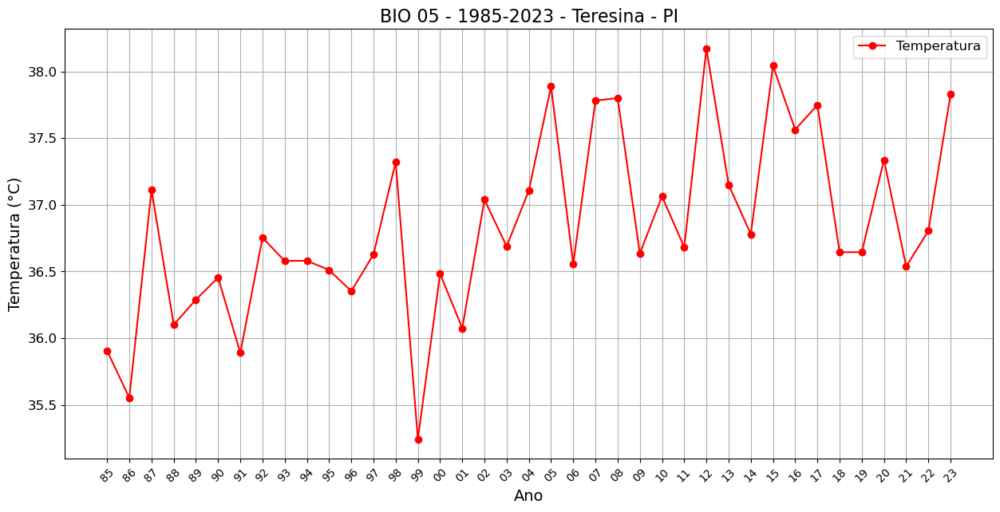

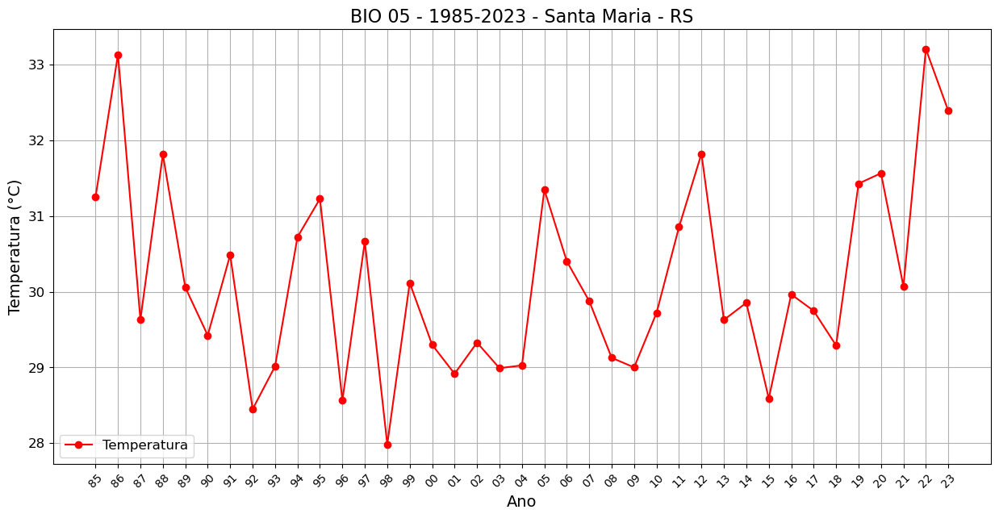

In [41]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO05
    Nome = 'BIO 05'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# BIO 06
BIO6 = Min Temperature of Coldest Month

## Equação
![Equação_BIO_06](Equações/Equacao_BIO06.png)

In [42]:
import xarray as xr
import numpy as np
import pandas as pd

BIO06 = xr.Dataset()

for ano in range(tmin['time'].dt.year.min().values,tmin['time'].dt.year.max().values):
    
    # Somar ao longo da dimensão 'time', ignorando NaN, e depois dividir por 12
    
    BIO06[f'BIO 06 {ano}'] = tmin.where(tmin['time'].dt.year == ano, drop=True).min(dim='time')

# Adicionando atributos
BIO06.attrs = {
    'title':'BIO 06 - Temperatura mínima mês mais frio',
    'description':'Esta informação é útil ao examinar saber se as distribuições das espécies são afetadas pelo frio e anomalias de temperatura ao longo do ano.',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'Cálculado temperatura mínima média do mês mais frio para cada ano. Sendo os valores de Tmax é determinado pela média mensal da temperatura máxima',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO06)
BIO06.to_netcdf("Variaveis_BIOClimaticas/BIO_06_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:      (lat: 750, lon: 551)
Coordinates:
  * lat          (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon          (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO 06 1985  (lat, lon) float64 3MB 18.12 17.94 18.03 18.51 ... nan nan nan
    BIO 06 1986  (lat, lon) float64 3MB 18.41 18.31 18.56 18.98 ... nan nan nan
    BIO 06 1987  (lat, lon) float64 3MB 18.6 18.56 18.81 19.34 ... nan nan nan
    BIO 06 1988  (lat, lon) float64 3MB 19.77 19.62 19.77 20.17 ... nan nan nan
    BIO 06 1989  (lat, lon) float64 3MB 18.64 18.48 18.67 18.95 ... nan nan nan
    BIO 06 1990  (lat, lon) float64 3MB 19.52 19.22 19.31 19.62 ... nan nan nan
    ...           ...
    BIO 06 2018  (lat, lon) float64 3MB 19.75 19.58 19.71 19.96 ... nan nan nan
    BIO 06 2019  (lat, lon) float64 3MB 19.68 19.48 19.61 20.01 ... nan nan nan
    BIO 06 2020  (lat, lon) float64 3MB 20.15 19.99 20.14 20.53 ... nan nan nan
    BIO 06 2021  (lat, lon) float64 3MB 19.76 19.6 19.71 20.17 ... nan nan nan
    BIO 06 2022  (lat, lon) float64 3MB 19.14 18.85 19.0 19.53 ... nan nan nan
    BIO 06 2023  (lat, lon) float64 3MB 19.21 19.01 19.18 19.68 ... nan nan nan
Attributes: (12/13)
    title:                BIO 06 - Temperatura mínima mês mais frio
    description:          Esta informação é útil ao examinar saber se as dist...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    methodology:          Cálculado temperatura mínima média do mês mais frio...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

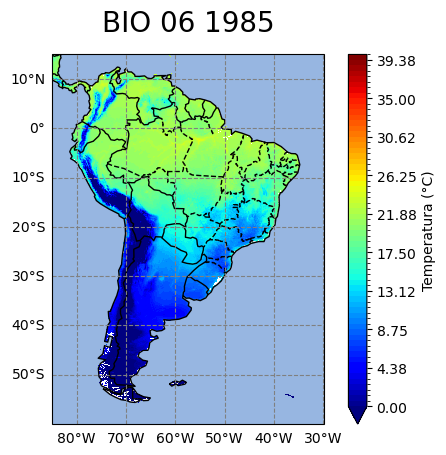

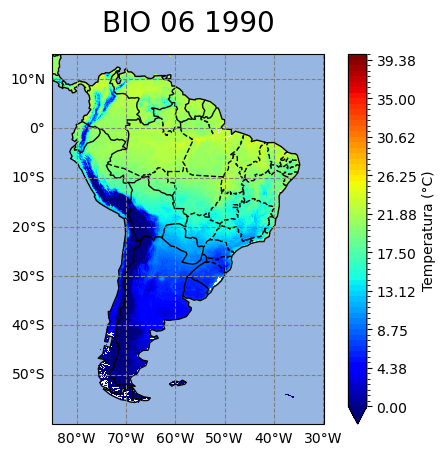

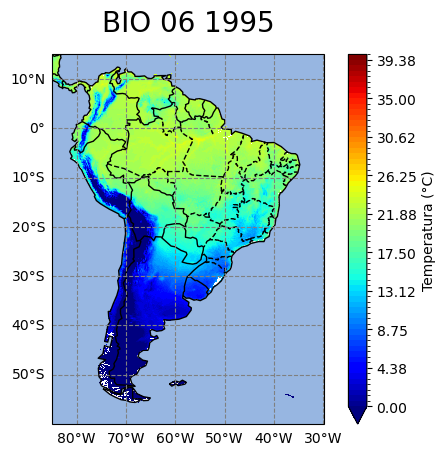

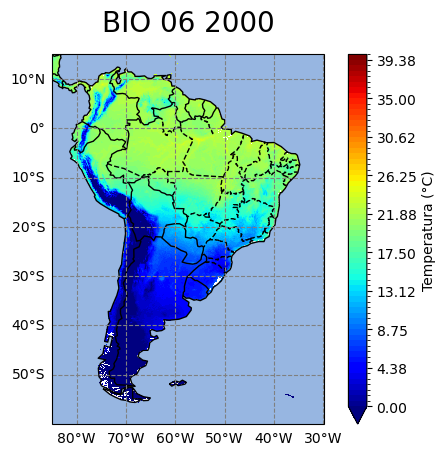

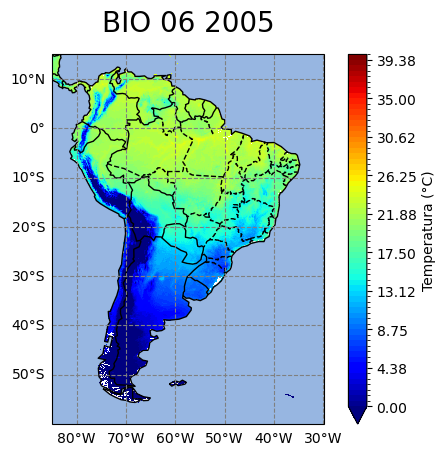

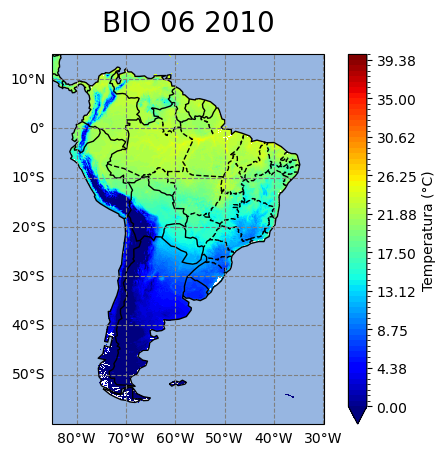

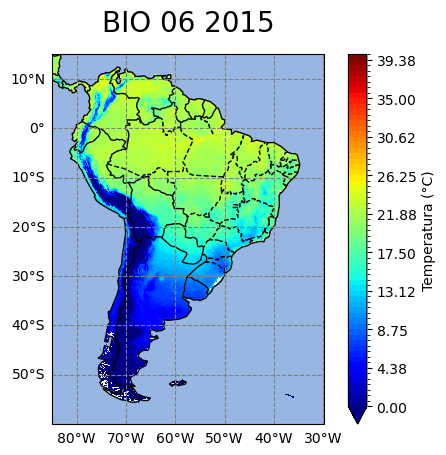

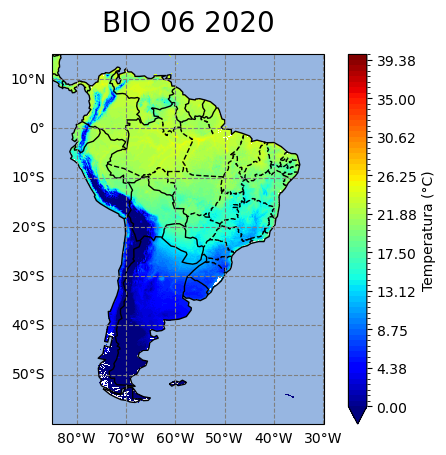

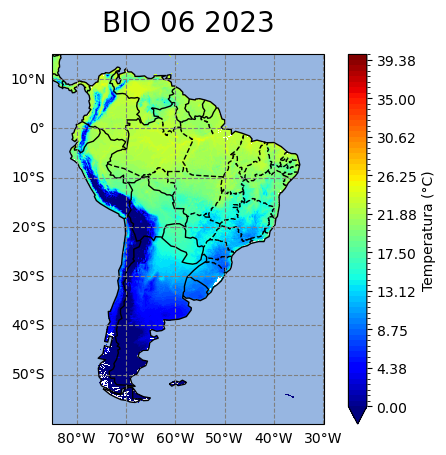

In [43]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 06 {ano}'               
    Base= BIO06[valor]
    max = 40
    min = 0
    FazMapa(Base,valor,max,min)

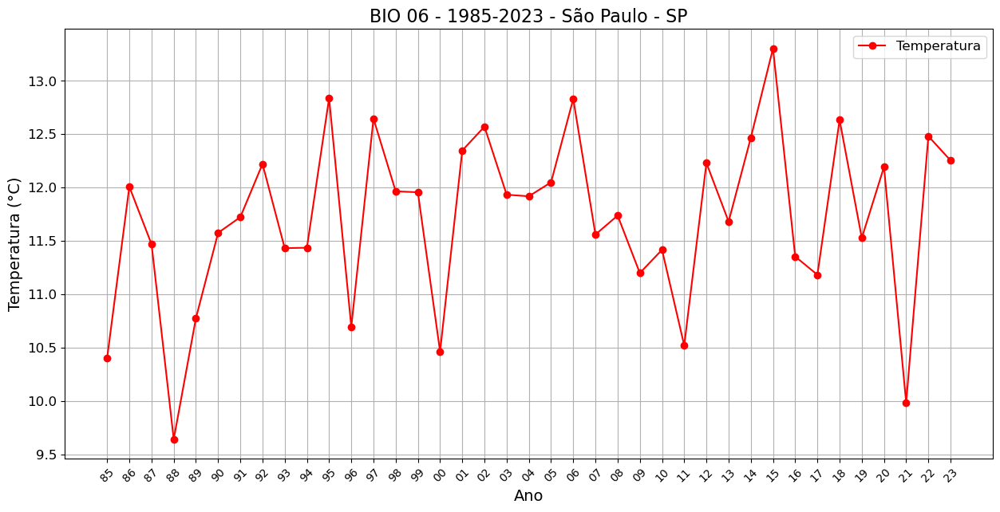

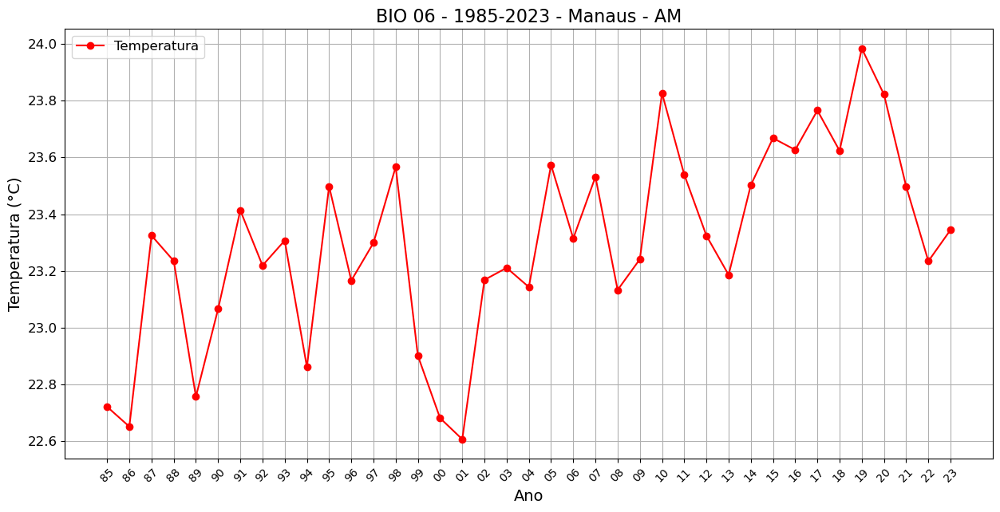

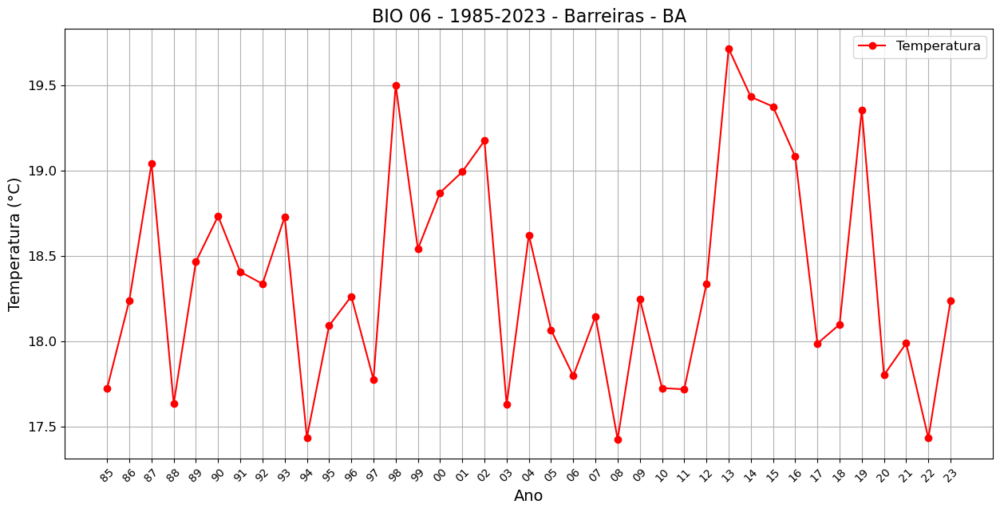

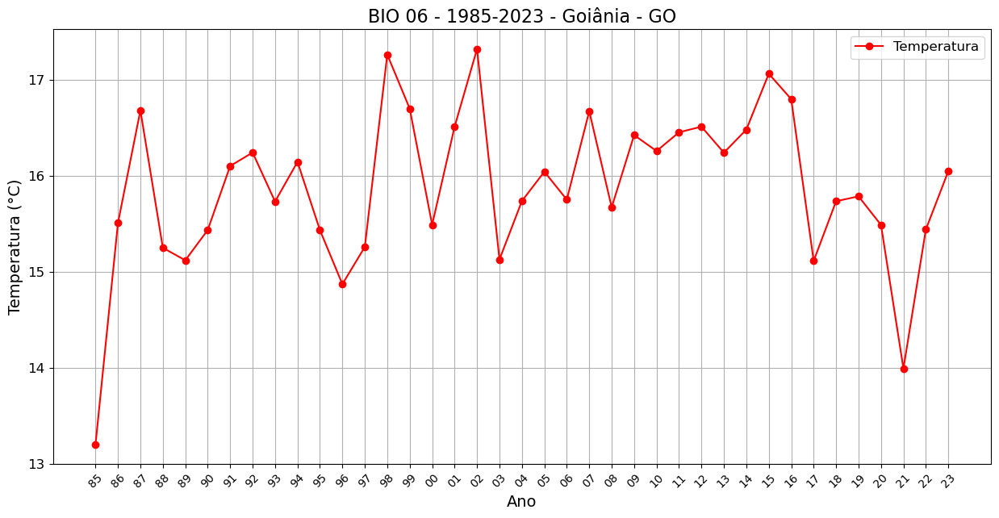

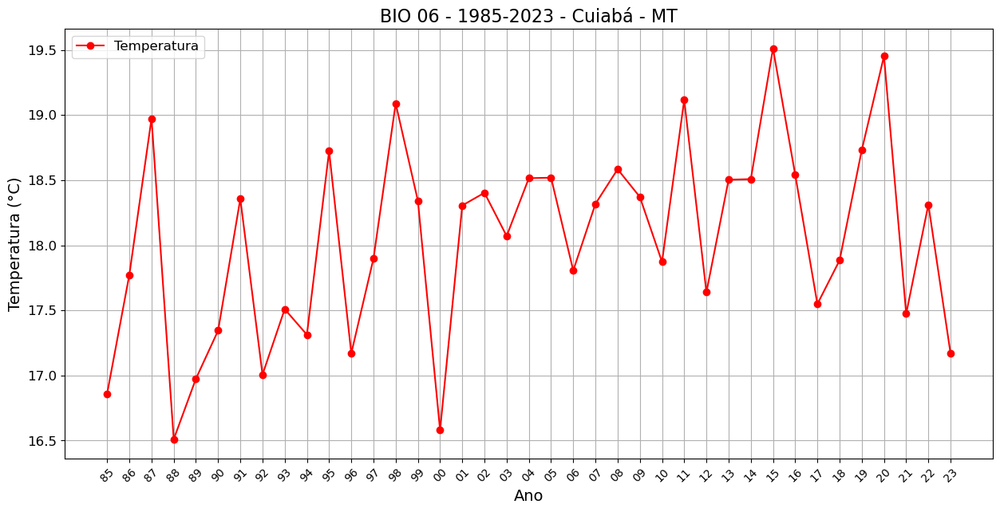

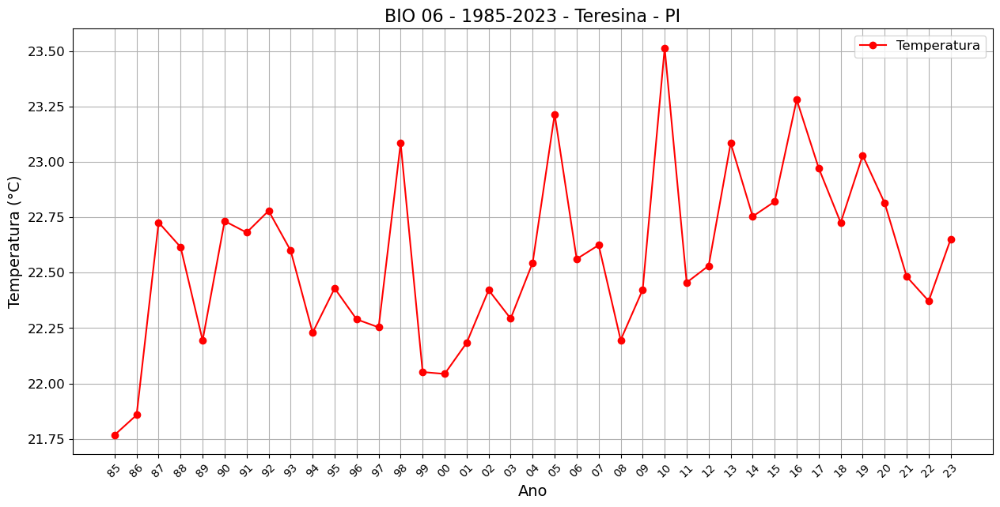

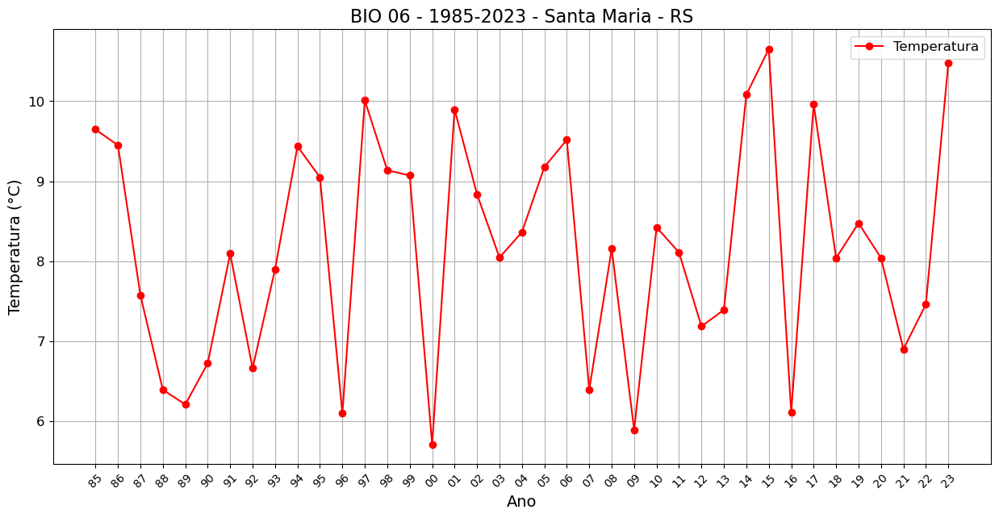

In [44]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO06
    Nome = 'BIO 06'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# BIO 07
BIO7 = Temperature Annual Range

## Equação
![Equação_BIO_07](Equações/Equacao_BIO07.png)

In [45]:
import xarray as xr
import numpy as np
import pandas as pd

BIO07 = xr.Dataset()

for ano in range(tmin['time'].dt.year.min().values,tmin['time'].dt.year.max().values):
    BIO07[f'BIO 07 {ano}']=BIO05[f'BIO 05 {ano}']-BIO06[f'BIO 06 {ano}']

# Adicionando atributos
BIO07.attrs = {
    'title':'BIO 07 – Faixa Anual de Temperatura',
    'description':'Esta informação é útil para saber se as distribuições de espécies são afetadas por intervalos de condições extremas de temperatura.',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'Cálculado a diferença entre a média da temperatura máxima do mês mais quente e a média da temperatura mínima do mês mais frio para cada ano',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO07)
BIO07.to_netcdf("Variaveis_BIOClimaticas/BIO_07_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:      (lat: 750, lon: 551)
Coordinates:
  * lat          (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon          (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO 07 1985  (lat, lon) float64 3MB 12.35 12.12 11.99 11.6 ... nan nan nan
    BIO 07 1986  (lat, lon) float64 3MB 11.97 11.74 11.41 10.97 ... nan nan nan
    BIO 07 1987  (lat, lon) float64 3MB 12.96 12.74 12.49 11.91 ... nan nan nan
    BIO 07 1988  (lat, lon) float64 3MB 12.06 11.98 11.87 11.53 ... nan nan nan
    BIO 07 1989  (lat, lon) float64 3MB 11.08 10.97 10.85 10.7 ... nan nan nan
    BIO 07 1990  (lat, lon) float64 3MB 10.28 10.19 10.06 9.847 ... nan nan nan
    ...           ...
    BIO 07 2018  (lat, lon) float64 3MB 10.5 10.31 10.12 9.972 ... nan nan nan
    BIO 07 2019  (lat, lon) float64 3MB 11.61 11.32 11.06 10.83 ... nan nan nan
    BIO 07 2020  (lat, lon) float64 3MB 13.36 13.19 12.99 12.87 ... nan nan nan
    BIO 07 2021  (lat, lon) float64 3MB 11.02 10.9 10.81 10.44 ... nan nan nan
    BIO 07 2022  (lat, lon) float64 3MB 11.09 10.91 10.69 10.18 ... nan nan nan
    BIO 07 2023  (lat, lon) float64 3MB 13.58 13.47 13.38 12.81 ... nan nan nan
Attributes: (12/13)
    title:                BIO 07 – Faixa Anual de Temperatura
    description:          Esta informação é útil para saber se as distribuiçõ...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    methodology:          Cálculado a diferença entre a média da temperatura ...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

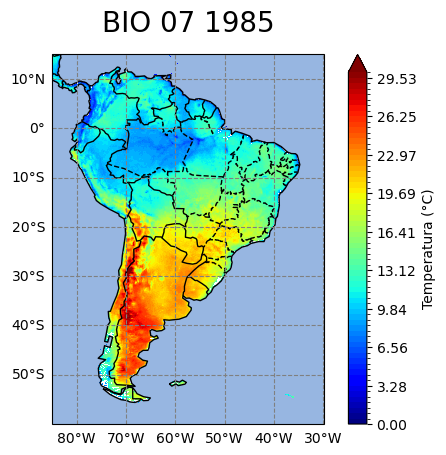

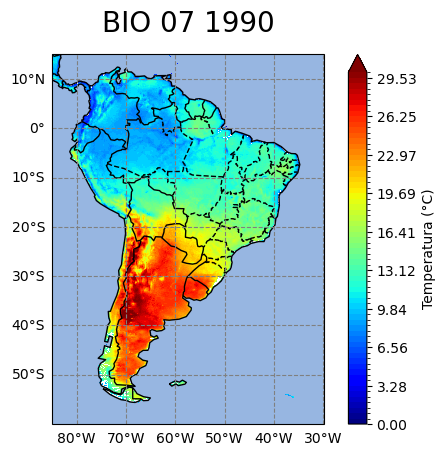

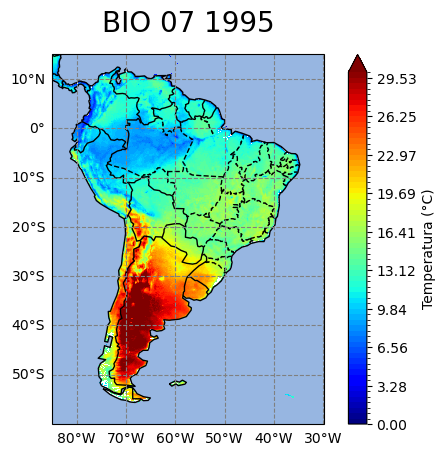

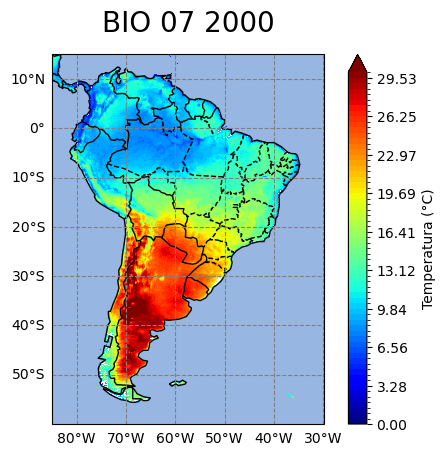

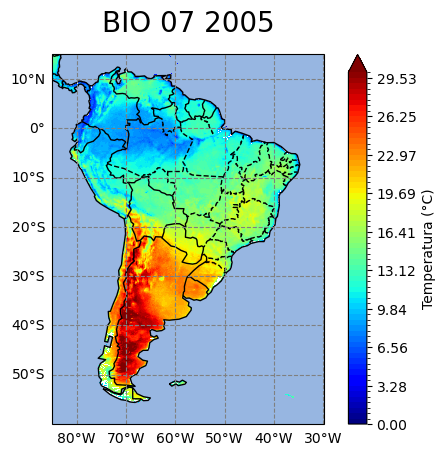

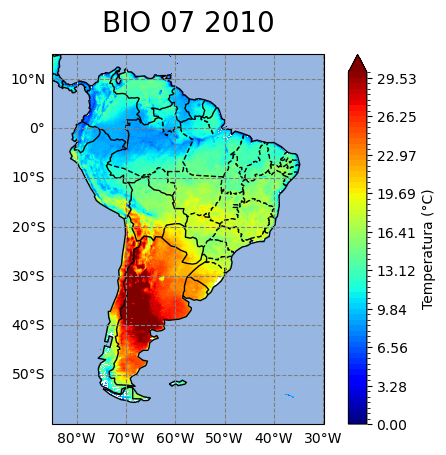

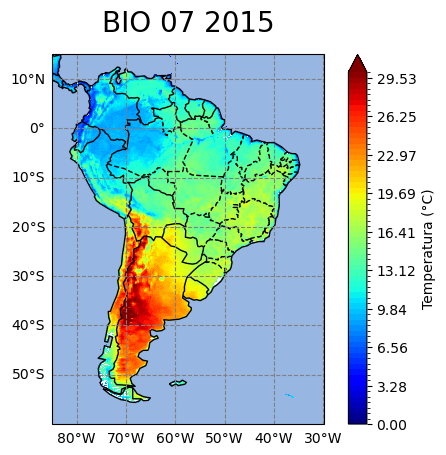

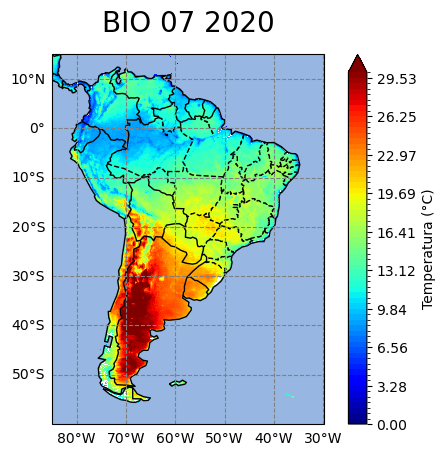

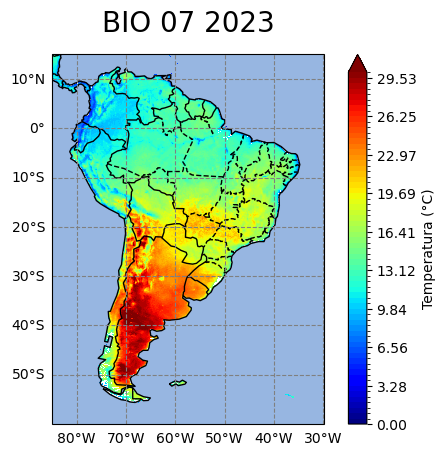

In [46]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 07 {ano}'               
    Base= BIO07[valor]
    max = 30
    min = 0
    FazMapa(Base,valor,max,min)

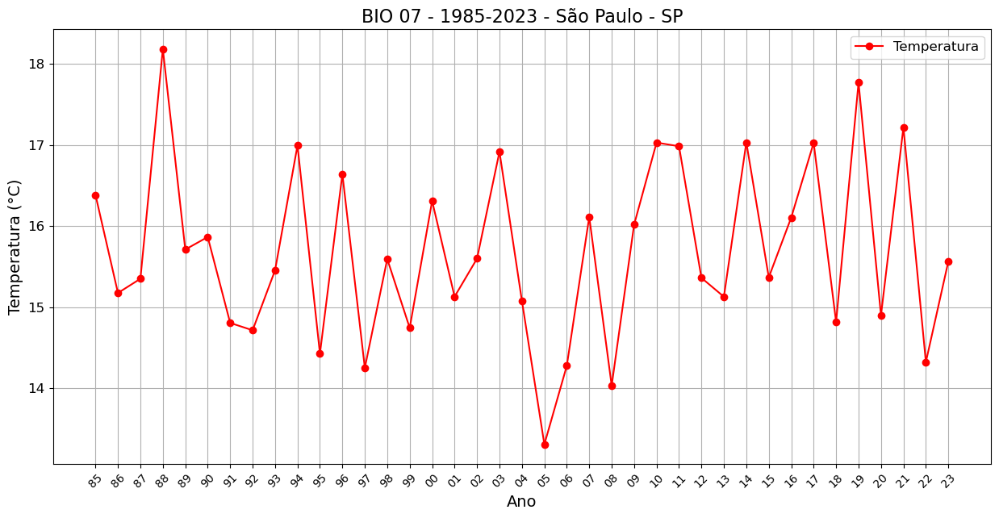

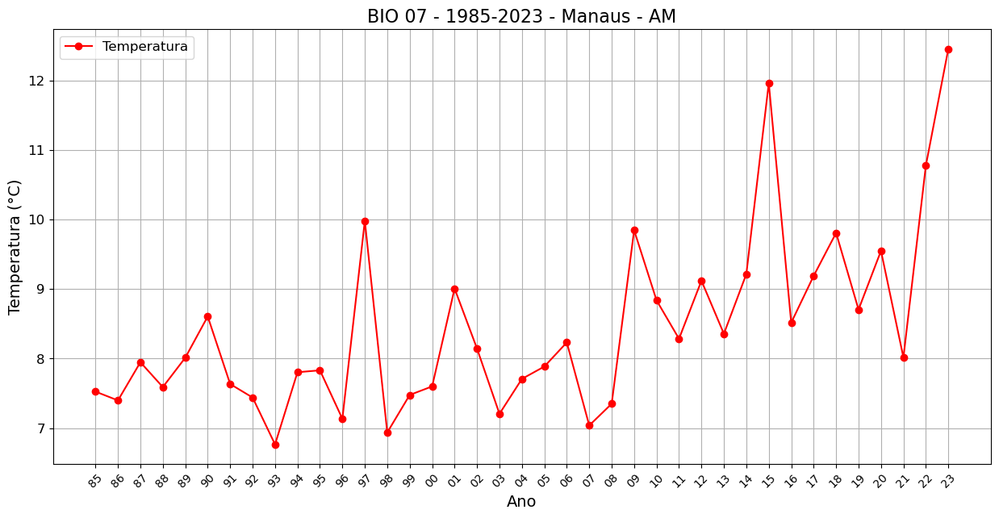

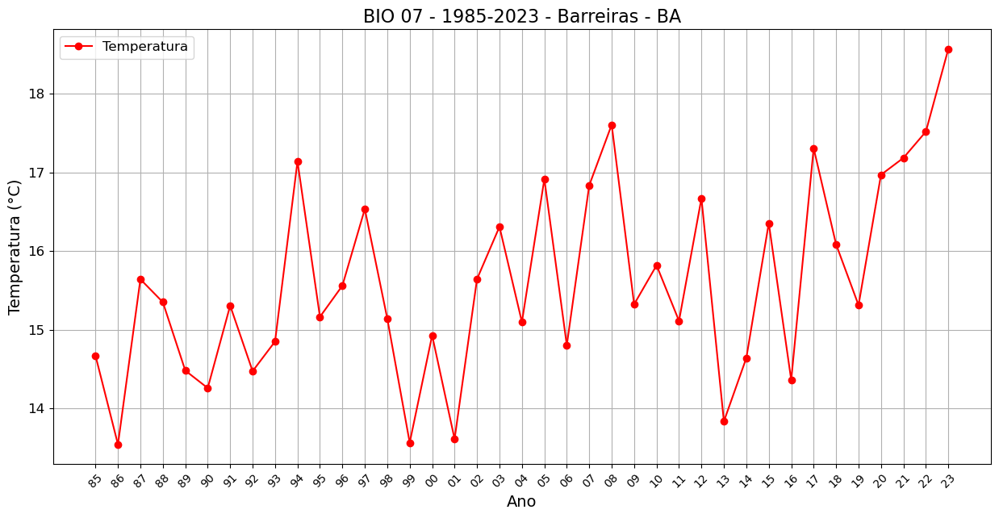

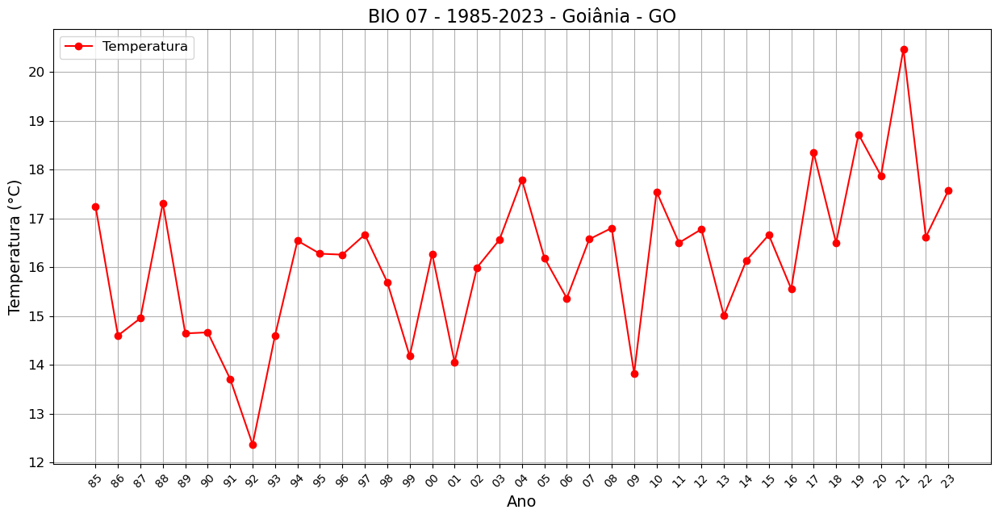

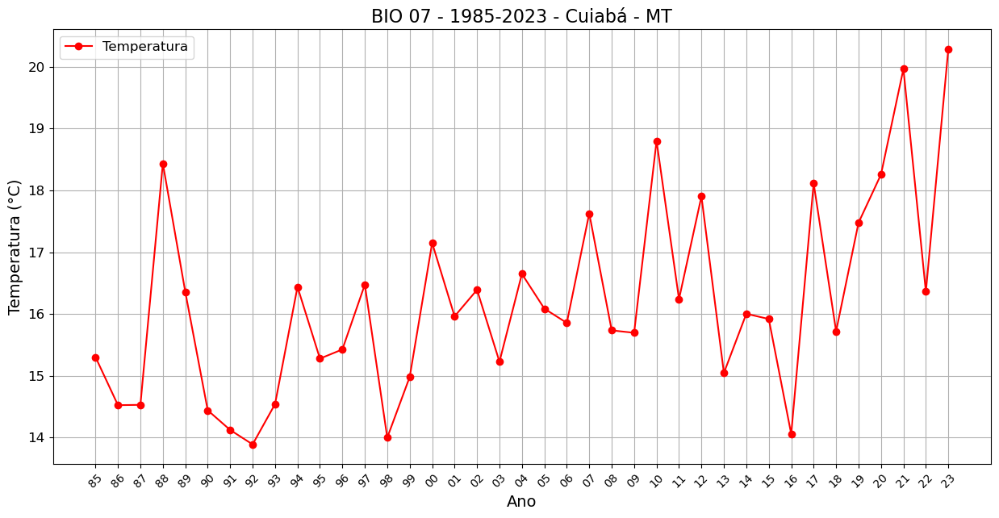

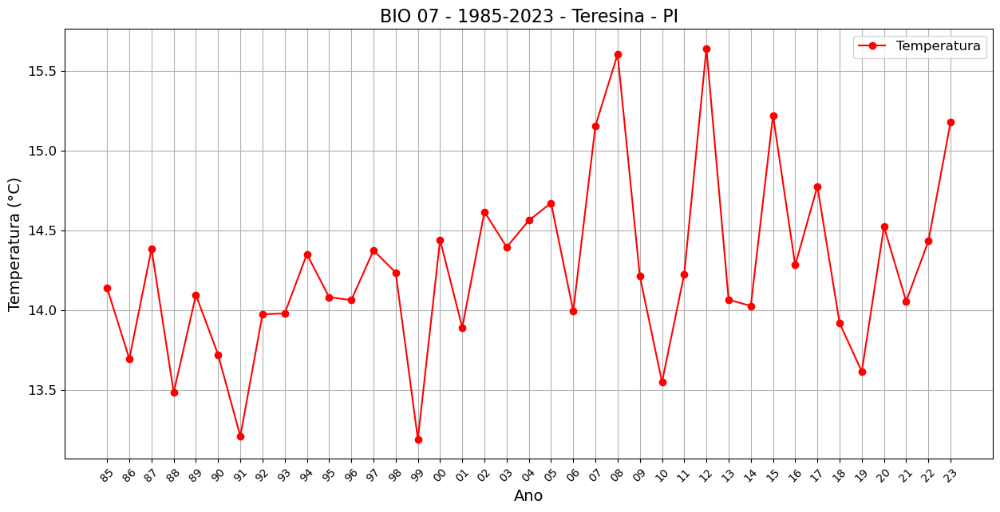

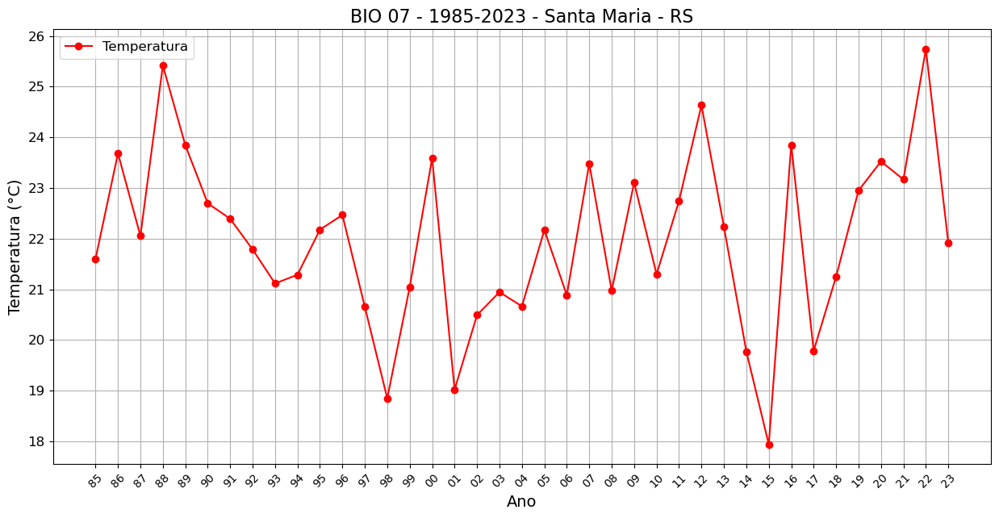

In [47]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO07
    Nome = 'BIO 07'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# Cálculo trimestres

## Equação
![Equação_BIO_10](Equações/Equacao_trimestre.png)

In [48]:
ano = 1984
Qtrim = xr.Dataset()
for i in range(0,len(Tavgi['time'])):
    if i%12 == 0:
        ano=ano+1
        m=0
    m+=1
    Qtrim [f'T_{m}_{ano}'] = Tavgi.isel(time=slice(i, i+3)).sum(dim='time', skipna=False)
display(Qtrim)

<xarray.Dataset> Size: 2GB
Dimensions:    (lat: 750, lon: 551)
Coordinates:
  * lat        (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon        (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/470)
    T_1_1985   (lat, lon) float64 3MB 68.08 67.33 67.57 68.28 ... nan nan nan
    T_2_1985   (lat, lon) float64 3MB 71.68 70.87 71.13 71.73 ... nan nan nan
    T_3_1985   (lat, lon) float64 3MB 75.38 74.46 74.6 75.16 ... nan nan nan nan
    T_4_1985   (lat, lon) float64 3MB 76.54 75.83 76.0 76.6 ... nan nan nan nan
    T_5_1985   (lat, lon) float64 3MB 75.8 75.23 75.46 76.14 ... nan nan nan nan
    T_6_1985   (lat, lon) float64 3MB 74.64 74.19 74.54 75.3 ... nan nan nan nan
    ...         ...
    T_9_2023   (lat, lon) float64 3MB 77.71 77.03 77.3 78.18 ... nan nan nan nan
    T_10_2023  (lat, lon) float64 3MB 75.35 74.76 75.08 75.93 ... nan nan nan
    T_11_2023  (lat, lon) float64 3MB 73.26 72.85 73.32 74.1 ... nan nan nan nan
    T_12_2023  (lat, lon) float64 3MB 71.99 71.75 72.55 72.94 ... nan nan nan
    T_1_2024   (lat, lon) float64 3MB 47.8 47.73 48.41 48.53 ... nan nan nan nan
    T_2_2024   (lat, lon) float64 3MB 23.64 23.61 24.07 24.02 ... nan nan nan

# BIO 10
BIO10 = Mean Temperature of Warmest Quarter

## Equação
![Equação_Trimestre](Equações/Equacao_BIO10.png)

In [111]:
import xarray as xr
import numpy as np
import pandas as pd

BIO10 = xr.Dataset()
temp = xr.Dataset()
TrimMaisQuente={}
for ano in range(tmin['time'].dt.year.min().values,tmin['time'].dt.year.max().values):
    #Inicia o laço colocando os dados de mês a mês, alimentando com os dados dos trimestres selecionados e selecionar o maior para o preenchimento do BIO10
    for mes in range(1,12+1):
        temp [f'T_{mes}_{ano}'] = Qtrim [f'T_{mes}_{ano}']
        
    BIO10 [f'BIO10 {ano}'] = (xr.concat([temp [var] for var in temp ], dim='variable').max(dim='variable'))/3
    #print(np.array(xr.concat([temp [var] for var in temp ], dim='variable')).argmax(axis=0))
    #BIO10 [f'BIO10tri {ano}'] = (xr.concat([temp [var] for var in temp ], dim='variable').values.argmax(dim='variable'))
    #df['column'][df.index.min():df.index.max()]
    #resultArgTri [f'BIO10tri {ano}'] = (("time", "latitude", "longitude"),np.array(xr.concat([temp [var] for var in temp ], dim='variable')).argmax(axis=0))
    TrimMaisQuente [f'Trim_mais_Quente {ano}'] = np.array(xr.concat([temp [var] for var in temp ], dim='variable')).argmax(axis=0)+1
    
    temp = xr.Dataset()


# Adicionando atributos
BIO10.attrs = {
    'title':'BIO 10 – Temperatura Média do Trimestre mais quente',
    'description':'Este índice fornece a temperatura média durante os três meses mais quentes do ano, o que pode ser útil para examinar como tais fatores ambientais podem afetar as distribuições sazonais de espécies.',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'Cálculado pela média da temperatura do trimestre mais quente do ano, o ano tendo 12 trimestres, finalizando em Dez/Jan/Fev, com o Jan e Fev do ano seguinte.',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO10)
BIO10.to_netcdf("Variaveis_BIOClimaticas/BIO_10_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:     (lat: 750, lon: 551)
Coordinates:
  * lat         (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon         (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO10 1985  (lat, lon) float64 3MB 25.51 25.28 25.33 25.53 ... nan nan nan
    BIO10 1986  (lat, lon) float64 3MB 25.6 25.37 25.41 25.56 ... nan nan nan
    BIO10 1987  (lat, lon) float64 3MB 26.28 26.13 26.18 26.43 ... nan nan nan
    BIO10 1988  (lat, lon) float64 3MB 26.41 26.25 26.29 26.52 ... nan nan nan
    BIO10 1989  (lat, lon) float64 3MB 25.4 25.18 25.27 25.52 ... nan nan nan
    BIO10 1990  (lat, lon) float64 3MB 25.46 25.24 25.33 25.56 ... nan nan nan
    ...          ...
    BIO10 2018  (lat, lon) float64 3MB 25.73 25.51 25.55 25.81 ... nan nan nan
    BIO10 2019  (lat, lon) float64 3MB 26.27 26.06 26.16 26.39 ... nan nan nan
    BIO10 2020  (lat, lon) float64 3MB 26.99 26.83 26.85 27.11 ... nan nan nan
    BIO10 2021  (lat, lon) float64 3MB 25.98 25.77 25.83 26.03 ... nan nan nan
    BIO10 2022  (lat, lon) float64 3MB 25.41 25.21 25.32 25.61 ... nan nan nan
    BIO10 2023  (lat, lon) float64 3MB 27.15 26.95 27.03 27.27 ... nan nan nan
Attributes: (12/13)
    title:                BIO 10 – Temperatura Média do Trimestre mais quente
    description:          Este índice fornece a temperatura média durante os ...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    methodology:          Cálculado pela média da temperatura do trimestre ma...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

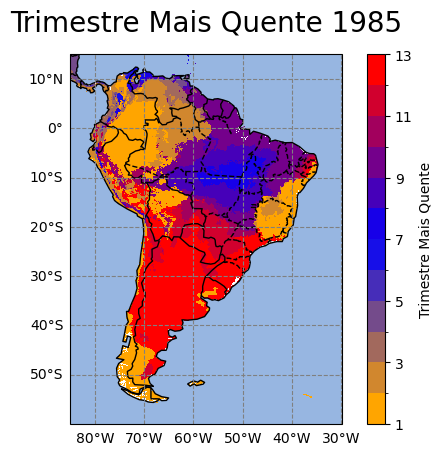

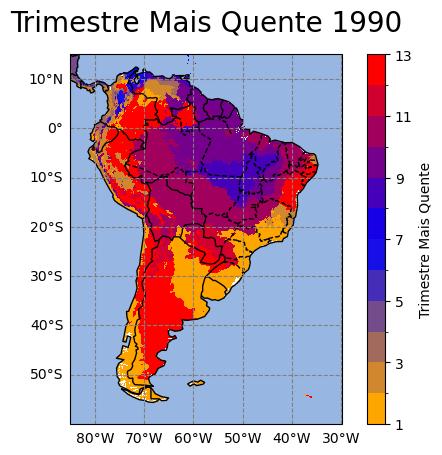

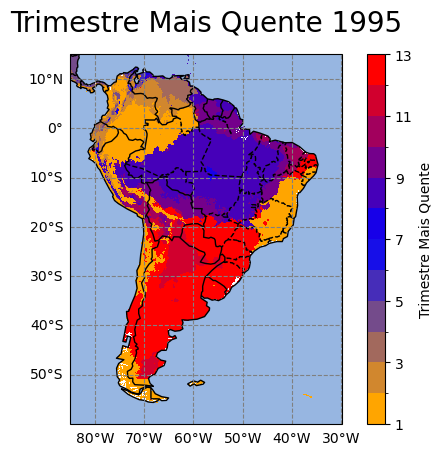

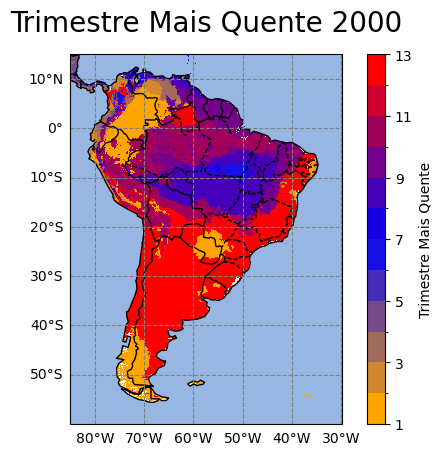

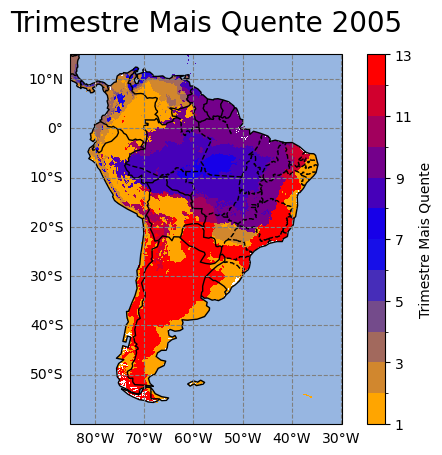

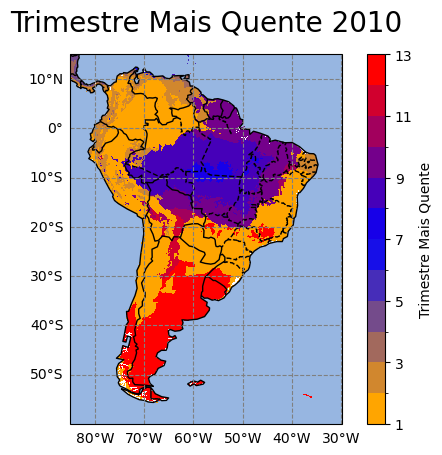

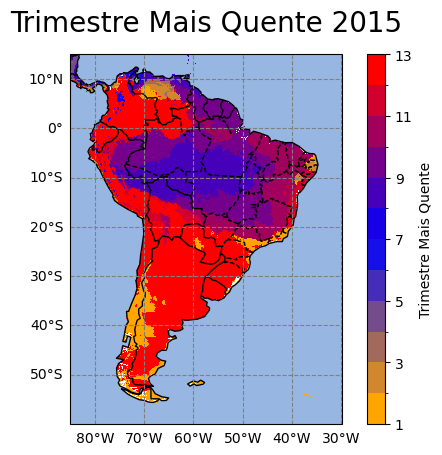

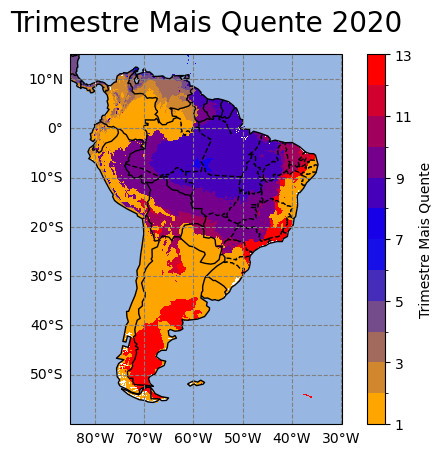

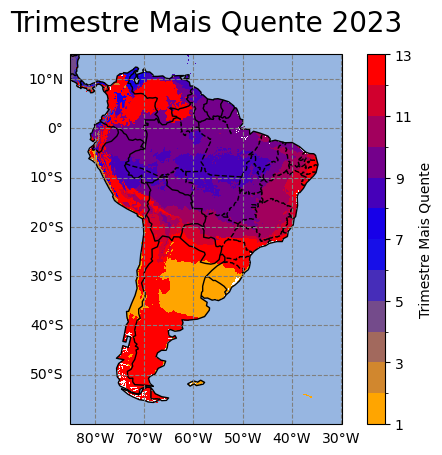

In [206]:
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from matplotlib.colors import LinearSegmentedColormap

colors = ['orange', 'blue', 'red']  # Azul, branco e vermelho
n_bins = 100  # Número de bins
cmap_name = 'orange_blue_red'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bins)
# Lista de anos para exibição
anos = list(range(1985, 2023, 5)) + [2023]

# Colormap com 12 cores
cmap = plt.get_cmap(cmap, 13)  # Usando o colormap 'tab20c' e limitando a 12 cores

for ano in anos:
    # Extraindo o valor do trimestre mais frio
    var = f'Trim_mais_Quente {ano}'               
    Base = TrimMaisQuente[var]
     
    # Converter o numpy.ndarray para xarray.DataArray com as coordenadas geográficas (latitude, longitude)
    Base_xr = xr.DataArray(Base, dims=["lat", "lon"], coords={"lat": latitudes_unicas, "lon": longitudes_unicas})
    Base_xr= Base_xr.where(~np.isnan(BIO03['BIO 03 1999']), np.nan)
    # Configurar o plot
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
    
    # Plotar o trimestre mais frio usando imshow
    Base_xr.plot(ax=ax, transform=ccrs.PlateCarree(), cmap=cmap, 
                 cbar_kwargs={'label': 'Trimestre Mais Quente'},
                 levels=np.arange(1, 14, 1))  # Definindo 12 níveis para os trimestres (1 a 12)
    
    # Adicionando o contorno dos continentes, países e estados do Brasil
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.OCEAN)
    
    # Adicionando os limites estaduais do Brasil
    states = cfeature.NaturalEarthFeature(category='cultural',
                                          name='admin_1_states_provinces_lines',
                                          scale='50m',
                                          facecolor='none')
    ax.add_feature(states, edgecolor='k', linestyle='--')
    
    # Adicionando título à figura
    ax.set_title(f"Trimestre Mais Quente {ano}", fontsize=20, y=1.04)
    
    # Adicionando as linhas de grade
    g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)
    
    # Formatando os labels como latitude e longitude
    g1.yformatter = LATITUDE_FORMATTER
    g1.xformatter = LONGITUDE_FORMATTER
    
    # Remover as grades superior e direita
    g1.ylabels_right = False  # Remove labels do eixo y à direita
    g1.right_labels = False  # Remove a linha de grade à direita
    g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas
    
    # Remove as linhas de grade no topo
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    g1.top_labels = False  # Remove a linha de grade no topo

    # Salvar e mostrar o gráfico
    plt.savefig(f"Mapas/Mapa_TrimMaisQuente_{ano}.png", dpi=300, bbox_inches='tight')
    plt.show()

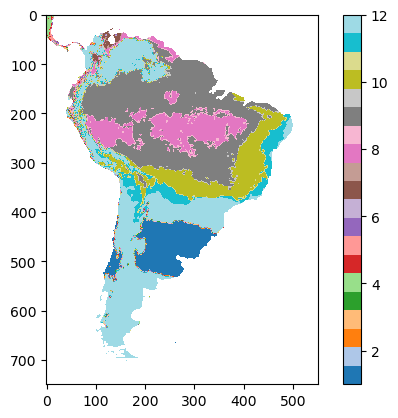

In [50]:
for var,var2 in zip(TrimMaisQuente.keys(), BIO10.keys()):
    TrimMaisQuente[var] = TrimMaisQuente[var].astype(float)
    TrimMaisQuente[var][np.isnan(BIO10[var2])]=np.nan
#display(resultArgTri)

plt.imshow(TrimMaisQuente["Trim_mais_Quente 2023"], cmap="tab20")
plt.colorbar()

In [51]:
'''
#resultArgTri["BIO10tri 1985"][np.isnan(BIO10["BIO10 1985"])]=-1
# Transforma os valores onde BIO10["BIO10 1985"] é NaN em np.nan no resultArgTri
#resultArgTri["BIO10tri 1985"] = resultArgTri["BIO10tri 1985"].where(~np.isnan(BIO10["BIO10 1985"]), np.nan)
# Converte o array para float
resultArgTri["BIO10tri 1985"] = resultArgTri["BIO10tri 1985"].astype(float)
resultArgTri["BIO10tri 1985"][np.isnan(BIO10["BIO10 1985"])]=np.nan
plt.imshow(resultArgTri["BIO10tri 1985"], cmap="tab20")
plt.colorbar()
'''

'\n#resultArgTri["BIO10tri 1985"][np.isnan(BIO10["BIO10 1985"])]=-1\n# Transforma os valores onde BIO10["BIO10 1985"] é NaN em np.nan no resultArgTri\n#resultArgTri["BIO10tri 1985"] = resultArgTri["BIO10tri 1985"].where(~np.isnan(BIO10["BIO10 1985"]), np.nan)\n# Converte o array para float\nresultArgTri["BIO10tri 1985"] = resultArgTri["BIO10tri 1985"].astype(float)\nresultArgTri["BIO10tri 1985"][np.isnan(BIO10["BIO10 1985"])]=np.nan\nplt.imshow(resultArgTri["BIO10tri 1985"], cmap="tab20")\nplt.colorbar()\n'

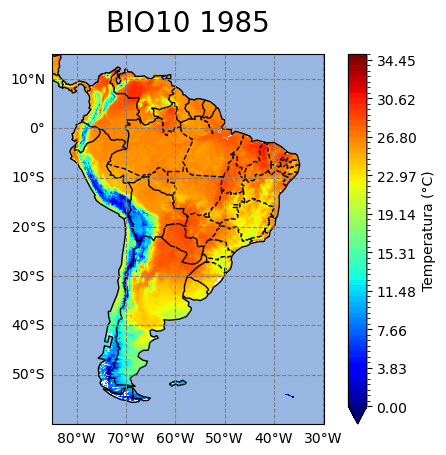

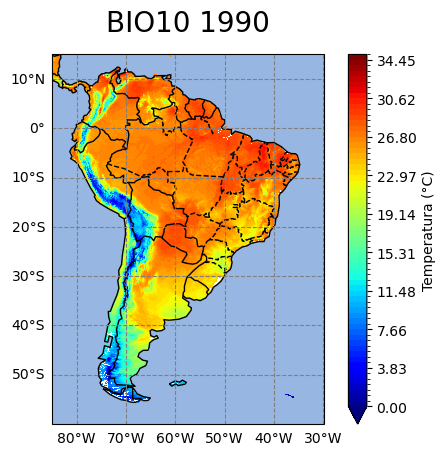

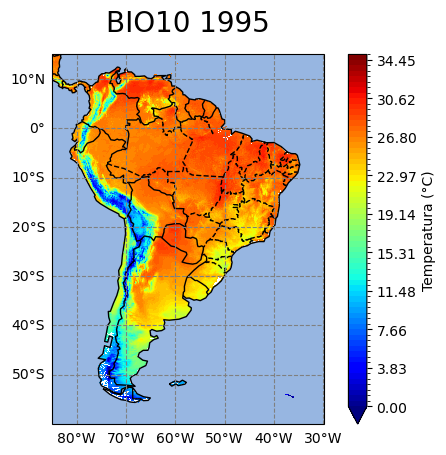

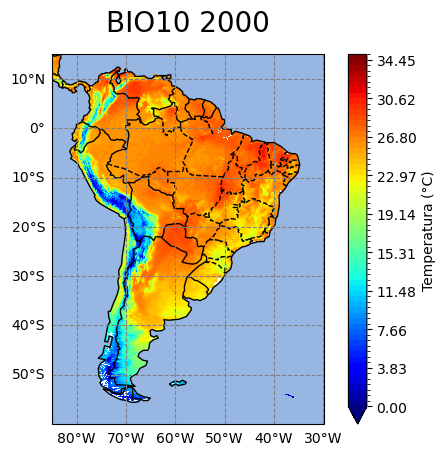

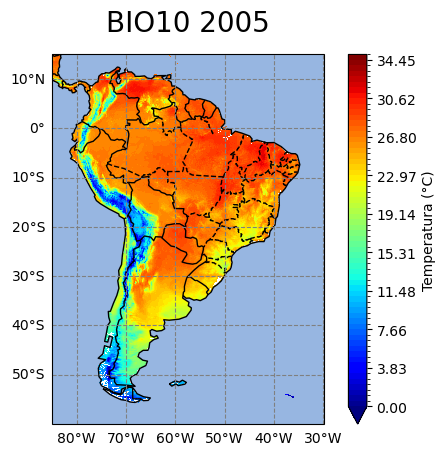

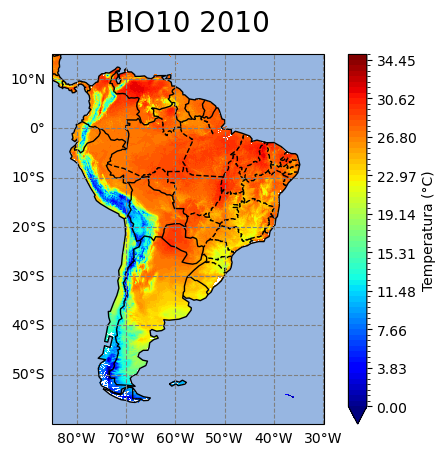

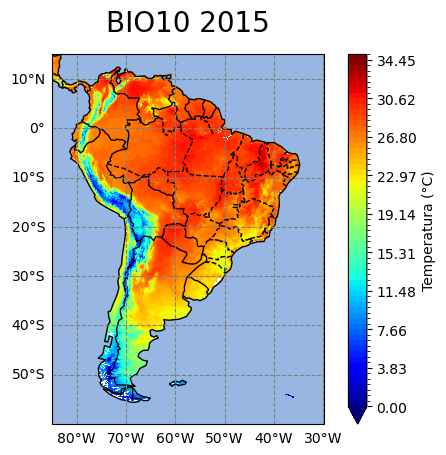

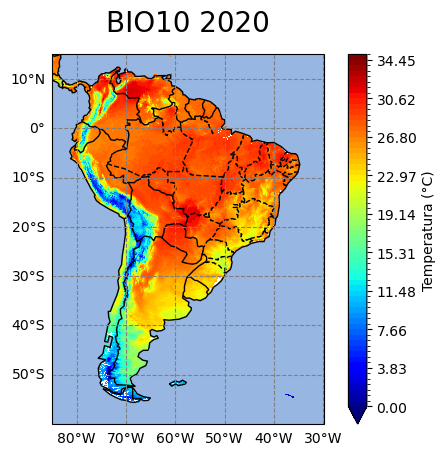

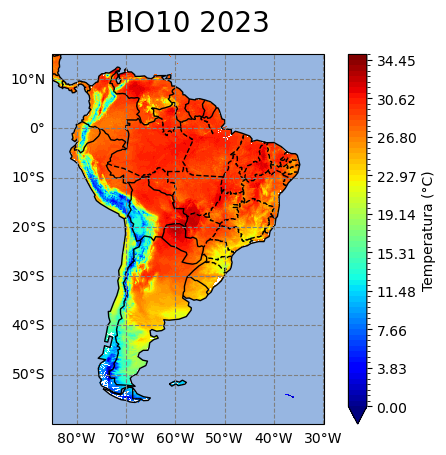

In [52]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO10 {ano}'               
    Base= BIO10[valor]
    max = 35
    min = 0
    FazMapa(Base,valor,max,min)

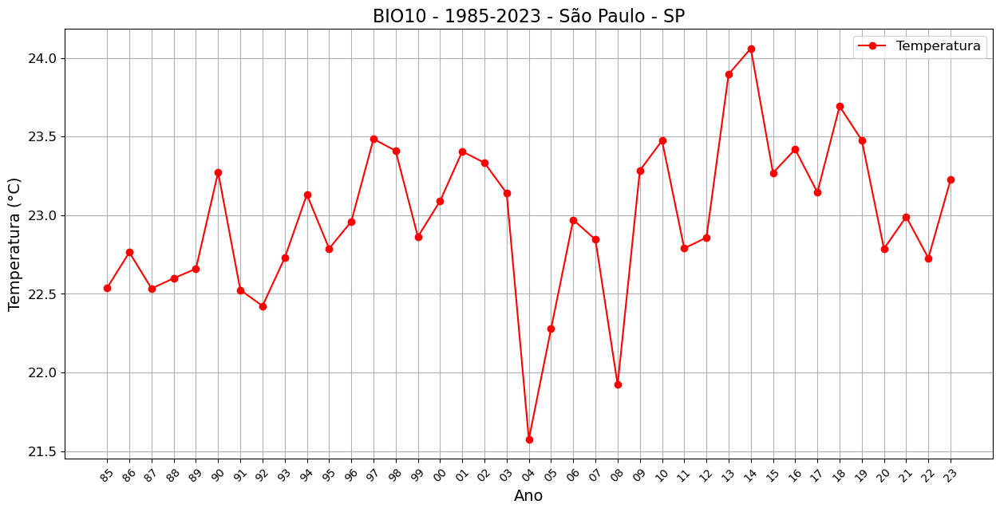

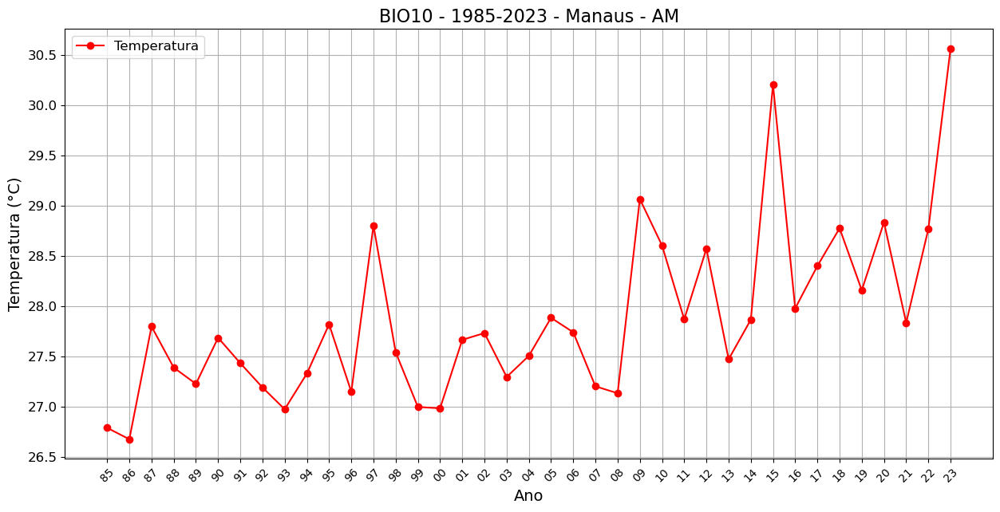

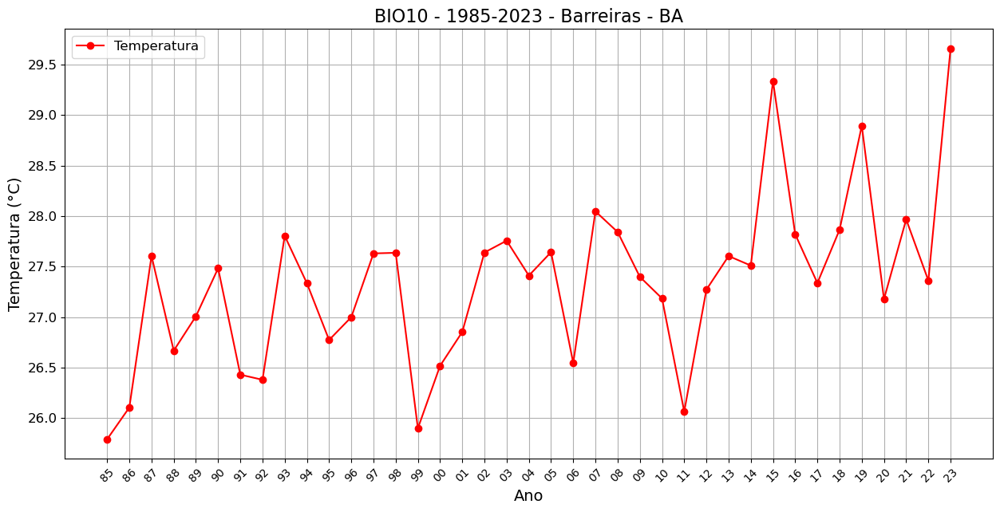

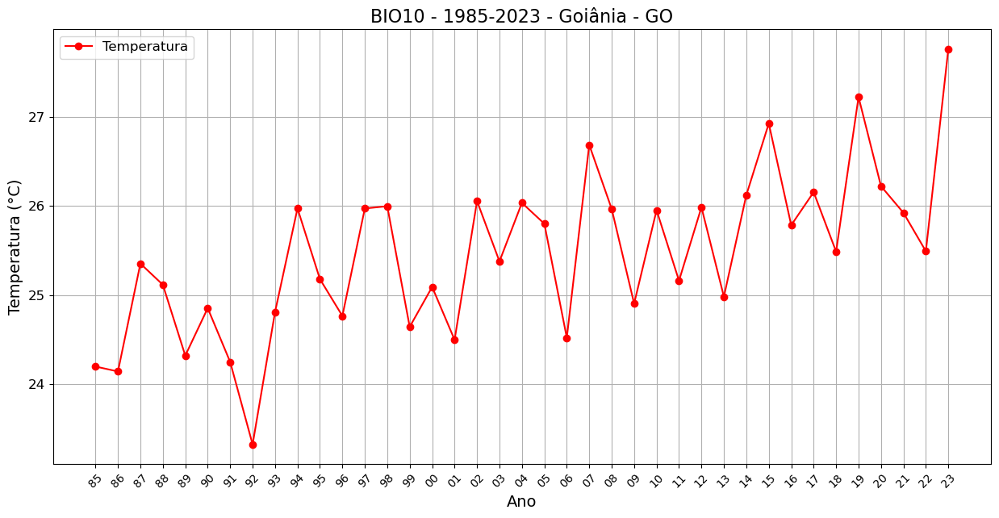

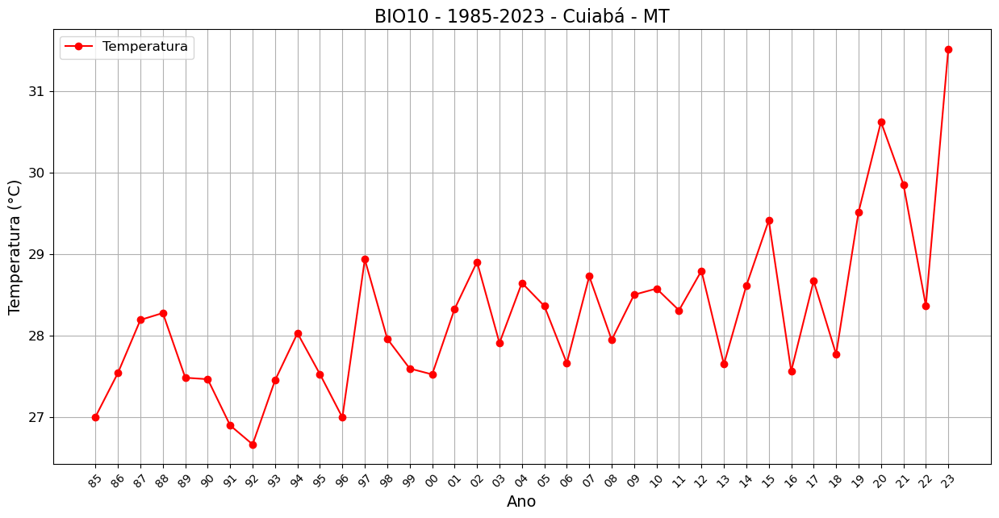

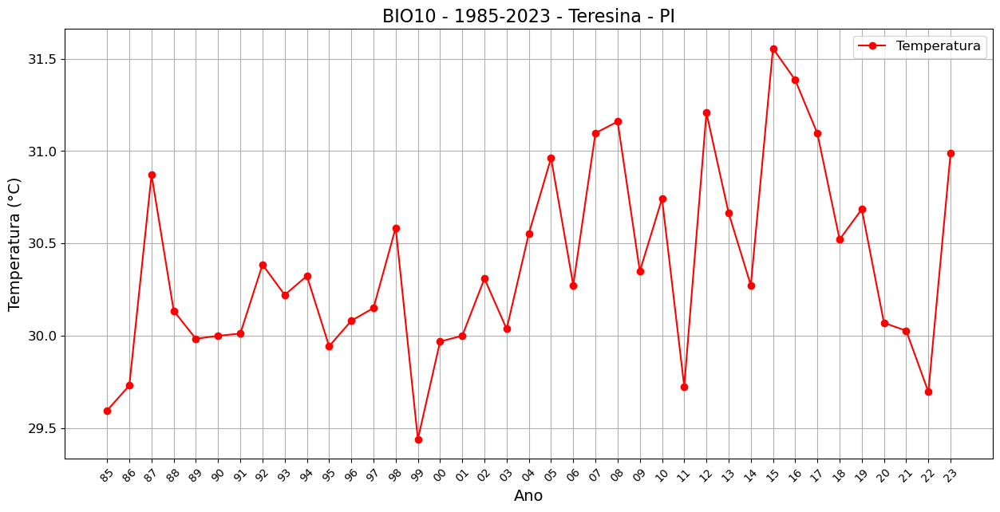

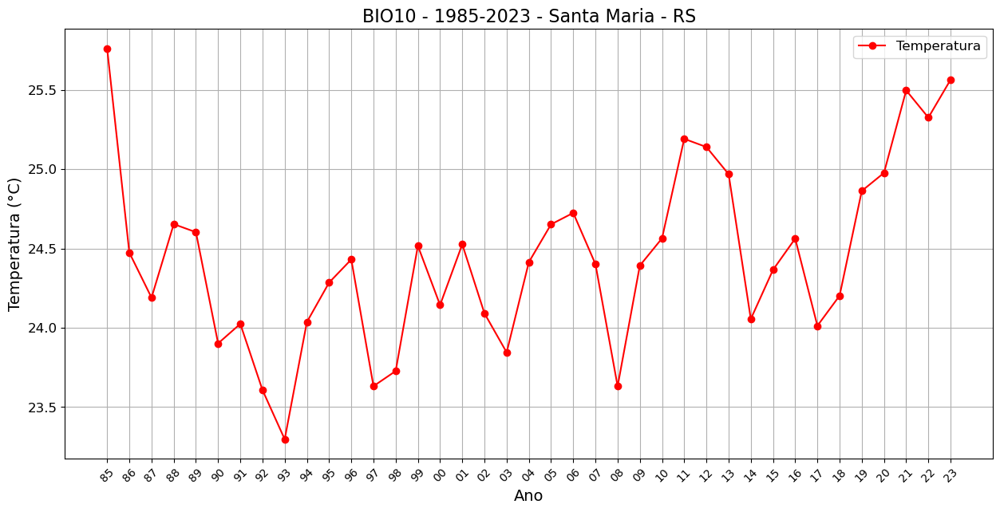

In [53]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO10
    Nome = 'BIO10'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# BIO 11
BIO11 = Mean Temperature of Coldest Quartr

## Equação
![Equação_BIO_11](Equações/Equacao_BIO11.png)

In [178]:
import xarray as xr
import numpy as np
import pandas as pd

BIO11 = xr.Dataset()
temp = xr.Dataset()
TrimMaisFrio={}
for ano in range(tmin['time'].dt.year.min().values,tmin['time'].dt.year.max().values):
    #Inicia o laço colocando os dados de mês a mês, alimentando com os dados dos trimestres selecionados e selecionar o maior para o preenchimento do BIO10
    for mes in range(1,12+1):
        temp [f'T_{mes}_{ano}'] = Qtrim [f'T_{mes}_{ano}']
        
    BIO11 [f'BIO11 {ano}'] = (xr.concat([temp [var] for var in temp ], dim='variable').min(dim='variable'))/3
    TrimMaisFrio[f'Trim_mais_Frio {ano}'] = np.array(xr.concat([temp [var] for var in temp ], dim='variable')).argmin(axis=0)+1
    temp = xr.Dataset()
    

# Adicionando atributos
BIO11.attrs = {
    'title':'BIO 11 – Temperatura Média do Trimestre mais frio',
    'description':'Este índice fornece a temperatura média durante os três meses mais frios do ano, o que pode ser útil para examinar como tais fatores ambientais podem afetar as distribuições sazonais de espécies.',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'comments': 'Erro Determinado da climatologia entre os anos de 1981 e 2010, comparada a climatologia de 310 estações meteriológias automáticas - INMET, com dados estatísticos MBE (Mean Bias Correction), RMSE (Erro quadrático médio) e Coeficiente de Pearson',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO11)
BIO11.to_netcdf("Variaveis_BIOClimaticas/BIO_11_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:     (lat: 750, lon: 551)
Coordinates:
  * lat         (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon         (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO11 1985  (lat, lon) float64 3MB 22.53 22.32 22.44 22.74 ... nan nan nan
    BIO11 1986  (lat, lon) float64 3MB 22.79 22.56 22.66 22.99 ... nan nan nan
    BIO11 1987  (lat, lon) float64 3MB 23.37 23.18 23.27 23.53 ... nan nan nan
    BIO11 1988  (lat, lon) float64 3MB 22.43 22.25 22.42 22.67 ... nan nan nan
    BIO11 1989  (lat, lon) float64 3MB 22.74 22.5 22.62 22.92 ... nan nan nan
    BIO11 1990  (lat, lon) float64 3MB 22.82 22.69 22.86 23.17 ... nan nan nan
    ...          ...
    BIO11 2018  (lat, lon) float64 3MB 23.32 23.1 23.19 23.44 ... nan nan nan
    BIO11 2019  (lat, lon) float64 3MB 23.87 23.61 23.67 23.96 ... nan nan nan
    BIO11 2020  (lat, lon) float64 3MB 23.59 23.38 23.49 23.76 ... nan nan nan
    BIO11 2021  (lat, lon) float64 3MB 23.13 22.82 22.92 23.24 ... nan nan nan
    BIO11 2022  (lat, lon) float64 3MB 23.17 22.93 23.06 23.4 ... nan nan nan
    BIO11 2023  (lat, lon) float64 3MB 23.67 23.43 23.56 23.9 ... nan nan nan
Attributes: (12/13)
    title:                BIO 11 – Temperatura Média do Trimestre mais frio
    description:          Este índice fornece a temperatura média durante os ...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    comments:             Erro Determinado da climatologia entre os anos de 1...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

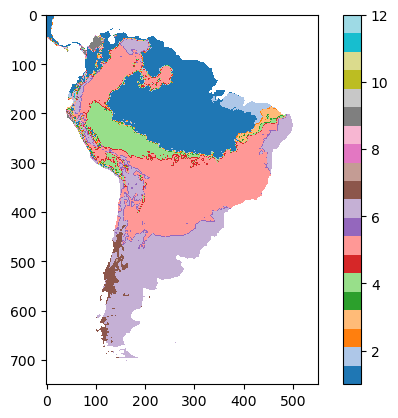

In [180]:
for var,var2 in zip(TrimMaisFrio.keys(), BIO11.keys()):
    TrimMaisFrio[var] = TrimMaisFrio[var].astype(float)
    TrimMaisFrio[var][np.isnan(BIO11[var2])]=np.nan
#display(resultArgTri)

plt.imshow(TrimMaisFrio["Trim_mais_Frio 2023"], cmap="tab20")
plt.colorbar()

In [187]:
TrimMaisFrio["Trim_mais_Frio 2023"]

array([[ 1.,  1.,  1., ..., nan, nan, nan],
       [ 1.,  1.,  1., ..., nan, nan, nan],
       [ 1.,  1.,  1., ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

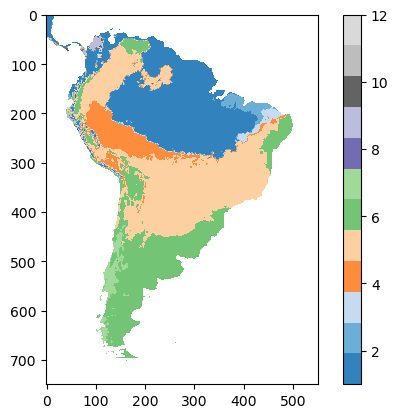

In [183]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Usando um colormap com 12 cores
cmap = plt.get_cmap("tab20c", 12)

# Exibindo a imagem
plt.imshow(TrimMaisFrio["Trim_mais_Frio 2023"], cmap=cmap)
plt.colorbar()
plt.show()


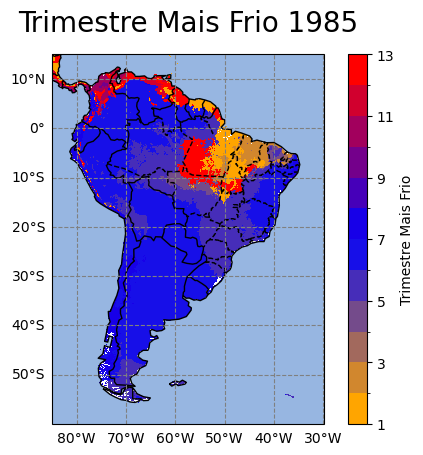

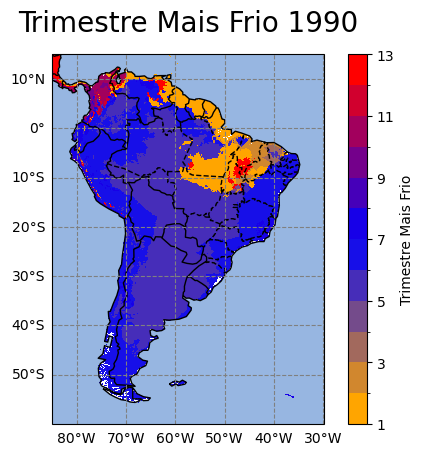

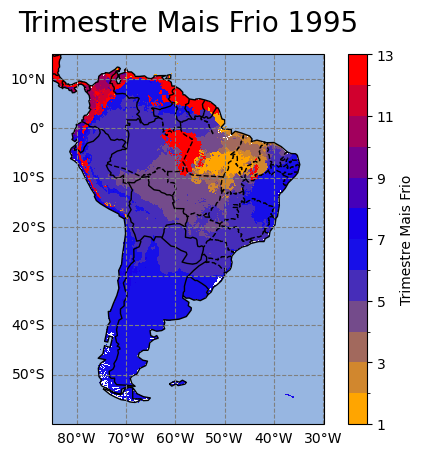

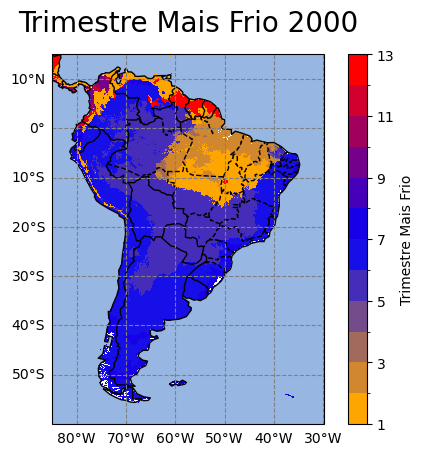

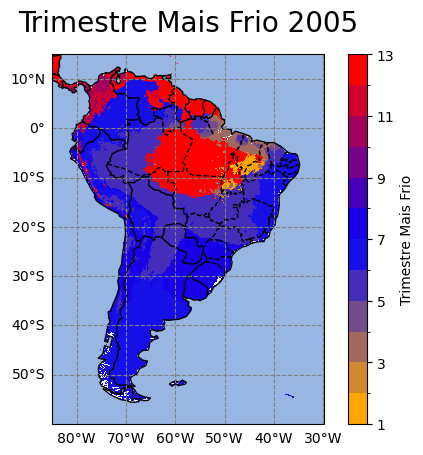

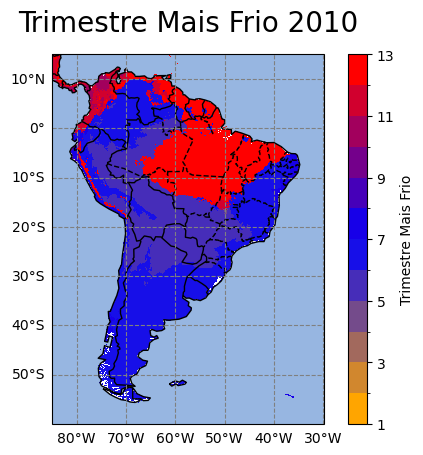

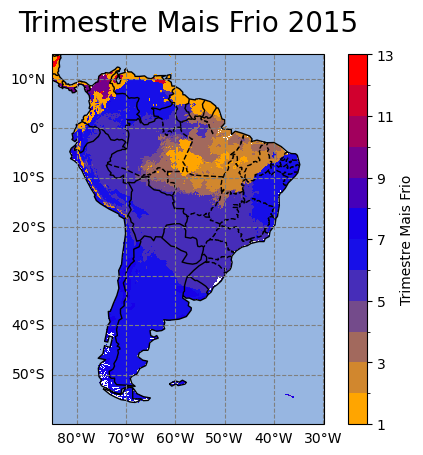

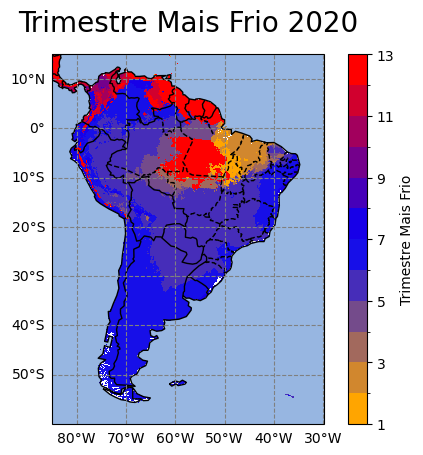

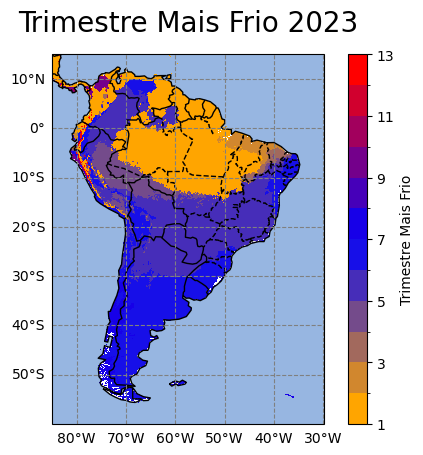

In [210]:
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from matplotlib.colors import LinearSegmentedColormap

colors = ['orange', 'blue', 'red']  # Azul, branco e vermelho
n_bins = 100  # Número de bins
cmap_name = 'orange_blue_red'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bins)
# Lista de anos para exibição
anos = list(range(1985, 2023, 5)) + [2023]

# Colormap com 12 cores
cmap = plt.get_cmap(cmap, 13)  # Usando o colormap 'tab20c' e limitando a 12 cores # Usando o colormap 'tab20c' e limitando a 12 cores

for ano in anos:
    # Extraindo o valor do trimestre mais frio
    var = f'Trim_mais_Frio {ano}'               
    Base = TrimMaisFrio[var]
    
    # Converter o numpy.ndarray para xarray.DataArray com as coordenadas geográficas (latitude, longitude)
    Base_xr = xr.DataArray(Base, dims=["lat", "lon"], coords={"lat": latitudes_unicas, "lon": longitudes_unicas})
    
    # Configurar o plot
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
    
    # Plotar o trimestre mais frio usando imshow
    Base_xr.plot(ax=ax, transform=ccrs.PlateCarree(), cmap=cmap, 
                 cbar_kwargs={'label': 'Trimestre Mais Frio'},
                 levels=np.arange(1, 14, 1))  # Definindo 12 níveis para os trimestres (1 a 12)
    
    # Adicionando o contorno dos continentes, países e estados do Brasil
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.OCEAN)
    
    # Adicionando os limites estaduais do Brasil
    states = cfeature.NaturalEarthFeature(category='cultural',
                                          name='admin_1_states_provinces_lines',
                                          scale='50m',
                                          facecolor='none')
    ax.add_feature(states, edgecolor='k', linestyle='--')
    
    # Adicionando título à figura
    ax.set_title(f"Trimestre Mais Frio {ano}", fontsize=20, y=1.04)
    
    # Adicionando as linhas de grade
    g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)
    
    # Formatando os labels como latitude e longitude
    g1.yformatter = LATITUDE_FORMATTER
    g1.xformatter = LONGITUDE_FORMATTER
    
    # Remover as grades superior e direita
    g1.ylabels_right = False  # Remove labels do eixo y à direita
    g1.right_labels = False  # Remove a linha de grade à direita
    g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas
    
    # Remove as linhas de grade no topo
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    g1.top_labels = False  # Remove a linha de grade no topo

    # Salvar e mostrar o gráfico
    plt.savefig(f"Mapas/Mapa_TrimMaisFrio_{ano}.png", dpi=300, bbox_inches='tight')
    plt.show()


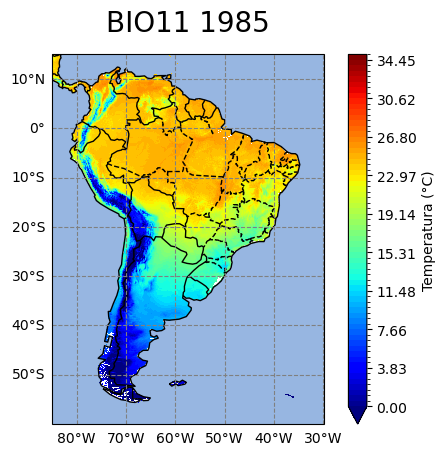

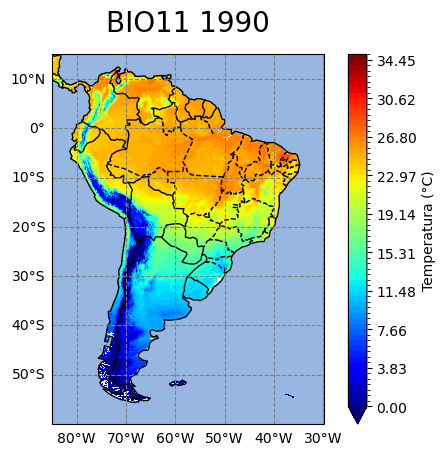

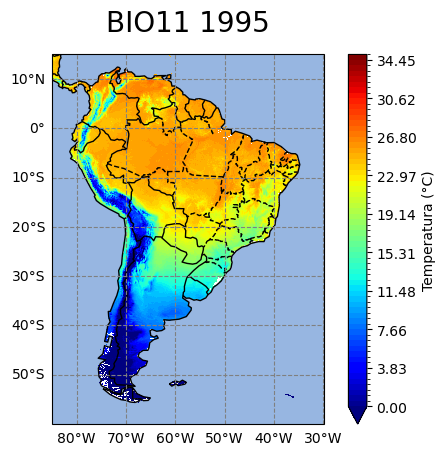

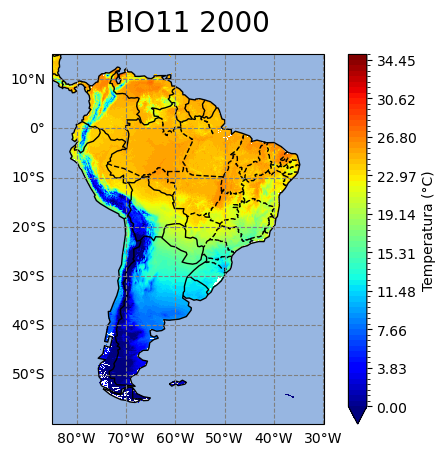

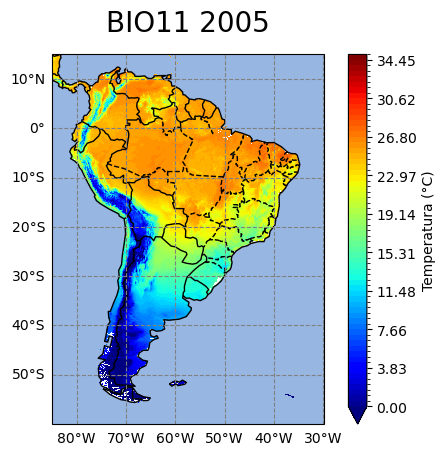

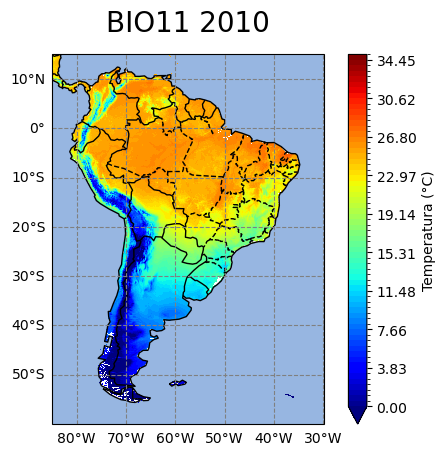

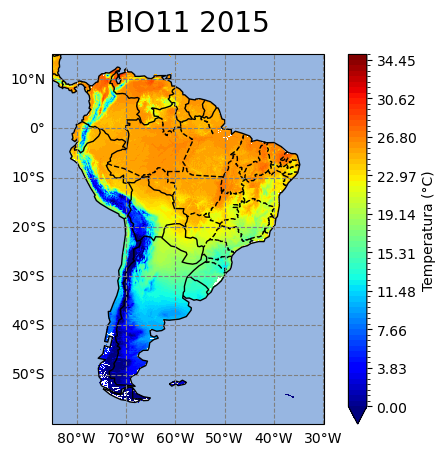

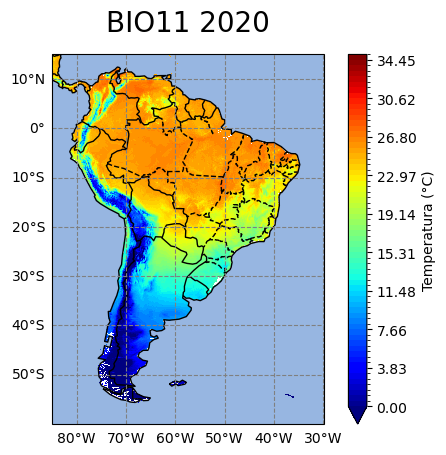

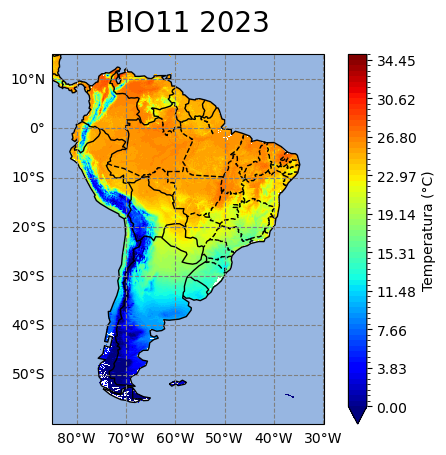

In [55]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO11 {ano}'               
    Base= BIO11[valor]
    max = 35
    min = 0
    FazMapa(Base,valor,max,min)

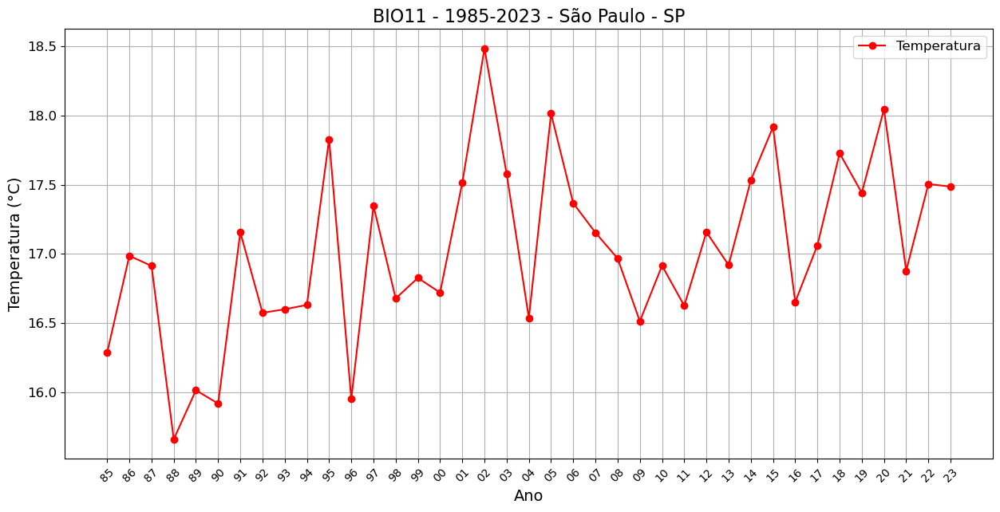

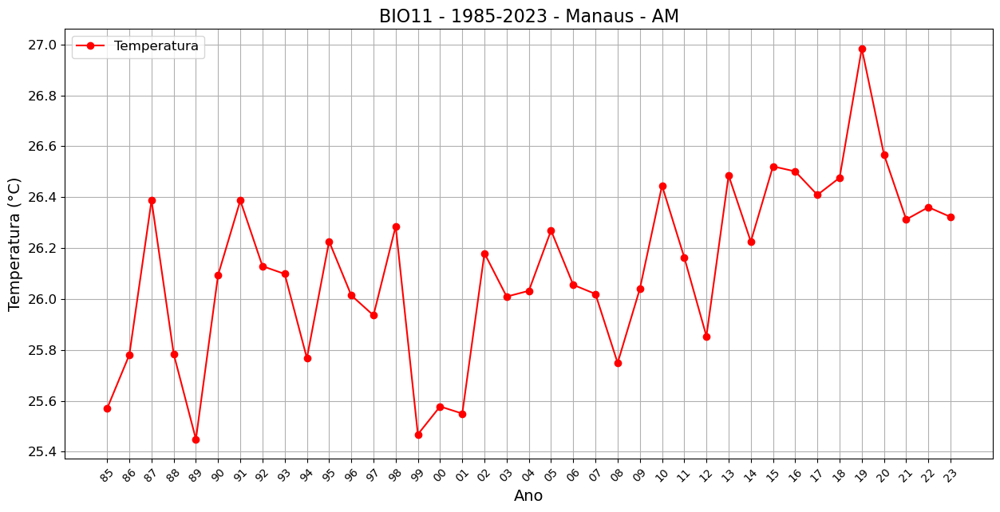

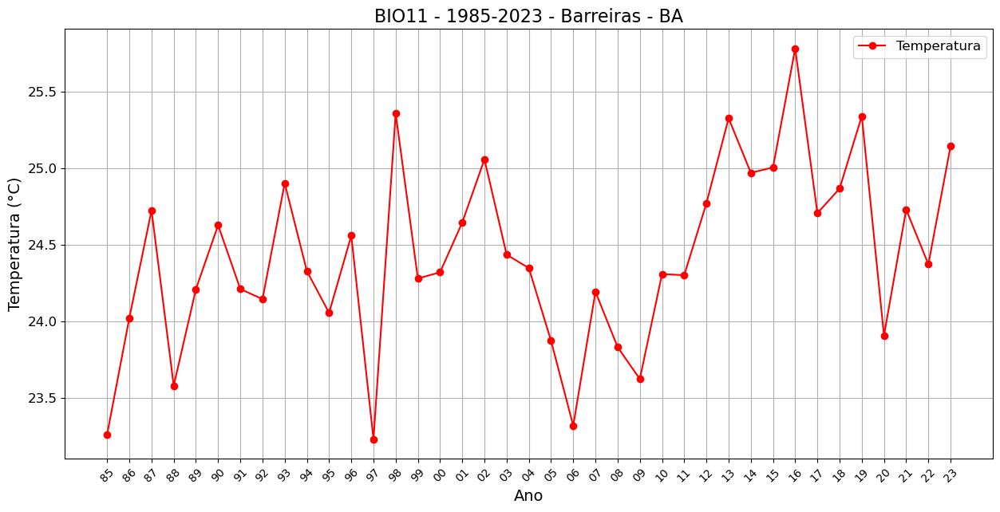

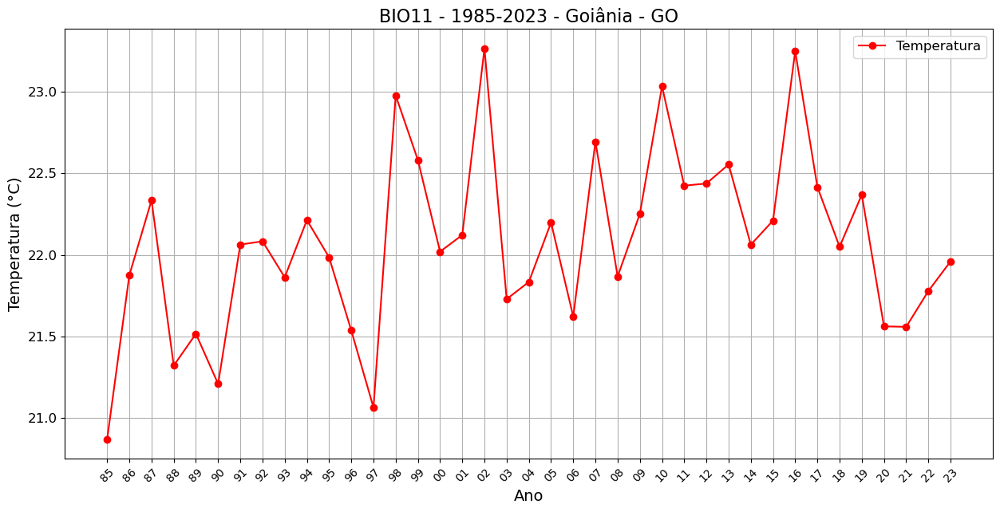

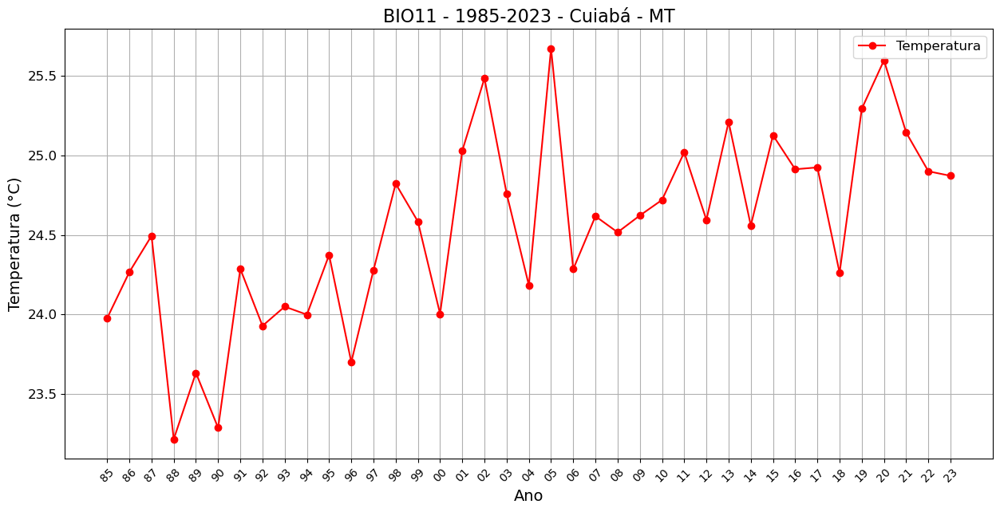

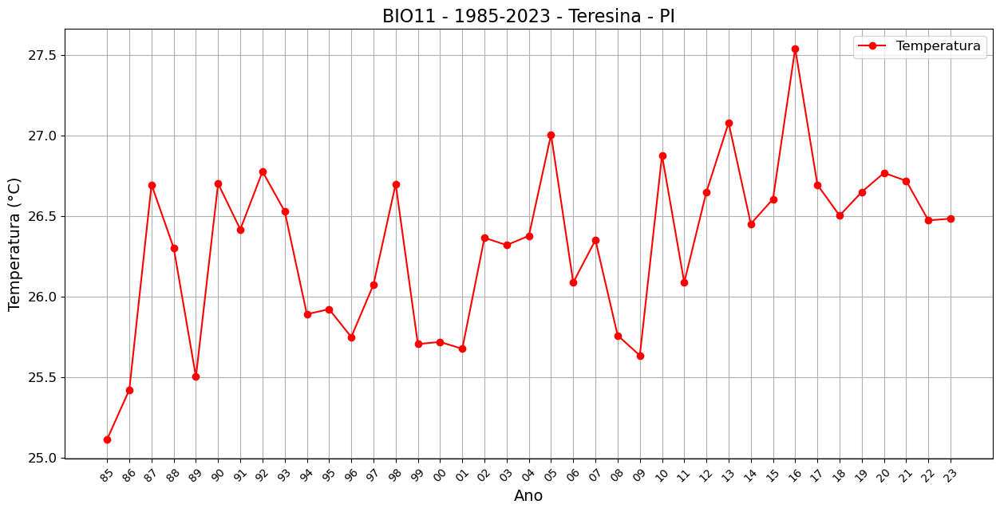

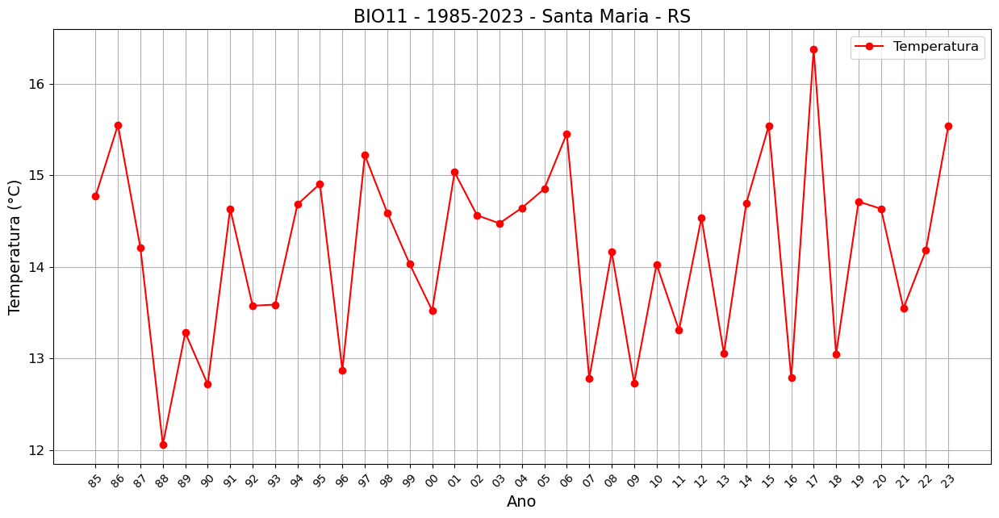

In [56]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO11
    Nome = 'BIO11'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# BIO 03
BIO 03 = Isothermality (BIO2/BIO7) (×00)

## Equação
![Equação_BIO_03](Equações/Equacao_BIO03.png)

In [57]:
import xarray as xr
import numpy as np
import pandas as pd

BIO03 = xr.Dataset()

for ano in range(tmin['time'].dt.year.min().values,tmin['time'].dt.year.max().values):
    
    BIO03 [f'BIO 03 {ano}'] = (BIO02[f'BIO 02 {ano}']/BIO07[f'BIO 07 {ano}'])*100


# Adicionando atributos
BIO03.attrs = {
    'title':'BIO 03 – Isotermalidade',
    'description':'A isotermalidade é geralmente útil para ambientes tropicais, ilhas e ambientes marítimos. A isotermalidade quantifica o quanto as temperaturas noturnas oscilam em relação as oscilações no verão e inverno (anuais). Um valor isotérmico de 100 indica que a faixa de temperatura diurna é equivalente à faixa de temperatura anual, enquanto qualquer coisa  menor de 100 indica um nível menor de variabilidade térmica dentro de um mês médio em relação ao ano. A distribuição de uma espécie pode ser influenciada por flutuações de temperatura maiores ou menores dentro de um mês em relação ao ano e este preditor é útil para averiguar tais informações.',
    'units': '°C',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'methodology': 'BIO 02 divido por BIO07, tendo o valor obtido sido multiplicado por 100.',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

display(BIO03)
BIO03.to_netcdf("Variaveis_BIOClimaticas/BIO_03_1985-2023.nc")

<xarray.Dataset> Size: 129MB
Dimensions:      (lat: 750, lon: 551)
Coordinates:
  * lat          (lat) float64 6kB 14.95 14.85 14.75 ... -59.75 -59.85 -59.95
  * lon          (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Data variables: (12/39)
    BIO 03 1985  (lat, lon) float64 3MB 58.33 58.47 58.47 59.32 ... nan nan nan
    BIO 03 1986  (lat, lon) float64 3MB 59.99 60.11 60.97 62.0 ... nan nan nan
    BIO 03 1987  (lat, lon) float64 3MB 61.47 61.19 61.06 61.35 ... nan nan nan
    BIO 03 1988  (lat, lon) float64 3MB 61.12 60.31 59.66 59.6 ... nan nan nan
    BIO 03 1989  (lat, lon) float64 3MB 65.4 64.99 64.52 64.23 ... nan nan nan
    BIO 03 1990  (lat, lon) float64 3MB 66.51 66.41 66.32 66.6 ... nan nan nan
    ...           ...
    BIO 03 2018  (lat, lon) float64 3MB 67.77 68.13 68.27 67.62 ... nan nan nan
    BIO 03 2019  (lat, lon) float64 3MB 65.81 65.88 66.42 65.99 ... nan nan nan
    BIO 03 2020  (lat, lon) float64 3MB 56.52 56.19 55.8 54.79 ... nan nan nan
    BIO 03 2021  (lat, lon) float64 3MB 66.68 65.93 64.94 65.52 ... nan nan nan
    BIO 03 2022  (lat, lon) float64 3MB 66.08 65.93 66.07 67.06 ... nan nan nan
    BIO 03 2023  (lat, lon) float64 3MB 56.43 56.17 56.07 57.02 ... nan nan nan
Attributes: (12/13)
    title:                BIO 03 – Isotermalidade
    description:          A isotermalidade é geralmente útil para ambientes t...
    units:                °C
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    ...                   ...
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    methodology:          BIO 02 divido por BIO07, tendo o valor obtido sido ...
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

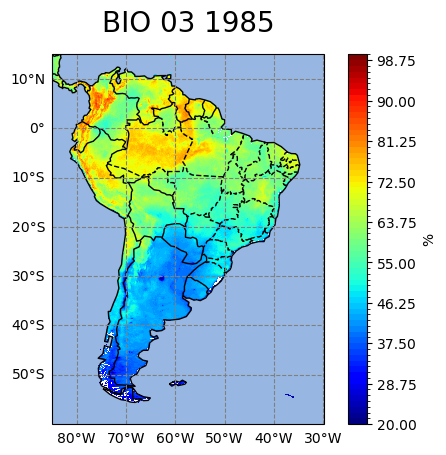

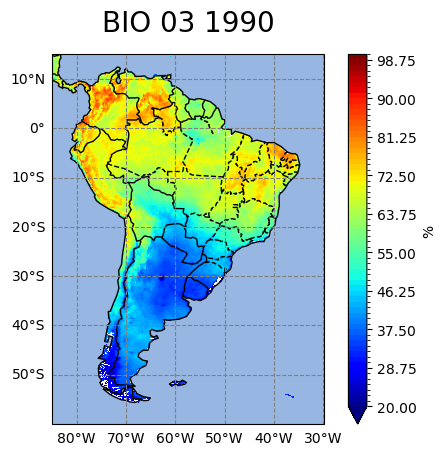

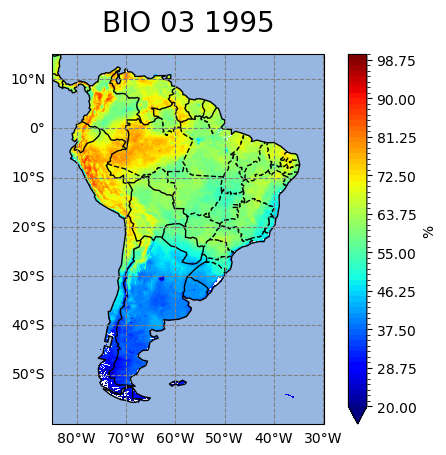

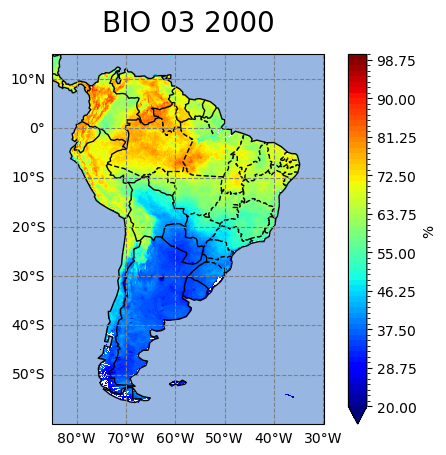

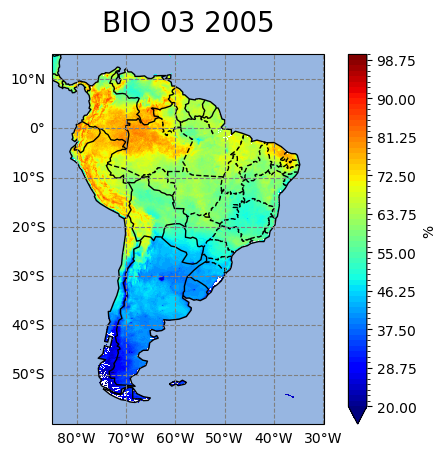

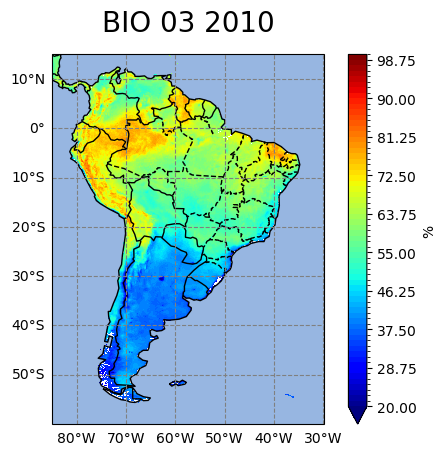

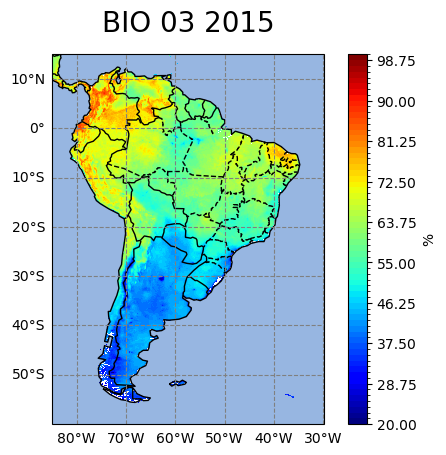

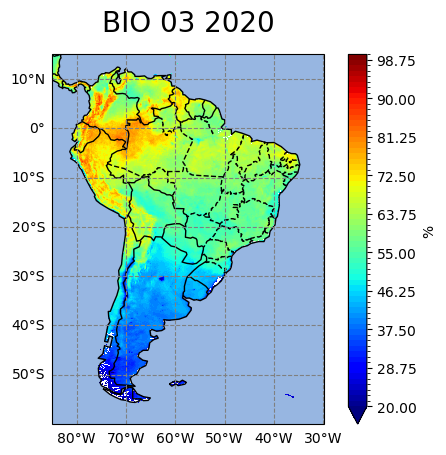

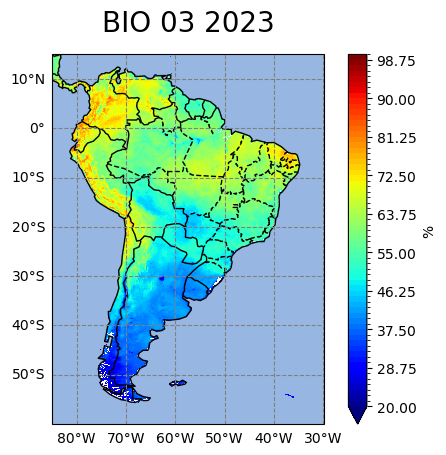

In [58]:
anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 03 {ano}'               
    Base= BIO03[valor]
    max = 100
    min = 20
    FazMapaperc(Base,valor,max,min)

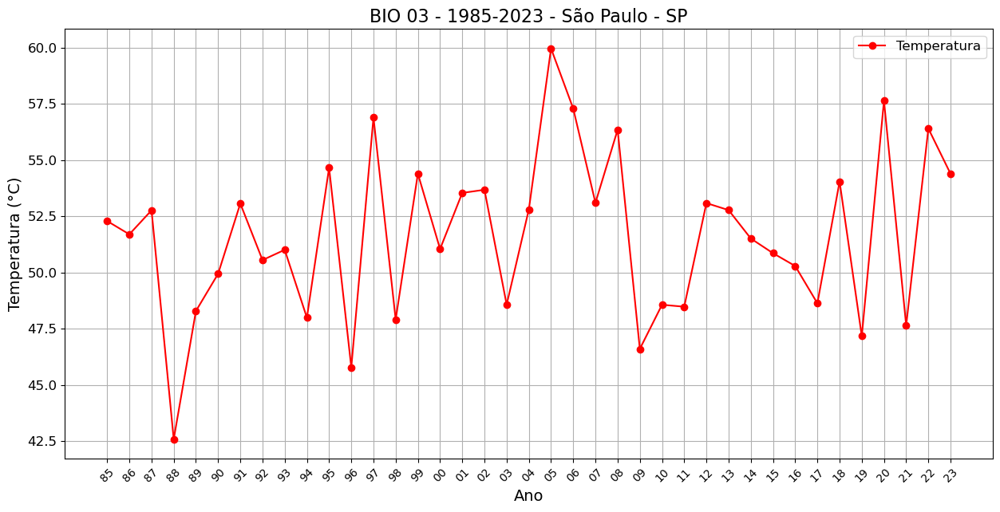

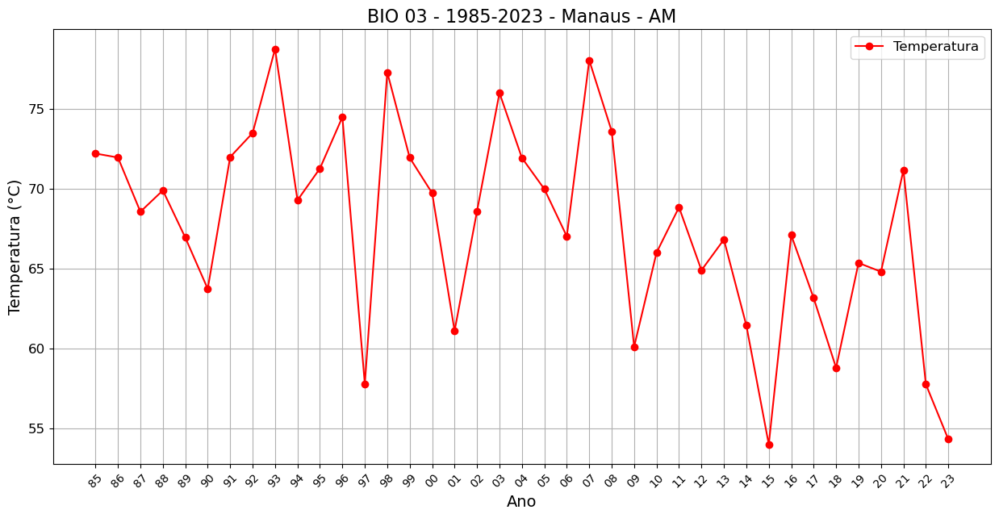

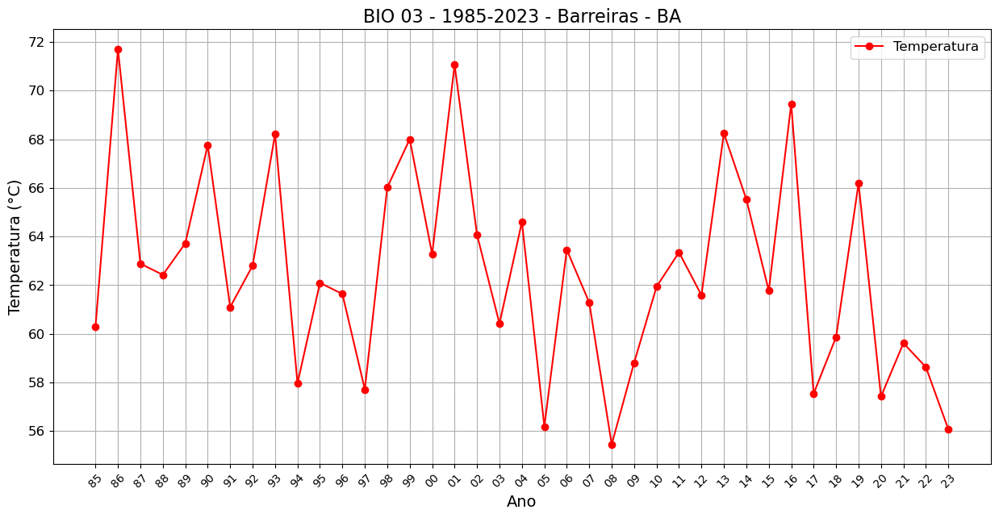

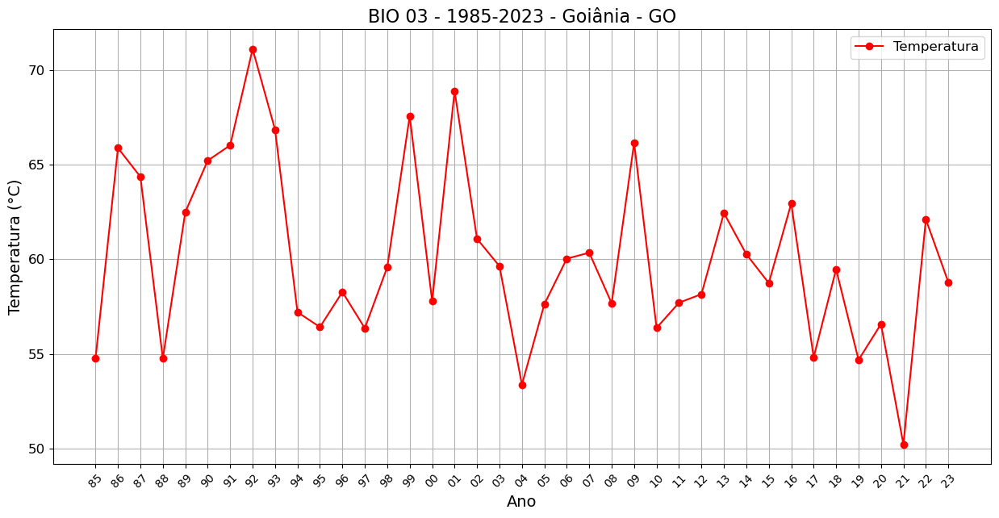

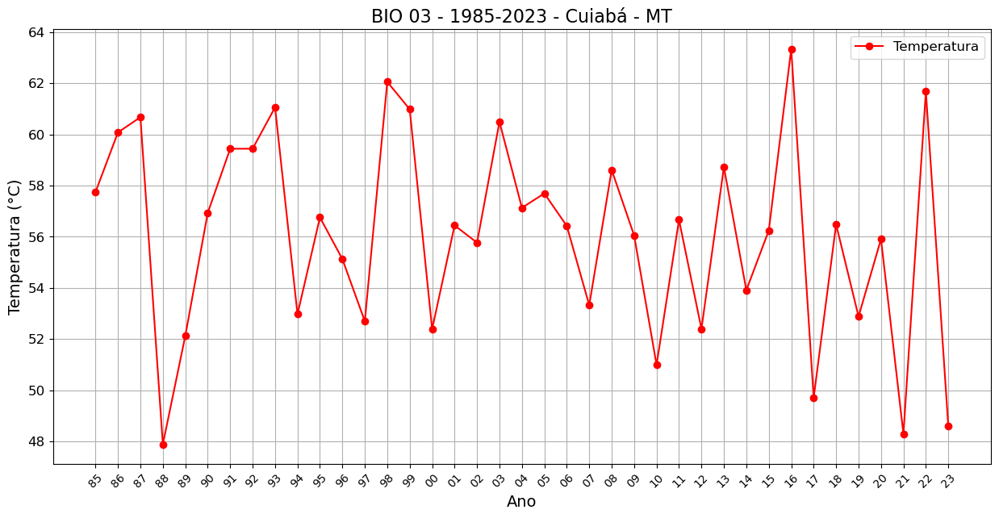

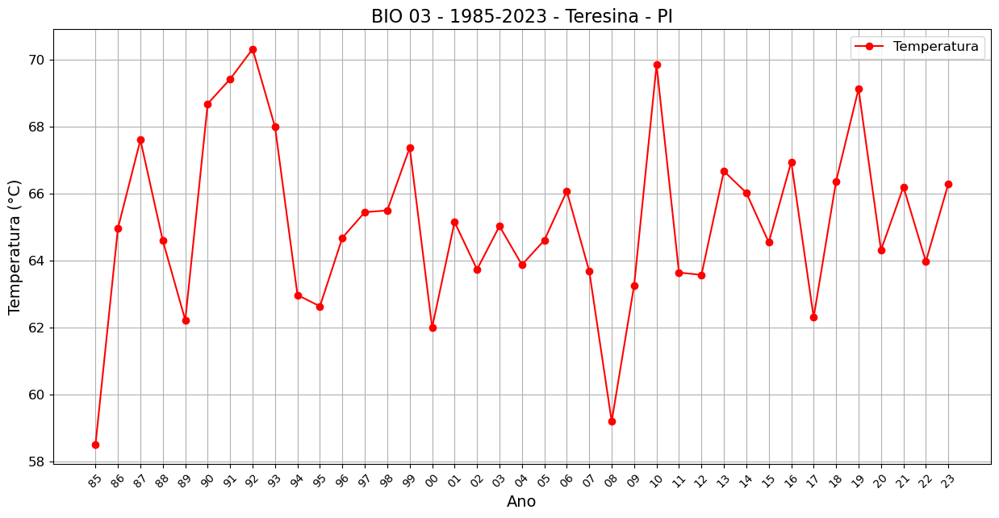

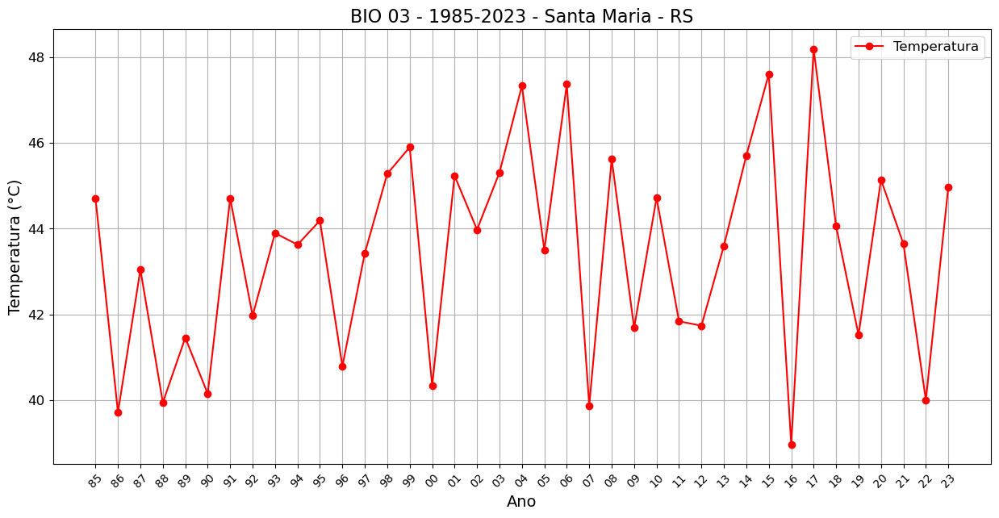

In [59]:
#Série Temporal Cidades Selecionadas
for i in range(0,len(df_cidades)):
    
    Dado = BIO03
    Nome = 'BIO 03'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]

    GraficoCidade(Dado,Nome,Cidade,latitude,longitude)

# SLOPE - Mann-Kendall

In [60]:
import xarray as xr
import numpy as np
import pandas as pd

BIO01_tempo = xr.Dataset()

# Calculando a média anual
BIO01_tempo = Tavgi.resample(time='YE').sum(skipna=False) 
BIO01_tempo

<xarray.DataArray (time: 40, lat: 750, lon: 551)> Size: 132MB
array([[[289.88662418, 287.39290889, 288.79985845, ...,          nan,
                  nan,          nan],
        [285.68463297, 286.22225124, 289.46010623, ...,          nan,
                  nan,          nan],
        [289.43228292, 293.02296231, 295.12924045, ...,          nan,
                  nan,          nan],
        ...,
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]],

       [[289.50647172, 287.38922474, 288.85518473, ...,          nan,
                  nan,          nan],
        [285.36231156, 286.25267978, 289.53279605, ...,          nan,
                  nan,          nan],
        [289.15138703, 293.04626812, 295.27888652, ...,          nan,
                  nan,          nan],
...
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]],

       [[ 47.80045997,  47.72790559,  48.4103724 , ...,          nan,
                  nan,          nan],
        [ 47.4115853 ,  47.84970563,  48.11250699, ...,          nan,
                  nan,          nan],
        [ 48.46295165,  48.84142304,  48.7058033 , ...,          nan,
                  nan,          nan],
        ...,
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]]])
Coordinates:
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
  * time     (time) datetime64[ns] 320B 1985-12-31 1986-12-31 ... 2024-12-31
Attributes:
    description:  Média entre as temperaturas máximas e mínimas mensais
    units:        °C
    source:       ERA-5 Land
    year:         1985 - 2023

In [61]:
import xarray as xr

# Supondo que BIO01_tempo seja um DataArray ou variável em um Dataset
BIO01_médmov = BIO01_tempo.rolling(time=3, center=True).mean()  # 'time' deve ser a coordenada do eixo temporal

# Excluir os anos de 1985 e 2024
BIO01_médmov = BIO01_médmov.sel(time=~BIO01_médmov.time.dt.year.isin([1985, 2024]))

# Exibir o resultado da média móvel
BIO01_médmov

<xarray.DataArray (time: 38, lat: 750, lon: 551)> Size: 126MB
array([[[292.79780117, 290.68847053, 292.06285516, ...,          nan,
                  nan,          nan],
        [288.56760139, 289.42076072, 292.6809373 , ...,          nan,
                  nan,          nan],
        [292.3473854 , 296.13355476, 298.32980901, ...,          nan,
                  nan,          nan],
        ...,
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]],

       [[295.14058776, 293.1968093 , 294.5172257 , ...,          nan,
                  nan,          nan],
        [290.80416711, 291.8130134 , 295.05964044, ...,          nan,
                  nan,          nan],
        [294.46040426, 298.35986395, 300.61848092, ...,          nan,
                  nan,          nan],
...
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]],

       [[216.77404999, 215.01724852, 216.11633918, ...,          nan,
                  nan,          nan],
        [213.18515097, 214.19906018, 216.57691965, ...,          nan,
                  nan,          nan],
        [215.74511862, 219.11631571, 220.49288612, ...,          nan,
                  nan,          nan],
        ...,
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]]])
Coordinates:
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
  * time     (time) datetime64[ns] 304B 1986-12-31 1987-12-31 ... 2023-12-31
Attributes:
    description:  Média entre as temperaturas máximas e mínimas mensais
    units:        °C
    source:       ERA-5 Land
    year:         1985 - 2023

In [62]:
BIO01_médmov

<xarray.DataArray (time: 38, lat: 750, lon: 551)> Size: 126MB
array([[[292.79780117, 290.68847053, 292.06285516, ...,          nan,
                  nan,          nan],
        [288.56760139, 289.42076072, 292.6809373 , ...,          nan,
                  nan,          nan],
        [292.3473854 , 296.13355476, 298.32980901, ...,          nan,
                  nan,          nan],
        ...,
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]],

       [[295.14058776, 293.1968093 , 294.5172257 , ...,          nan,
                  nan,          nan],
        [290.80416711, 291.8130134 , 295.05964044, ...,          nan,
                  nan,          nan],
        [294.46040426, 298.35986395, 300.61848092, ...,          nan,
                  nan,          nan],
...
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]],

       [[216.77404999, 215.01724852, 216.11633918, ...,          nan,
                  nan,          nan],
        [213.18515097, 214.19906018, 216.57691965, ...,          nan,
                  nan,          nan],
        [215.74511862, 219.11631571, 220.49288612, ...,          nan,
                  nan,          nan],
        ...,
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]]])
Coordinates:
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
  * time     (time) datetime64[ns] 304B 1986-12-31 1987-12-31 ... 2023-12-31
Attributes:
    description:  Média entre as temperaturas máximas e mínimas mensais
    units:        °C
    source:       ERA-5 Land
    year:         1985 - 2023

In [63]:
import xarray as xr
import numpy as np
import pymannkendall as mk


# Extrair o DataArray de temperatura (vamos supor que é chamado de 't2m' no arquivo)
t2m_data = BIO01_médmov

# Criar listas para armazenar resultados
trend = np.full((len(t2m_data['lat']), len(t2m_data['lon'])), np.nan)
p_value = np.full((len(t2m_data['lat']), len(t2m_data['lon'])), np.nan)
slope = np.full((len(t2m_data['lat']), len(t2m_data['lon'])), np.nan)

# Aplicar o teste de Mann-Kendall para cada ponto de grade
for i, lat in enumerate(t2m_data['lat']):
    for j, lon in enumerate(t2m_data['lon']):
        # Extrair a série temporal para o ponto (lat, lon)
        series = t2m_data.sel(lat=lat, lon=lon).dropna(dim='time')
        
        # Verificar se há dados suficientes para o teste (mínimo de 10 pontos, por exemplo)
        if len(series['time']) >= 10:
            result = mk.original_test(series.values)
            trend[i, j] = 1 if result.trend == 'increasing' else -1 if result.trend == 'decreasing' else 0
            p_value[i, j] = result.p
            slope[i, j] = result.slope
# Criar um Dataset com os resultados
result_ds = xr.Dataset(
    {
        'trend': (['lat', 'long'], trend),
        'p_value': (['lat', 'long'], p_value),
        'slope': (['lat', 'lon'], slope)
    },
    coords={
        'lat': t2m_data.lat,
        'lon': t2m_data.lon
    }
)
# Salvar o resultado como um arquivo NetCDF
output_path = 'Variaveis_BIOClimaticas/mann_kendall_results.nc'
result_ds.to_netcdf(output_path)

print(f"Arquivo de resultados salvo em: {output_path}")
result_ds

Arquivo de resultados salvo em: Variaveis_BIOClimaticas/mann_kendall_results.nc


<xarray.Dataset> Size: 10MB
Dimensions:  (lat: 750, long: 551, lon: 551)
Coordinates:
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Dimensions without coordinates: long
Data variables:
    trend    (lat, long) float64 3MB 1.0 1.0 1.0 1.0 1.0 ... nan nan nan nan nan
    p_value  (lat, long) float64 3MB 0.0002938 0.0004741 0.0006272 ... nan nan
    slope    (lat, lon) float64 3MB 0.1294 0.113 0.1124 0.1173 ... nan nan nan

In [64]:
# Criar um Dataset com os resultados
result_ds = xr.Dataset(
    {
        'trend': (['lat', 'long'], trend),
        'p_value': (['lat', 'long'], p_value),
        'slope': (['lat', 'lon'], slope)
    },
    coords={
        'lat': t2m_data.lat,
        'lon': t2m_data.lon
    }
)
# Salvar o resultado como um arquivo NetCDF
output_path = 'Variaveis_BIOClimaticas/mann_kendall_results.nc'
result_ds.to_netcdf(output_path)

print(f"Arquivo de resultados salvo em: {output_path}")
result_ds

Arquivo de resultados salvo em: Variaveis_BIOClimaticas/mann_kendall_results.nc


<xarray.Dataset> Size: 10MB
Dimensions:  (lat: 750, long: 551, lon: 551)
Coordinates:
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
Dimensions without coordinates: long
Data variables:
    trend    (lat, long) float64 3MB 1.0 1.0 1.0 1.0 1.0 ... nan nan nan nan nan
    p_value  (lat, long) float64 3MB 0.0002938 0.0004741 0.0006272 ... nan nan
    slope    (lat, lon) float64 3MB 0.1294 0.113 0.1124 0.1173 ... nan nan nan

In [65]:
import xarray as xr
import numpy as np

# Criar um Dataset com os resultados
result_ds = xr.Dataset(
    {
        'trend': (['lat', 'lon'], trend),
        'p_value': (['lat', 'lon'], p_value),
        'slope': (['lat', 'lon'], slope)
    },
    coords={
        'lat': t2m_data.lat,
        'lon': t2m_data.lon
    }
)

# Aplicar as alterações: multiplicar 'slope' por 10 e substituir valores de slope por NaN onde p_value > 0,05
slope_corrigido = xr.where((p_value <= 0.05) | slope.isnull(), slope * 10, np.nan)

# Criar um novo Dataset com o slope corrigido e o p_value original
resultado_ds_corrigido = xr.Dataset(
    {
        'slope_corrigido': (['lat', 'lon'], slope_corrigido),
        'p_value': (['lat', 'lon'], p_value)
    },
    coords={
        'lat': t2m_data.lat,
        'lon': t2m_data.lon
    }
)

# Salvar o resultado corrigido como um arquivo NetCDF
output_path_corrigido = 'Variaveis_BIOClimaticas/mann_kendall_results_corrigido.nc'
resultado_ds_corrigido.to_netcdf(output_path_corrigido)

print(f"Arquivo corrigido salvo em: {output_path_corrigido}")


AttributeError: 'numpy.ndarray' object has no attribute 'isnull'

In [67]:
import xarray as xr
import numpy as np

# Criar um Dataset com os resultados
result_ds = xr.Dataset(
    {
        'trend': (['lat', 'lon'], trend),
        'p_value': (['lat', 'lon'], p_value),
        'slope': (['lat', 'lon'], slope)
    },
    coords={
        'lat': t2m_data.lat,
        'lon': t2m_data.lon
    }
)

# Aplicar as alterações: multiplicar 'slope' por 10 e substituir valores de slope por NaN onde p_value > 0,05
slope_corrigido = xr.where((p_value <= 0.05) | slope.isnull(), slope * 10, 0)

# Criar um novo Dataset com o slope corrigido e o p_value original
resultado_ds_corrigido = xr.Dataset(
    {
        'slope_corrigido': (['lat', 'lon'], slope_corrigido),
        'p_value': (['lat', 'lon'], p_value)
    },
    coords={
        'lat': t2m_data.lat,
        'lon': t2m_data.lon
    }
)

# Salvar o resultado corrigido como um arquivo NetCDF
output_path_corrigido = 'Variaveis_BIOClimaticas/mann_kendall_results_corrigido.nc'
resultado_ds_corrigido.to_netcdf(output_path_corrigido)

print(f"Arquivo corrigido salvo em: {output_path_corrigido}")


AttributeError: 'numpy.ndarray' object has no attribute 'isnull'

In [98]:
import xarray as xr

# Carregar o arquivo NetCDF com os dados de resultado do Mann-Kendall
dataset = result_ds

# Acessar os DataArrays de interesse
slope = dataset['slope']
p_value = dataset['p_value']

# Aplicar a condição: onde p_value for maior que 0,05, transformar o valor de slope em zero
slope_corrigido = xr.where((p_value <= 0.05) | slope.isnull(), slope, np.nan)
#slope_corrigido*=10
# Criar um novo Dataset com o slope corrigido e o p_value original
resultado_ds_corrigido = xr.Dataset(
    {
        "slope_corrigido": slope_corrigido,
        "p_value": p_value},
    coords={
        'lat': t2m_data.lat,
        'lon': t2m_data.lon,
    }
)

# Adicionando atributos
resultado_ds_corrigido.attrs = {
    'title':'Slope – Tendência da Temperatura',
    'description':'Calculado a partir de BIO 01 - Temperatura média Anual pela média flutuante de 3 anos consecutivos. O valor do slope foi multiplicado por dez para acompanhar a inclinação por década e por fim os valores sem relação estatística relevante foram excluidos.',
    'units': '°C/decada',
    'source': 'ERA-5 Land - Centro Europeu de Previsões Meteorológicas de Médio Prazo (ECMWF)',
    'institution': 'IFUSP',
    'creator': 'Arthur Thomas Luz, Orientadores: Profa. Dra. Luciana Rizzo, Dr.Felipe Silva, Prof. Dr. Luiz Augusto Toledo Machado ', 
    'year': '1985 - 2023',
    'geospatial_bounds': 'Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°',
    'spatial_resolution': '0.1° x 0.1°',
    'temporal_resolution': 'Anual',
    'history': 'Criado em 05/12/2024 com base nos dados ERA-5 Land baixados pela Earth Engine',
    'references': 'https://pubs.usgs.gov/ds/691/ds691.pdf'
}

# Salvar o resultado em um novo arquivo NetCDF
output_path = "Variaveis_BIOClimaticas/resultado_Mann_Kendall_corrigido.nc"
resultado_ds_corrigido.to_netcdf(output_path)

print(f"Arquivo corrigido salvo em {output_path}")
resultado_ds_corrigido

Arquivo corrigido salvo em Variaveis_BIOClimaticas/resultado_Mann_Kendall_corrigido.nc


<xarray.Dataset> Size: 7MB
Dimensions:          (lat: 750, lon: 551)
Coordinates:
  * lat              (lat) float64 6kB 14.95 14.85 14.75 ... -59.85 -59.95
  * lon              (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.05 -29.95
Data variables:
    slope_corrigido  (lat, lon) float64 3MB 0.1294 0.113 0.1124 ... nan nan nan
    p_value          (lat, lon) float64 3MB 0.0002938 0.0004741 ... nan nan
Attributes:
    title:                Slope – Tendência da Temperatura
    description:          Calculado a partir de BIO 01 - Temperatura média An...
    units:                °C/decada
    source:               ERA-5 Land - Centro Europeu de Previsões Meteorológ...
    institution:          IFUSP
    creator:              Arthur Thomas Luz, Orientadores: Profa. Dra. Lucian...
    year:                 1985 - 2023
    geospatial_bounds:    Oeste: -85°, Sul: -60°, Leste: -30°, Norte: 15°
    spatial_resolution:   0.1° x 0.1°
    temporal_resolution:  Anual
    history:              Criado em 05/12/2024 com base nos dados ERA-5 Land ...
    references:           https://pubs.usgs.gov/ds/691/ds691.pdf

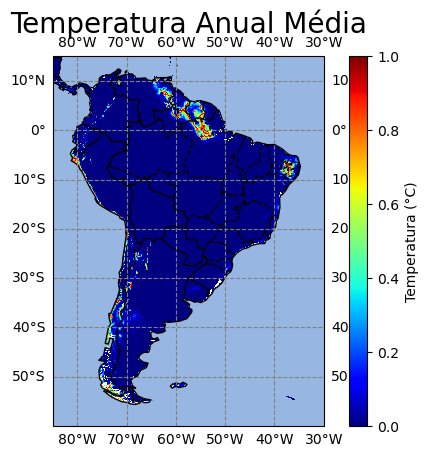

In [90]:
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs  # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

# Garantir que o 'valor' tenha um valor atribuído antes de ser usado no título
valor = "Temperatura Anual Média"  # Exemplo de título

# Configurar o plot
fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})

# Plotar a média da temperatura (slope_corrigido deve ser um DataArray do xarray)
Base = result_ds['p_value']  # Substitua com seu DataArray real

# Plotando a variável com colormap e colorbar
Base.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='jet', 
          cbar_kwargs={'label': 'Temperatura (°C)'})

# Adicionando o contorno dos continentes, países e estados do Brasil
ax.add_feature(cfeature.COASTLINE)  # Contorno dos continentes
ax.add_feature(cfeature.BORDERS)  # Limites dos países
ax.add_feature(cfeature.OCEAN)  # Oceano

# Adicionando os limites estaduais
states = cfeature.NaturalEarthFeature(category='cultural',
                                      name='admin_1_states_provinces_lines',
                                      scale='50m', facecolor='none')
ax.add_feature(states, edgecolor='k', linestyle='--')

# Adicionando título à figura
ax.set_title(valor, fontsize=20, y=1.04)

# Adicionando as linhas de grade
g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)

# Formatando os labels como latitude e longitude
g1.yformatter = LATITUDE_FORMATTER
g1.xformatter = LONGITUDE_FORMATTER

# Remover as linhas de grade à direita e no topo
g1.ylabels_right = False  # Remove labels do eixo y à direita
g1.xlabels_top = False  # Remove labels do eixo x no topo

# Exibindo o gráfico
plt.show()


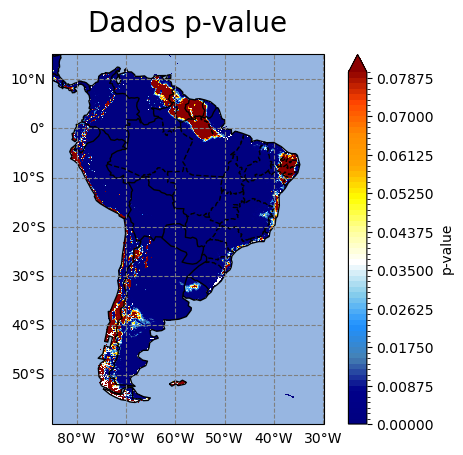

In [97]:
#Criando Mapa de Temperatura Anual média
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

# Configurar o plot
fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})

from matplotlib.colors import LinearSegmentedColormap

# Definir cores para o colormap
colors = ['#000080','#00008B','#4682B4','#1E90FF','#87CEEB','white',"#FFFF99","#FFFF00","#FFA500","#FF8C00","#FF4500","#8B0000"]
# Criar o colormap
cmap = LinearSegmentedColormap.from_list("blue_white_red", colors)

# Plotar a média da temperatura
(result_ds['p_value']).plot(ax=ax, transform=ccrs.PlateCarree(), cmap=cmap,levels=np.linspace(0, 0.08, 65), cbar_kwargs={'label': 'p-value'})
#levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 


#Adicionando o contorno dos continentes, países e estados do Brasil
#Adicionando o contorno dos continentes
ax.add_feature(cfeature.COASTLINE)

#Adicionando os limites dos países
ax.add_feature(cfeature.BORDERS)

#Adicionando o oceano
ax.add_feature(cfeature.OCEAN)

#Adicionando os limites estaduais
states = cfeature.NaturalEarthFeature(category='cultural',
                                      name='admin_1_states_provinces_lines',
                                      scale='50m',
                                      facecolor='none')
ax.add_feature(states, edgecolor='k', linestyle='--')

#Adicionando título a figura 
ax.set_title(f'Dados p-value', fontsize=20, y=1.04)

#Adicionando as linhas de grade
g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)

#Formatando os labels como latitude e longitude
g1.yformatter = LATITUDE_FORMATTER
g1.xformatter = LONGITUDE_FORMATTER

#agora irei tirar as grades  superior e direita
# Remove as linhas de grade à direita
g1.ylabels_right = False  # Remove labels do eixo y à direita
g1.right_labels = False  # Remove a linha de grade à direita
g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas

# Remove as linhas de grade no topo (se necessário)
g1.xlabels_top = False  # Remove labels do eixo x no topo

# Remove as linhas de grade no topo (se necessário)
g1.xlabels_top = False  # Remove labels do eixo x no topo
g1.top_labels = False  # Remove a linha de grade no topo

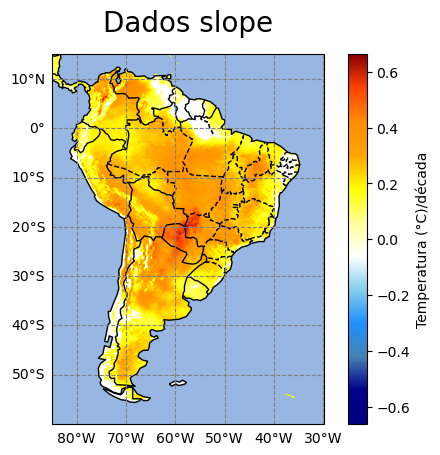

In [99]:
#Criando Mapa de Temperatura Anual média
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

# Configurar o plot
fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})

from matplotlib.colors import LinearSegmentedColormap

# Definir cores para o colormap
colors = ['#000080','#00008B','#4682B4','#1E90FF','#87CEEB','white',"#FFFF99","#FFFF00","#FFA500","#FF8C00","#FF4500","#8B0000"]
# Criar o colormap
cmap = LinearSegmentedColormap.from_list("blue_white_red", colors)

# Plotar a média da temperatura
(resultado_ds_corrigido['slope_corrigido']).plot(ax=ax, transform=ccrs.PlateCarree(), cmap=cmap, cbar_kwargs={'label': 'Temperatura (°C)/década'})
#levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 


#Adicionando o contorno dos continentes, países e estados do Brasil
#Adicionando o contorno dos continentes
ax.add_feature(cfeature.COASTLINE)

#Adicionando os limites dos países
ax.add_feature(cfeature.BORDERS)

#Adicionando o oceano
ax.add_feature(cfeature.OCEAN)

#Adicionando os limites estaduais
states = cfeature.NaturalEarthFeature(category='cultural',
                                      name='admin_1_states_provinces_lines',
                                      scale='50m',
                                      facecolor='none')
ax.add_feature(states, edgecolor='k', linestyle='--')

#Adicionando título a figura 
ax.set_title(f'Dados slope', fontsize=20, y=1.04)

#Adicionando as linhas de grade
g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)

#Formatando os labels como latitude e longitude
g1.yformatter = LATITUDE_FORMATTER
g1.xformatter = LONGITUDE_FORMATTER

#agora irei tirar as grades  superior e direita
# Remove as linhas de grade à direita
g1.ylabels_right = False  # Remove labels do eixo y à direita
g1.right_labels = False  # Remove a linha de grade à direita
g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas

# Remove as linhas de grade no topo (se necessário)
g1.xlabels_top = False  # Remove labels do eixo x no topo

# Remove as linhas de grade no topo (se necessário)
g1.xlabels_top = False  # Remove labels do eixo x no topo
g1.top_labels = False  # Remove a linha de grade no topo

ValueError: not enough values to unpack (expected 2, got 0)

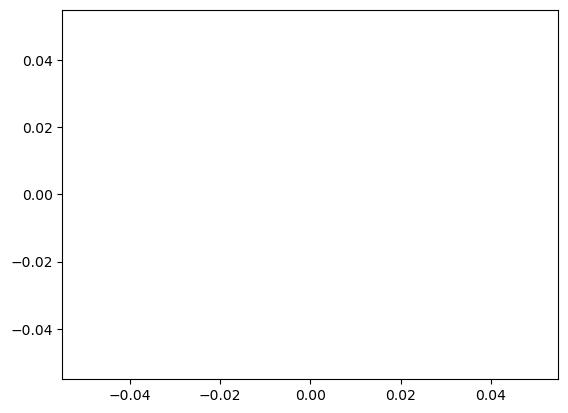

In [88]:
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs  # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

# Garantir que o 'valor' tenha um valor atribuído antes de ser usado no título
valor = "Temperatura Anual Média"  # Exemplo de título

# Configurar o plot
fig, ax = plt.plot(subplot_kw={'projection': ccrs.PlateCarree()})

# Extraindo a variável 'slope_corrigido' do DataArray
Base = resultado_ds_corrigido['slope_corrigido']  # Substitua com seu DataArray real

# Plotando com imshow
im = ax.imshow(Base.values, transform=ccrs.PlateCarree(), cmap='jet', origin='lower')

# Adicionando colorbar
cbar = fig.colorbar(im, ax=ax, orientation='vertical')
cbar.set_label('Temperatura (°C)')

# Adicionando o contorno dos continentes, países e estados do Brasil
ax.add_feature(cfeature.COASTLINE)  # Contorno dos continentes
ax.add_feature(cfeature.BORDERS)  # Limites dos países
ax.add_feature(cfeature.OCEAN)  # Oceano

# Adicionando os limites estaduais
states = cfeature.NaturalEarthFeature(category='cultural',
                                      name='admin_1_states_provinces_lines',
                                      scale='50m', facecolor='none')
ax.add_feature(states, edgecolor='k', linestyle='--')

# Adicionando título à figura
ax.set_title(valor, fontsize=20, y=1.04)

# Adicionando as linhas de grade
g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)

# Formatando os labels como latitude e longitude
g1.yformatter = LATITUDE_FORMATTER
g1.xformatter = LONGITUDE_FORMATTER

# Remover as linhas de grade à direita e no topo
g1.ylabels_right = False  # Remove labels do eixo y à direita
g1.xlabels_top = False  # Remove labels do eixo x no topo

# Exibindo o gráfico
plt.show()


ValueError: Dimensions {'time'} do not exist. Expected one or more of ('lat', 'lon')

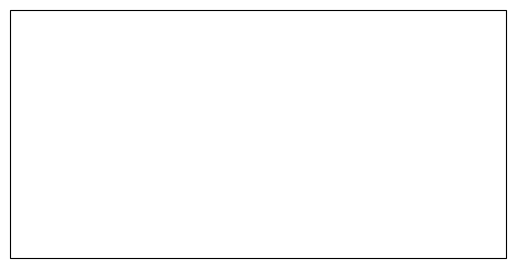

In [72]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs  # Escolha do sistema de coordenadas
import cartopy.feature as cfeature

# Garantir que o 'valor' tenha um valor atribuído antes de ser usado no título
valor = "Temperatura Anual Média"  # Exemplo de título

# Configurar o plot
fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})

# Selecionando a primeira fatia temporal
Base_fatia = resultado_ds_corrigido['slope_corrigido'].isel(time=0)  # Pegando a primeira fatia

# Plotando com imshow
im = ax.imshow(Base_fatia.values, transform=ccrs.PlateCarree(), cmap='jet', origin='lower')

# Adicionando colorbar
cbar = fig.colorbar(im, ax=ax, orientation='vertical')
cbar.set_label('Temperatura (°C)')

# Adicionando o contorno dos continentes, países e estados do Brasil
ax.add_feature(cfeature.COASTLINE)  # Contorno dos continentes
ax.add_feature(cfeature.BORDERS)  # Limites dos países
ax.add_feature(cfeature.OCEAN)  # Oceano

# Adicionando os limites estaduais
states = cfeature.NaturalEarthFeature(category='cultural',
                                      name='admin_1_states_provinces_lines',
                                      scale='50m', facecolor='none')
ax.add_feature(states, edgecolor='k', linestyle='--')

# Adicionando título à figura
ax.set_title(valor, fontsize=20, y=1.04)

# Adicionando as linhas de grade
g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)

# Formatando os labels como latitude e longitude
g1.yformatter = LATITUDE_FORMATTER
g1.xformatter = LONGITUDE_FORMATTER

# Remover as linhas de grade à direita e no topo
g1.ylabels_right = False  # Remove labels do eixo y à direita
g1.xlabels_top = False  # Remove labels do eixo x no topo

# Exibindo o gráfico
plt.show()


In [73]:
import xarray as xr
import pymannkendall as mk
import numpy as np

# Carregar o arquivo NetCDF com a série temporal de temperatura
ds = BIO01_médmov

# Extrair a variável de temperatura média
temperatura = ds

# Configurar arrays vazios para armazenar os resultados
h = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=object)
trend = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=object)
p_value = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=float)
z = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=float)
Tau = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=float)
s = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=float)
var_s = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=float)
slope = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=float)
intercept = np.empty((temperatura.shape[1], temperatura.shape[2]), dtype=float)

# Aplicar o teste de Mann-Kendall em cada ponto de latitude e longitude
for i in range(temperatura.shape[1]):  # Iterar sobre latitudes
    for j in range(temperatura.shape[2]):  # Iterar sobre longitudes
        temp_series = temperatura[:, i, j].values  # Série temporal do ponto (i, j)
        
        # Verificar se há NaNs e ignorá-los
        if np.isnan(temp_series).all():
            h[i, j] = np.nan
            trend[i, j] = np.nan
            p_value[i, j] = np.nan
            z[i, j] = np.nan
            Tau[i, j] = np.nan
            s[i, j] = np.nan
            var_s[i, j] = np.nan
            slope[i, j] = np.nan
            intercept[i, j] = np.nan
        else:
            # Realizar o teste de Mann-Kendall
            result = mk.original_test(temp_series)
            
            # Armazenar os resultados
            h[i, j] =result.h
            trend[i, j] = result.trend
            p_value[i, j] = result.p
            z[i, j] = result.z
            Tau[i, j] = result.Tau
            s[i, j] = result.s
            var_s[i, j] = result.var_s
            slope[i, j] = result.slope
            intercept[i, j] = result.intercept

# Criar um novo Dataset com os resultados
resultado = xr.Dataset(
    {
        'h':(['latitude', 'longitude'], h),
        'trend': (['latitude', 'longitude'], trend),
        'p_value': (['latitude', 'longitude'], p_value),
        'z': (['latitude', 'longitude'], z),
        'Tau': (['latitude', 'longitude'], Tau),
        's': (['latitude', 'longitude'], s),
        'var_s': (['latitude', 'longitude'], var_s),
        'slope': (['latitude', 'longitude'], slope),
        'intercept': (['latitude', 'longitude'], intercept),
    },
    coords={
        'lat': temperatura.lat,
        'lon': temperatura.lon,
    }
)

# Salvar o Dataset como NetCDF
resultado.to_netcdf('resultado_Mann_Kendall.nc')
print("Arquivo 'resultado_Mann_Kendall.nc' salvo com sucesso.")

Arquivo 'resultado_Mann_Kendall.nc' salvo com sucesso.


In [74]:
import xarray as xr

# Carregar o arquivo NetCDF com os dados de resultado do Mann-Kendall
dataset = resultado

# Acessar os DataArrays de interesse
slope = dataset['slope']
p_value = dataset['p_value']

# Aplicar a condição: onde p_value for maior que 0,05, transformar o valor de slope em zero
slope_corrigido = xr.where((p_value <= 0.05) | slope.isnull(), slope, 0)
slope_corrigido*=10
# Criar um novo Dataset com o slope corrigido e o p_value original
resultado_corrigido = xr.Dataset(
    {
        "slope_corrigido": slope_corrigido,
        "p_value": p_value},
    coords={
        'lat': temperatura.lat,
        'lon': temperatura.lon,
    }
)

# Salvar o resultado em um novo arquivo NetCDF
output_path = "resultado_Mann_Kendall_corrigido.nc"
resultado_corrigido.to_netcdf(output_path)

print(f"Arquivo corrigido salvo em {output_path}")
resultado_corrigido

Arquivo corrigido salvo em resultado_Mann_Kendall_corrigido.nc


<xarray.Dataset> Size: 7MB
Dimensions:          (latitude: 750, longitude: 551, lat: 750, lon: 551)
Coordinates:
  * lat              (lat) float64 6kB 14.95 14.85 14.75 ... -59.85 -59.95
  * lon              (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.05 -29.95
Dimensions without coordinates: latitude, longitude
Data variables:
    slope_corrigido  (latitude, longitude) float64 3MB 1.294 1.13 ... nan nan
    p_value          (latitude, longitude) float64 3MB 0.0002938 ... nan

In [75]:
import xarray as xr

# Carregar o arquivo NetCDF com os dados de resultado do Mann-Kendall
dataset = resultado

# Acessar os DataArrays de interesse
slope = dataset['slope']
p_value = dataset['p_value']

# Aplicar a condição: onde p_value for maior que 0,05, transformar o valor de slope em zero
slope_corrigido = xr.where((p_value <= 0.05) | slope.isnull(), slope, np.nan)
slope_corrigido*=10
# Criar um novo Dataset com o slope corrigido e o p_value original
resultado_corrigido2 = xr.Dataset(
    {
        "slope_corrigido": slope_corrigido,
        "p_value": p_value},
    coords={
        'lat': temperatura.lat,
        'lon': temperatura.lon,
    }
)

# Salvar o resultado em um novo arquivo NetCDF
output_path = "resultado_Mann_Kendall_corrigido2.nc"
resultado_corrigido2.to_netcdf(output_path)

print(f"Arquivo corrigido salvo em {output_path}")
resultado_corrigido2

Arquivo corrigido salvo em resultado_Mann_Kendall_corrigido2.nc


<xarray.Dataset> Size: 7MB
Dimensions:          (latitude: 750, longitude: 551, lat: 750, lon: 551)
Coordinates:
  * lat              (lat) float64 6kB 14.95 14.85 14.75 ... -59.85 -59.95
  * lon              (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.05 -29.95
Dimensions without coordinates: latitude, longitude
Data variables:
    slope_corrigido  (latitude, longitude) float64 3MB 1.294 1.13 ... nan nan
    p_value          (latitude, longitude) float64 3MB 0.0002938 ... nan

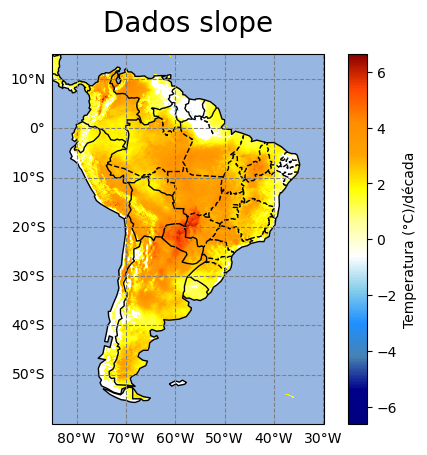

In [76]:
#Criando Mapa de Temperatura Anual média
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

# Configurar o plot
fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})

from matplotlib.colors import LinearSegmentedColormap

# Definir cores para o colormap
colors = ['#000080','#00008B','#4682B4','#1E90FF','#87CEEB','white',"#FFFF99","#FFFF00","#FFA500","#FF8C00","#FF4500","#8B0000"]
# Criar o colormap
cmap = LinearSegmentedColormap.from_list("blue_white_red", colors)

# Plotar a média da temperatura
(resultado_ds_corrigido['slope_corrigido']).plot(ax=ax, transform=ccrs.PlateCarree(), cmap=cmap, cbar_kwargs={'label': 'Temperatura (°C)/década'})
#levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 


#Adicionando o contorno dos continentes, países e estados do Brasil
#Adicionando o contorno dos continentes
ax.add_feature(cfeature.COASTLINE)

#Adicionando os limites dos países
ax.add_feature(cfeature.BORDERS)

#Adicionando o oceano
ax.add_feature(cfeature.OCEAN)

#Adicionando os limites estaduais
states = cfeature.NaturalEarthFeature(category='cultural',
                                      name='admin_1_states_provinces_lines',
                                      scale='50m',
                                      facecolor='none')
ax.add_feature(states, edgecolor='k', linestyle='--')

#Adicionando título a figura 
ax.set_title(f'Dados slope', fontsize=20, y=1.04)

#Adicionando as linhas de grade
g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)

#Formatando os labels como latitude e longitude
g1.yformatter = LATITUDE_FORMATTER
g1.xformatter = LONGITUDE_FORMATTER

#agora irei tirar as grades  superior e direita
# Remove as linhas de grade à direita
g1.ylabels_right = False  # Remove labels do eixo y à direita
g1.right_labels = False  # Remove a linha de grade à direita
g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas

# Remove as linhas de grade no topo (se necessário)
g1.xlabels_top = False  # Remove labels do eixo x no topo

# Remove as linhas de grade no topo (se necessário)
g1.xlabels_top = False  # Remove labels do eixo x no topo
g1.top_labels = False  # Remove a linha de grade no topo

# BIO 12 - Precipitação Anual Total

## Equação
![Equação_BIO_03](Equações/Equacao_BIO12.png)

In [77]:
len(df_cidades)

7

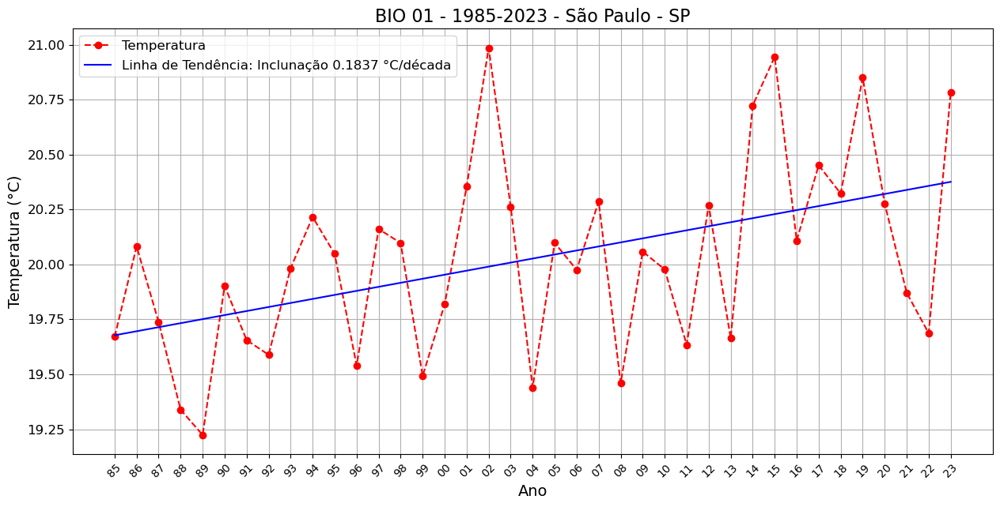

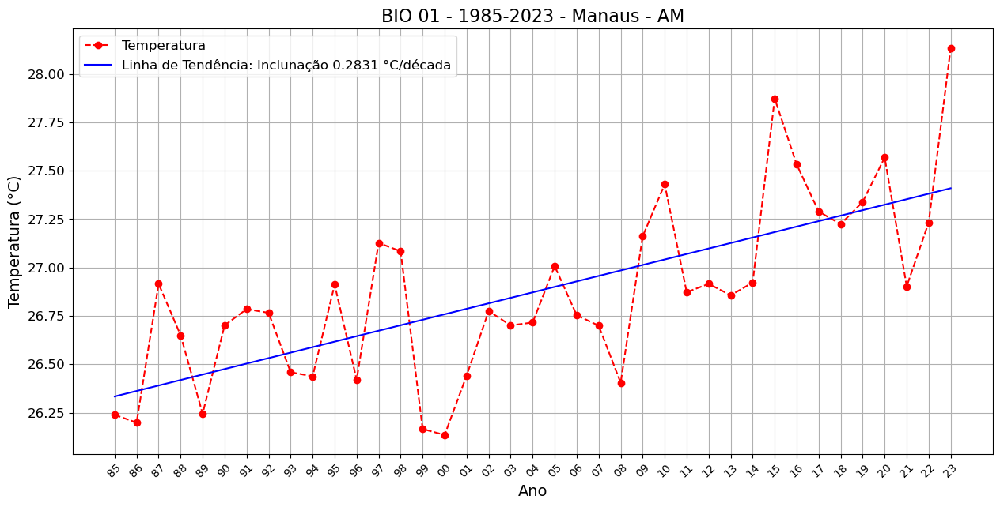

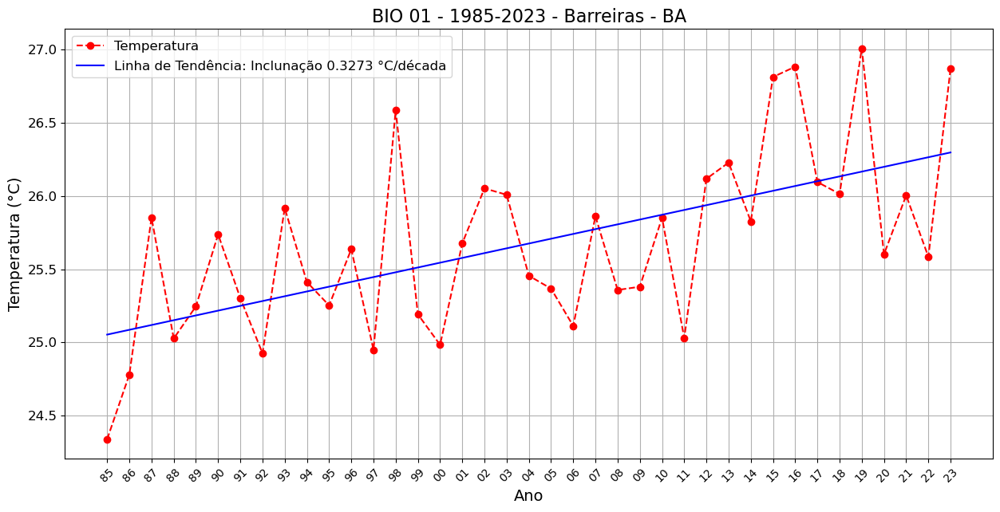

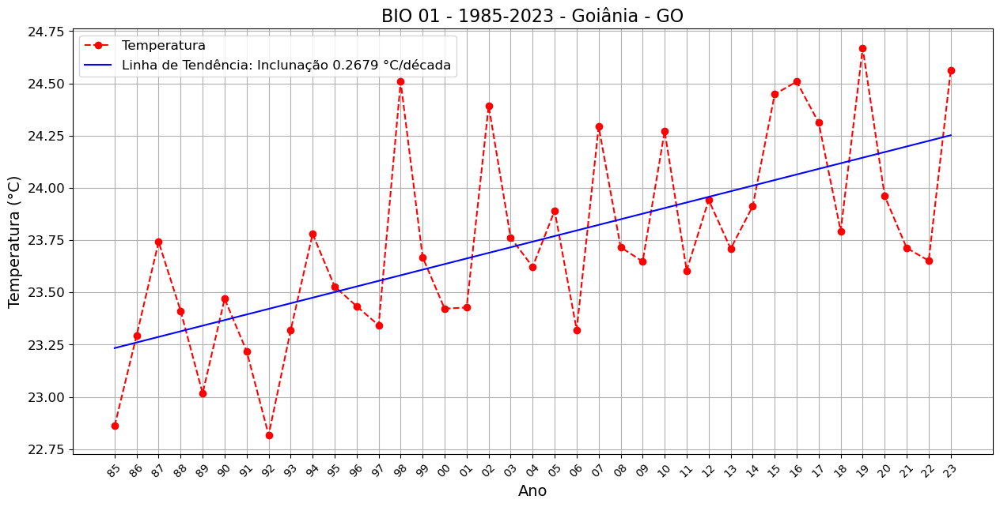

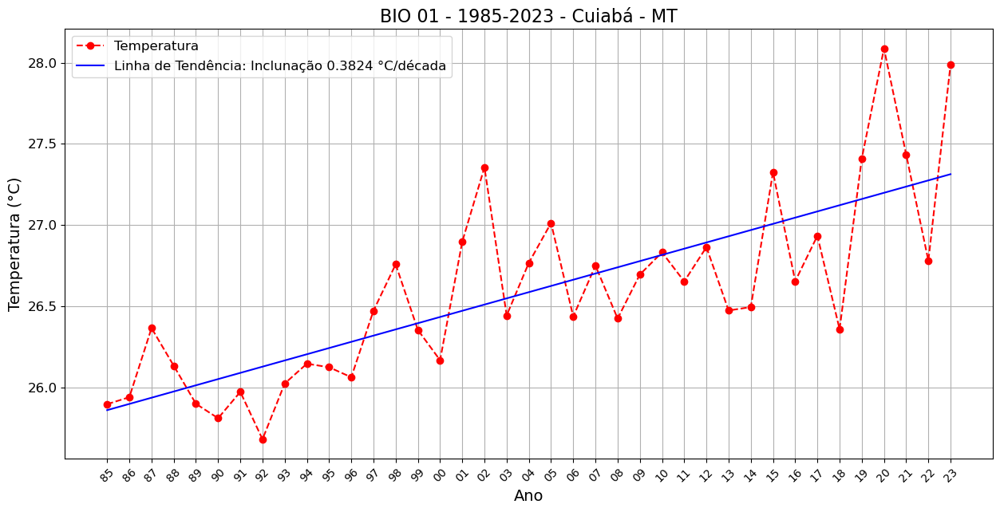

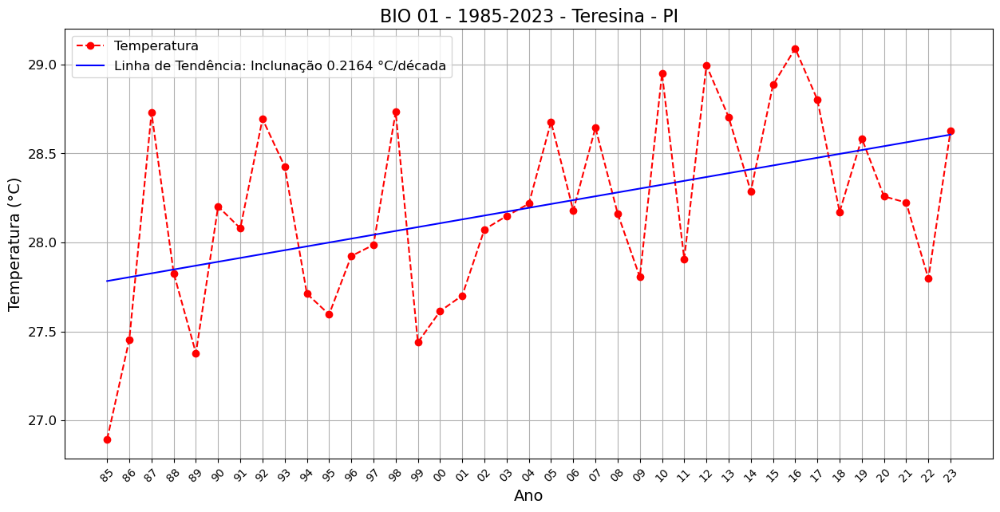

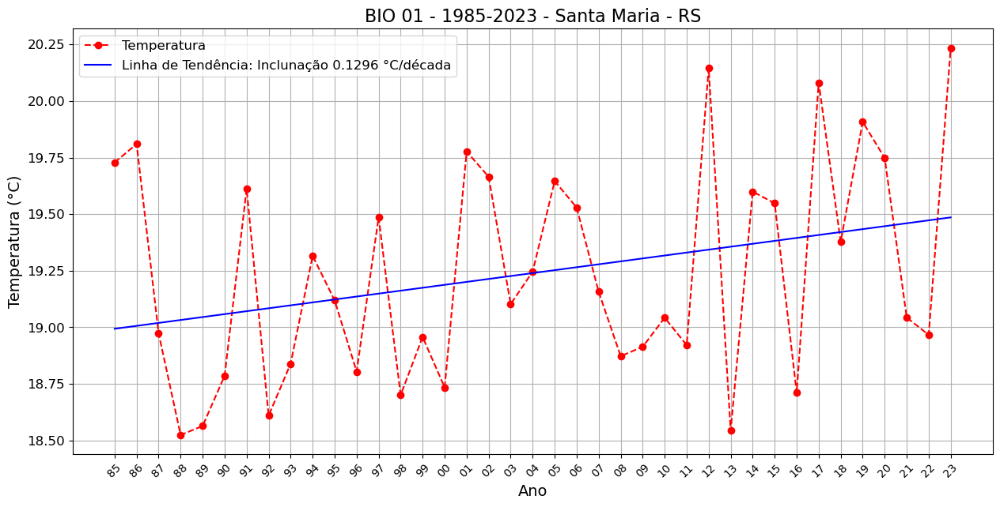

In [80]:
import matplotlib.pyplot as plt
import numpy as np

for i in range(0,len(df_cidades)):
    # Extrair os anos e as médias correspondentes de BIO01
    anos_texto = ['85','86','87','88','89','90','91','92','93','94','95','96','97','98','99',
            '00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
            '13','14', '15','16','17','18','19','20','21','22','23'] # Ajuste conforme necessário
    temperaturas = []
    
    Dado = BIO01
    Nome = 'BIO 01'
    Cidade = f'{df_cidades['Cidade'][i]} - {df_cidades['UF'][i]}'
    latitude = df_cidades['Latitude'][i]
    longitude = df_cidades['Longitude'][i]
    
    Temp = Dado.sel(lon=longitude, lat=latitude, method='nearest')
    anos = list(range(1985, 2024))
    
    # Extrair as temperaturas anuais
    for ano in anos:
        var_name = f'{Nome} {ano}'
        temperaturas.append(Temp[var_name].values)  # Média da variável para todas as coordenadas
    
    # Converter os anos de texto para números para calcular a linha de tendência
    anos_num = np.arange(1985, 2024)
    
    # Calcular a linha de tendência (regressão linear)
    coef = np.polyfit(anos_num, temperaturas, 1)  # "1" para linha reta (linear)
    linha_tendencia = np.polyval(coef, anos_num)

     # A inclinação da reta de tendência
    inclinacao = coef[0]  # O primeiro valor do coef representa a inclinação (coeficiente angular)

    # Criar o gráfico
    plt.figure(figsize=(15, 7))
    plt.plot(anos_texto, temperaturas, marker='o', linestyle='--', color='r', label='Temperatura')
    plt.plot(anos_texto, linha_tendencia, linestyle='-', color='b', label=f'Linha de Tendência: Inclunação {inclinacao*10:.4f} °C/década')
    
    # Ajustes no gráfico
    plt.title(f'{Nome} - 1985-2023 - {Cidade}', fontsize=16)
    plt.xlabel('Ano', fontsize=14)
    plt.ylabel('Temperatura (°C)', fontsize=14)
    plt.xticks(anos_texto, rotation=45, fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.legend(fontsize=12)
    
    # Salvar e mostrar o gráfico
    plt.savefig(f"Mapas/Serie_Temp_BIO01_Temperatura_Anual_{Cidade}.png", dpi=300, bbox_inches='tight')
    
    # Mostrar o gráfico
    plt.show()


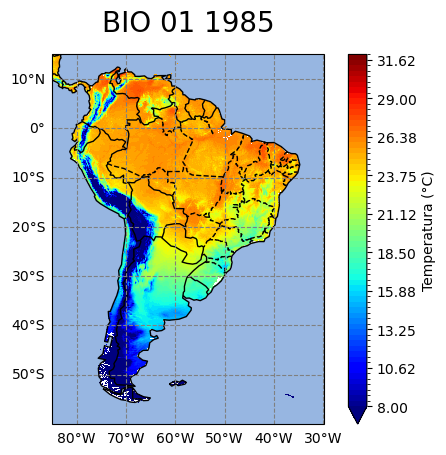

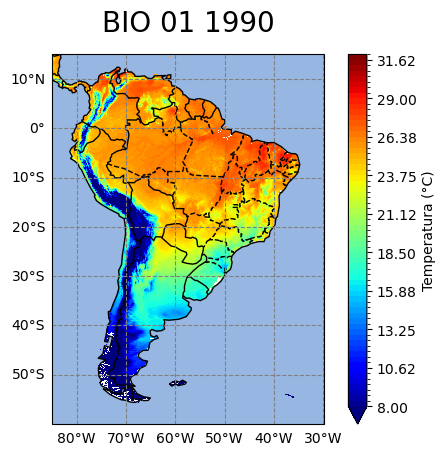

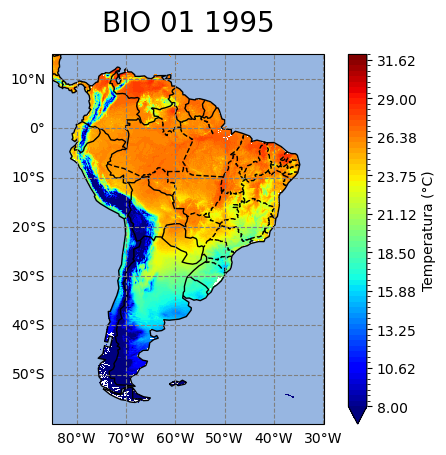

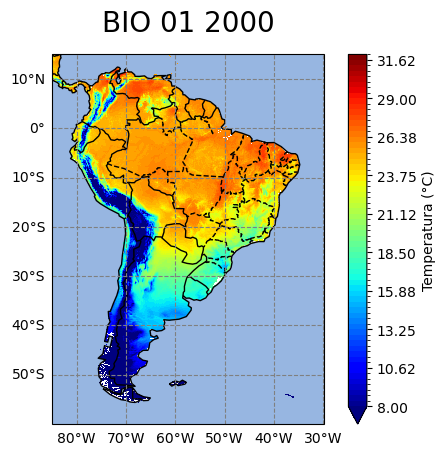

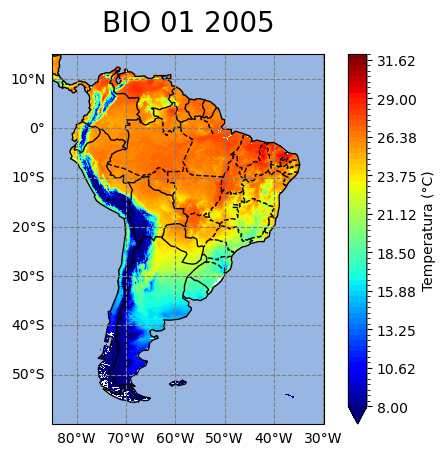

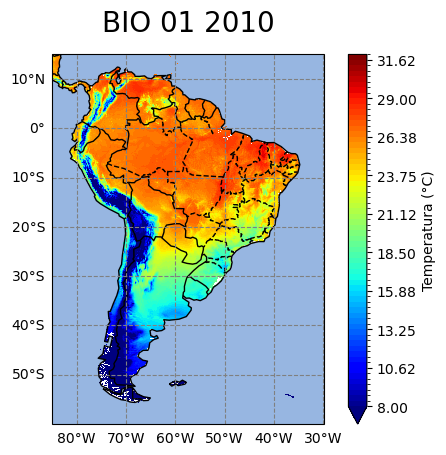

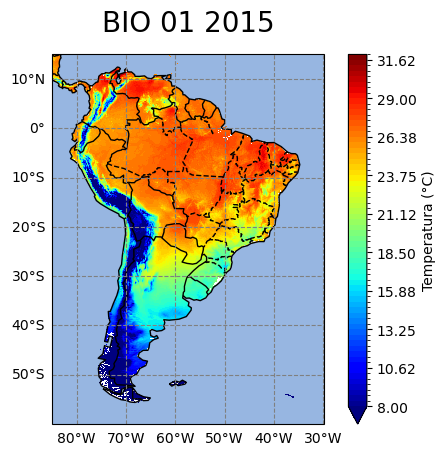

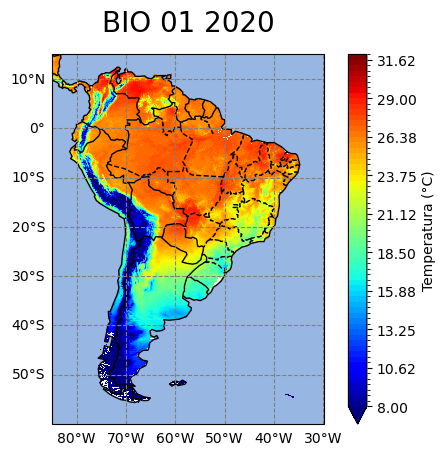

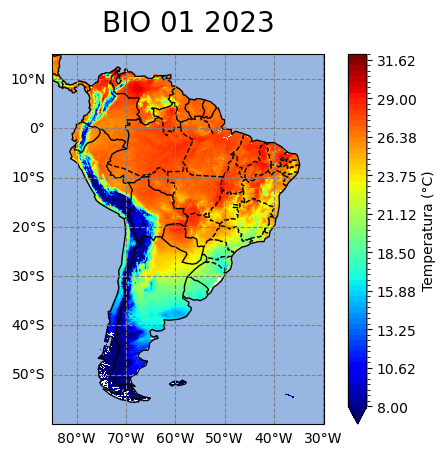

In [81]:
#Criando Mapa de Temperatura Anual média
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 01 {ano}'               
    Base= BIO01[valor]
    max = 32
    min = 8
    # Configurar o plot
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
        
    # Plotar a média da temperatura
        
    Base.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='jet',levels=np.linspace(min, max, 65), cbar_kwargs={'label': 'Temperatura (°C)'})
        
    #levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 
        
        
    #Adicionando o contorno dos continentes, países e estados do Brasil
    #Adicionando o contorno dos continentes
    ax.add_feature(cfeature.COASTLINE)
        
    #Adicionando os limites dos países
    ax.add_feature(cfeature.BORDERS)
        
    #Adicionando o oceano
    ax.add_feature(cfeature.OCEAN)
        
    #Adicionando os limites estaduais
    states = cfeature.NaturalEarthFeature(category='cultural',
                                              name='admin_1_states_provinces_lines',
                                              scale='50m',
                                              facecolor='none')
    ax.add_feature(states, edgecolor='k', linestyle='--')
        
    #Adicionando título a figura 
    ax.set_title(valor, fontsize=20, y=1.04)
        
    #Adicionando as linhas de grade
    g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)
        
    #Formatando os labels como latitude e longitude
    g1.yformatter = LATITUDE_FORMATTER
    g1.xformatter = LONGITUDE_FORMATTER
        
    #agora irei tirar as grades  superior e direita
    # Remove as linhas de grade à direita
    g1.ylabels_right = False  # Remove labels do eixo y à direita
    g1.right_labels = False  # Remove a linha de grade à direita
    g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas
        
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
        
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    g1.top_labels = False  # Remove a linha de grade no topo

    # Salvar e mostrar o gráfico
    plt.savefig(f"Mapas/Mapa_BIO01_Temperatura_Anual_{ano}.png", dpi=300, bbox_inches='tight')

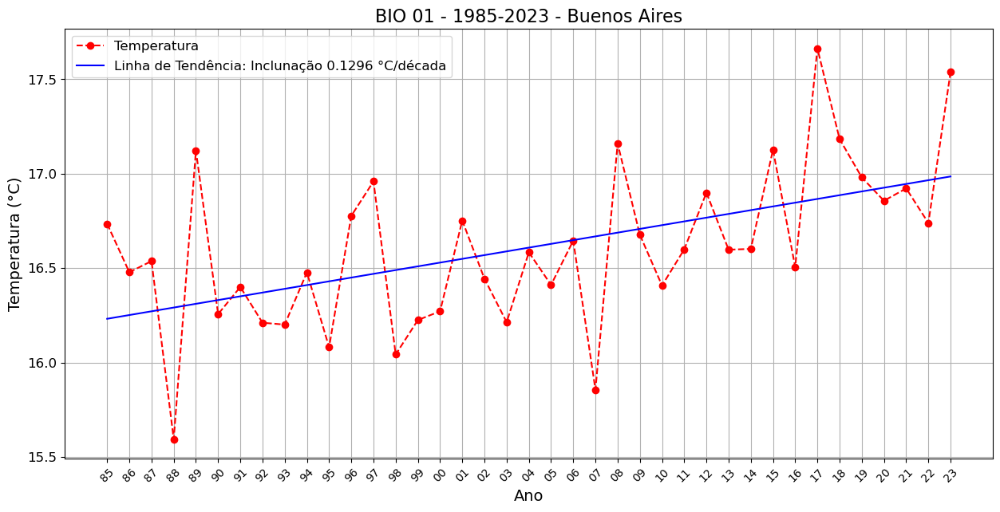

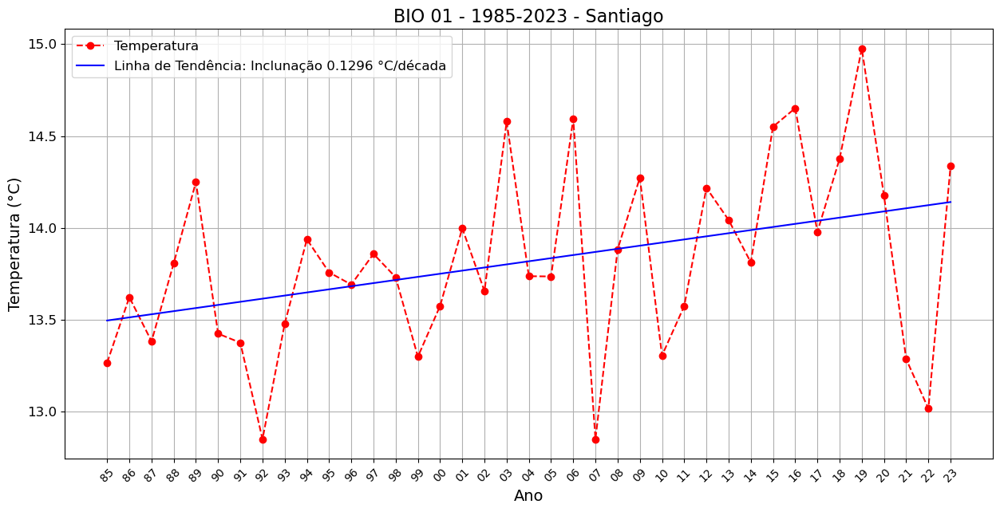

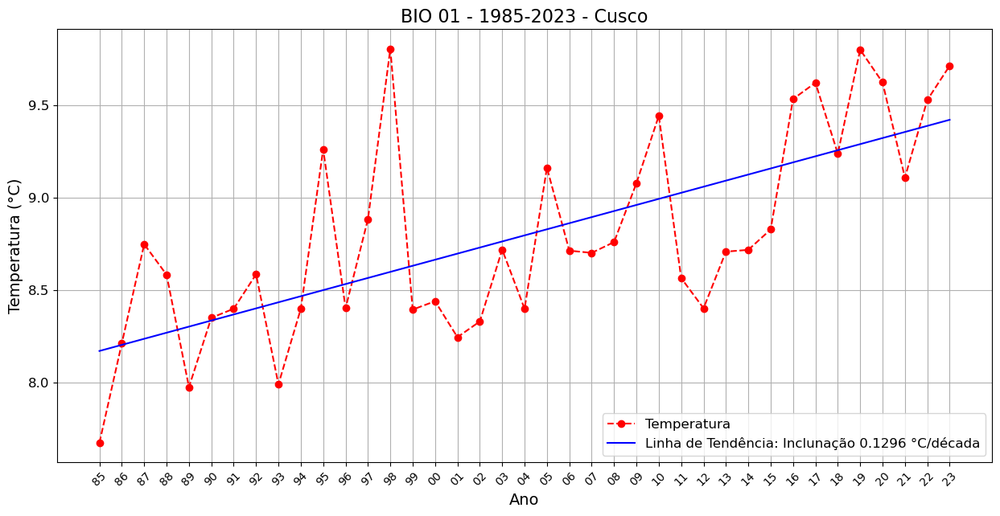

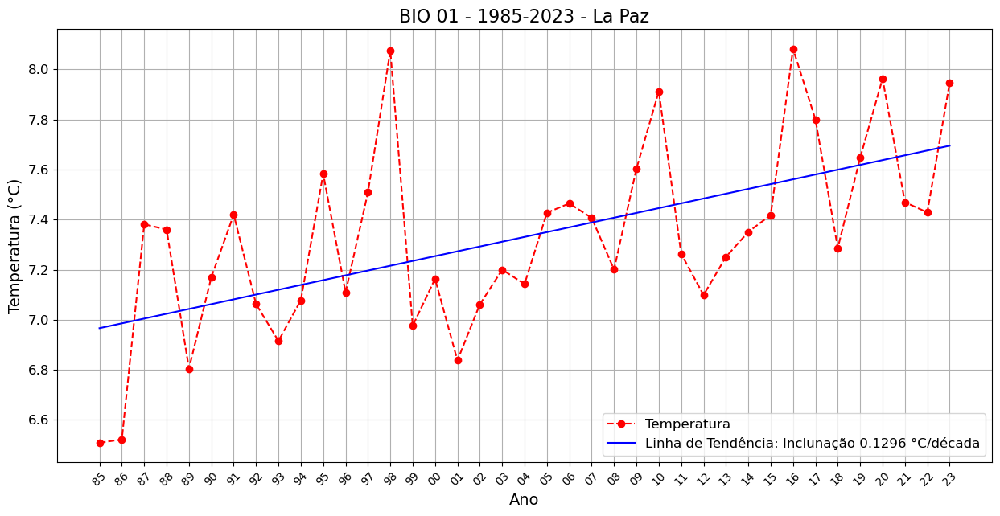

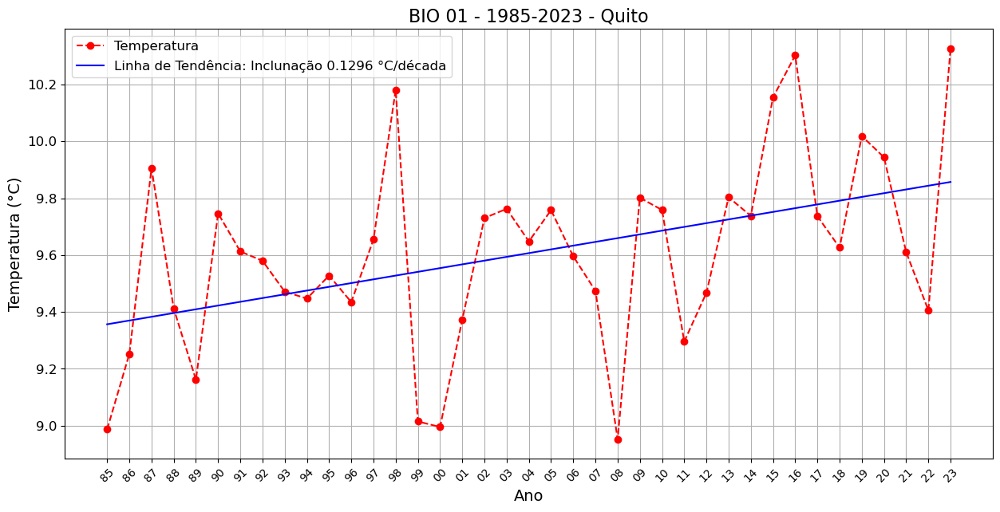

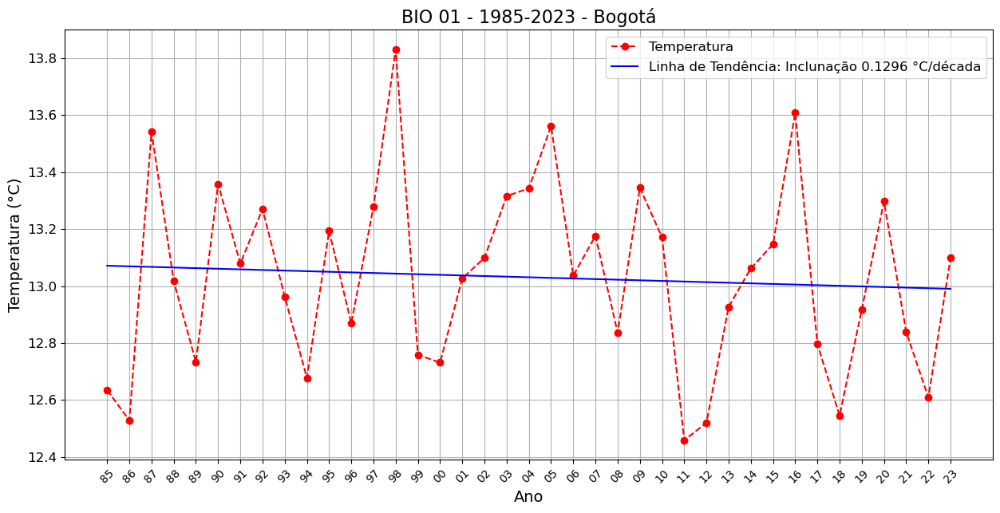

In [82]:
import matplotlib.pyplot as plt
import numpy as np

for i in range(0,len(df_cap_AS)):
    # Extrair os anos e as médias correspondentes de BIO01
    anos_texto = ['85','86','87','88','89','90','91','92','93','94','95','96','97','98','99',
            '00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
            '13','14', '15','16','17','18','19','20','21','22','23'] # Ajuste conforme necessário
    temperaturas = []
    
    Dado = BIO01
    Nome = 'BIO 01'
    Cidade = f'{df_cap_AS['Cidade'][i]}'
    latitude = df_cap_AS['Latitude'][i]
    longitude = df_cap_AS['Longitude'][i]
    
    Temp = Dado.sel(lon=longitude, lat=latitude, method='nearest')
    anos = list(range(1985, 2024))
    
    # Extrair as temperaturas anuais
    for ano in anos:
        var_name = f'{Nome} {ano}'
        temperaturas.append(Temp[var_name].values)  # Média da variável para todas as coordenadas
    
    # Converter os anos de texto para números para calcular a linha de tendência
    anos_num = np.arange(1985, 2024)
    
    # Calcular a linha de tendência (regressão linear)
    coef = np.polyfit(anos_num, temperaturas, 1)  # "1" para linha reta (linear)
    linha_tendencia = np.polyval(coef, anos_num)
    
    # Criar o gráfico
    plt.figure(figsize=(15, 7))
    plt.plot(anos_texto, temperaturas, marker='o', linestyle='--', color='r', label='Temperatura')
    plt.plot(anos_texto, linha_tendencia, linestyle='-', color='b', label=f'Linha de Tendência: Inclunação {inclinacao*10:.4f} °C/década')
    
    # Ajustes no gráfico
    plt.title(f'{Nome} - 1985-2023 - {Cidade}', fontsize=16)
    plt.xlabel('Ano', fontsize=14)
    plt.ylabel('Temperatura (°C)', fontsize=14)
    plt.xticks(anos_texto, rotation=45, fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.legend(fontsize=12)
    
    # Salvar e mostrar o gráfico
    #plt.savefig(f"Mapas/Serie_Temp_BIO01_Temperatura_Anual_{Cidade}.png", dpi=300, bbox_inches='tight')
    
    # Mostrar o gráfico
    plt.show()


In [83]:
display(df_cidades)
display(df_cap_AS)

,Cidade,UF,Latitude,Longitude
0,São Paulo,SP,-23.5505,-46.6333
1,Manaus,AM,-3.1190,-60.0217
2,Barreiras,BA,-12.1462,-44.9908
3,Goiânia,GO,-16.6869,-49.2647
4,Cuiabá,MT,-15.6014,-56.0979
5,Teresina,PI,-5.0910,-42.8038
6,Santa Maria,RS,-29.6868,-53.8069


,Cidade,Latitude,Longitude
0,Buenos Aires,-35.40,-58.37
1,Santiago,-33.45,-70.67
2,Cusco,-13.52,-71.98
3,La Paz,-16.49,-68.12
4,Quito,-0.23,-78.52
5,Bogotá,4.61,-74.08


In [84]:
import pandas as pd

# Criar uma cópia do DataFrame
df_cidades_copia = df_cidades.copy()

# Remover a linha com índice 2 (cidade "Barreiras")
df_cidades_copia = df_cidades_copia.drop(2)

# Exibir o DataFrame após remoção
display(df_cidades_copia)

,Cidade,UF,Latitude,Longitude
0,São Paulo,SP,-23.5505,-46.6333
1,Manaus,AM,-3.1190,-60.0217
3,Goiânia,GO,-16.6869,-49.2647
4,Cuiabá,MT,-15.6014,-56.0979
5,Teresina,PI,-5.0910,-42.8038
6,Santa Maria,RS,-29.6868,-53.8069


Inclinação da linha de tendência para São Paulo (1985-2023): 0.0271


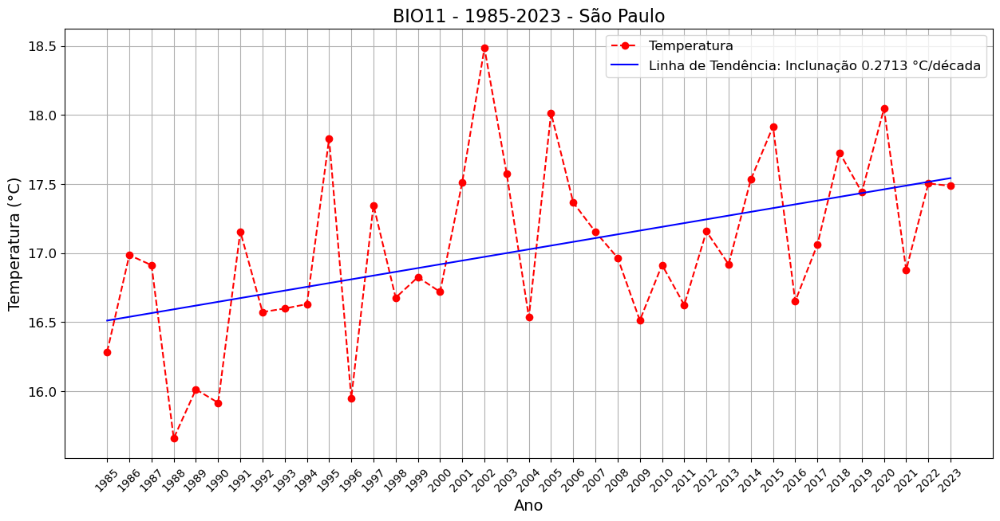

Inclinação da linha de tendência para Manaus (1985-2023): 0.0176


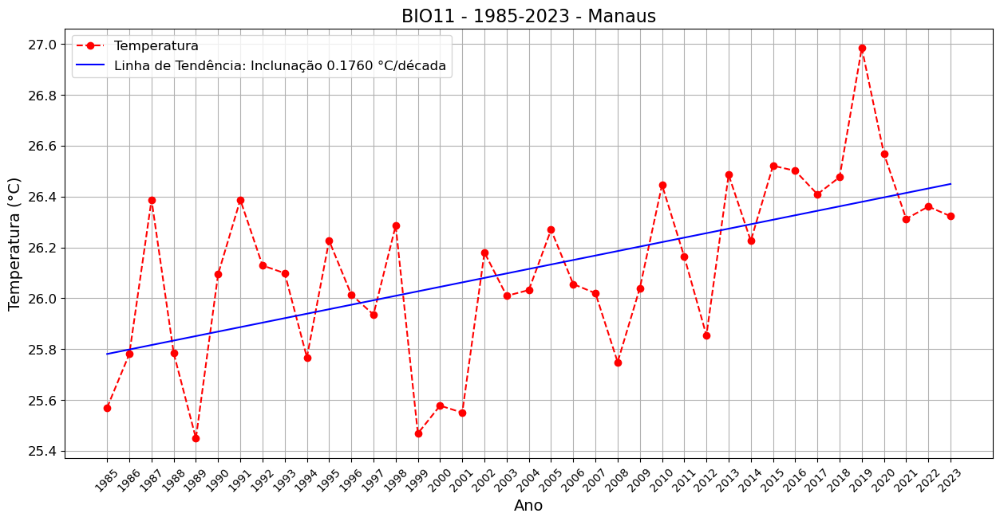

Inclinação da linha de tendência para Goiânia (1985-2023): 0.0150


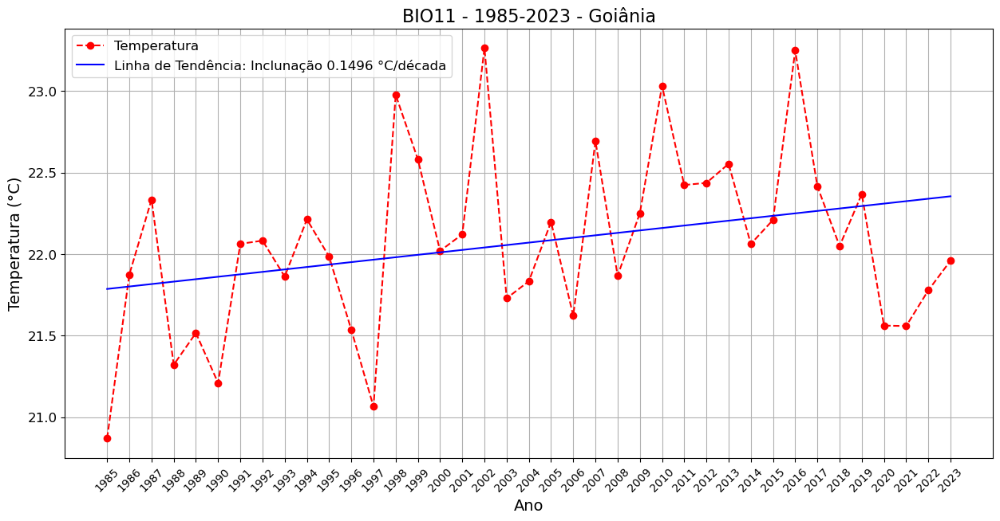

Inclinação da linha de tendência para Cuiabá (1985-2023): 0.0349


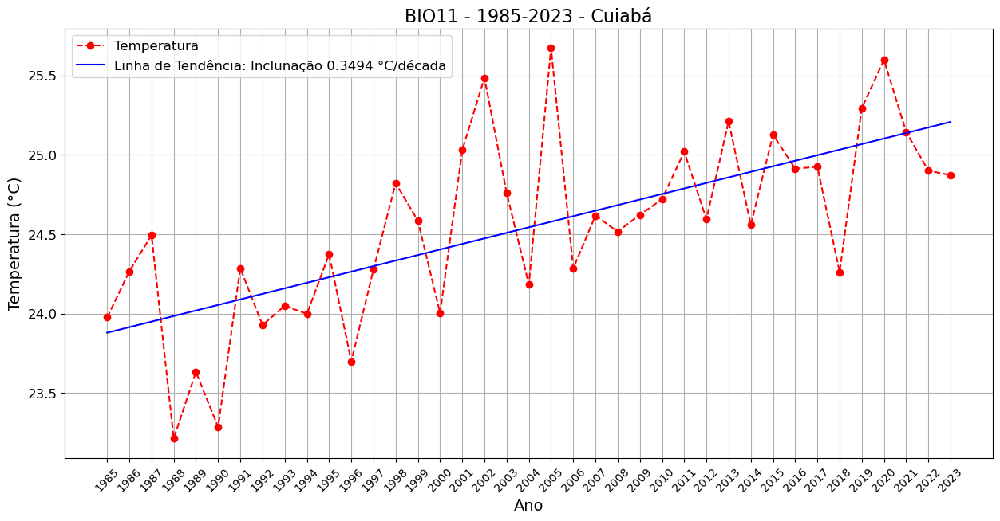

Inclinação da linha de tendência para Teresina (1985-2023): 0.0217


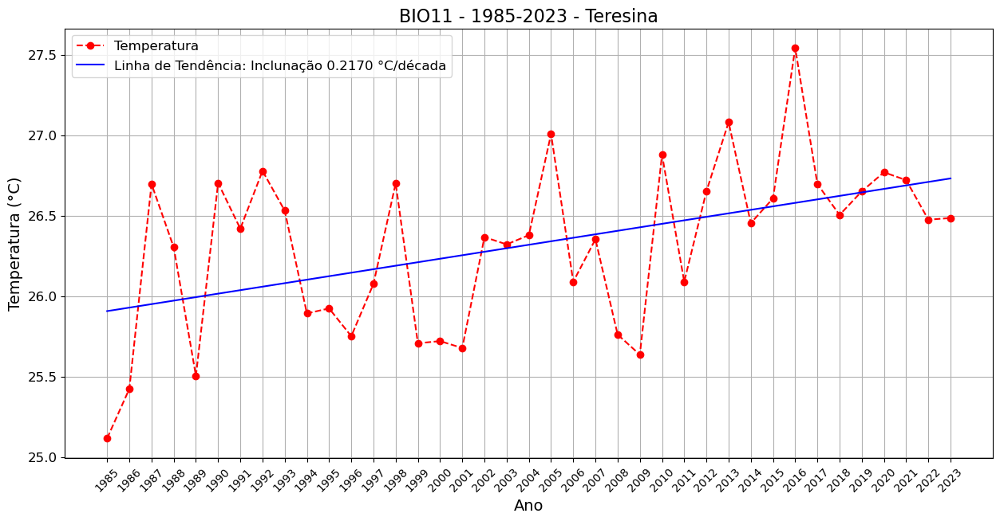

Inclinação da linha de tendência para Santa Maria (1985-2023): 0.0105


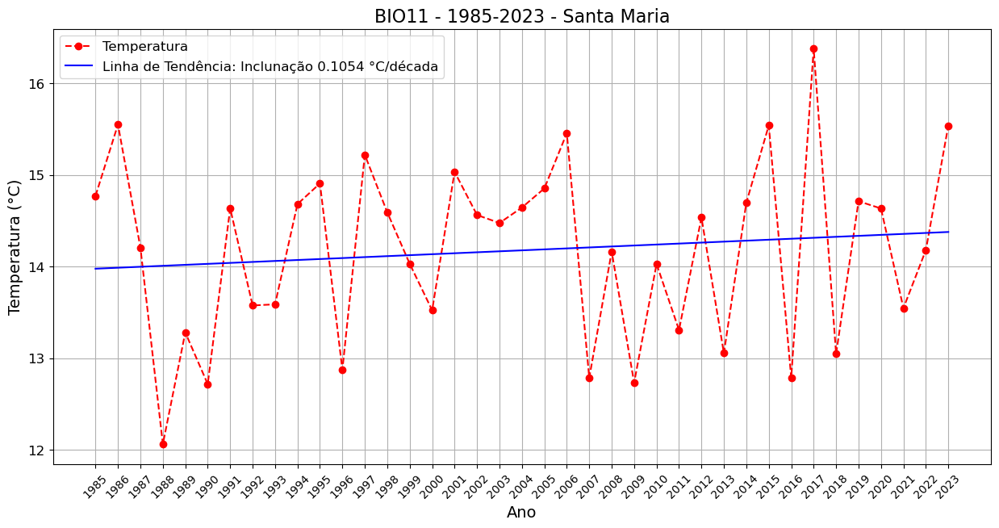

In [174]:
import matplotlib.pyplot as plt
import numpy as np

# Loop sobre as cidades no dataframe df_cap_AS
for i in range(len(df_cap_AS)):
    # Extrair anos e médias correspondentes de BIO01
    anos_texto = ['85','86','87','88','89','90','91','92','93','94','95','96','97','98','99',
                  '00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
                  '13','14', '15','16','17','18','19','20','21','22','23']  # Anos como strings
    
    temperaturas = []
    
    Dado = BIO11
    Nome = 'BIO11'
    Cidade = df_cidades_copia.iloc[i]['Cidade']  # Acesso correto ao nome da cidade
    latitude = df_cidades_copia.iloc[i]['Latitude']
    longitude = df_cidades_copia.iloc[i]['Longitude']
    
    # Extrair os dados de temperatura nas coordenadas fornecidas
    Temp = Dado.sel(lon=longitude, lat=latitude, method='nearest')
    
    # Anos de 1985 a 2023
    anos = list(range(1985, 2024))
    
    # Extrair as temperaturas anuais
    for ano in anos:
        var_name = f'{Nome} {ano}'
        temperaturas.append(Temp[var_name].values)  # Adiciona as temperaturas dos anos
    
    # Converter os anos para valores numéricos para facilitar o cálculo e o gráfico
    anos_num = np.arange(1985, 2024)
    
    # Calcular a linha de tendência (regressão linear)
    coef = np.polyfit(anos_num, temperaturas, 1)  # Ajuste linear
    linha_tendencia = np.polyval(coef, anos_num)
    
    # A inclinação da reta de tendência
    inclinacao = coef[0]  # O primeiro valor do coef representa a inclinação (coeficiente angular)
    
    # Exibir a inclinação
    print(f'Inclinação da linha de tendência para {Cidade} (1985-2023): {inclinacao:.4f}')
    
    # Criar o gráfico
    plt.figure(figsize=(15, 7))
    plt.plot(anos_num, temperaturas, marker='o', linestyle='--', color='r', label='Temperatura')
    plt.plot(anos_num, linha_tendencia, linestyle='-', color='b', label=f'Linha de Tendência: Inclunação {inclinacao*10:.4f} °C/década')
    
    # Adicionar título e rótulos aos eixos
    plt.title(f'{Nome} - 1985-2023 - {Cidade}', fontsize=16)
    plt.xlabel('Ano', fontsize=14)
    plt.ylabel('Temperatura (°C)', fontsize=14)
    plt.xticks(anos_num, rotation=45, fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.legend(fontsize=12)
    
    plt.savefig(f"Mapas/Serie_Temp_BIO01_Temperatura_Anual_{Cidade}.png", dpi=300, bbox_inches='tight')
    
    # Exibir o gráfico
    plt.show()


Inclinação da linha de tendência para Buenos Aires (1985-2023): 0.0056


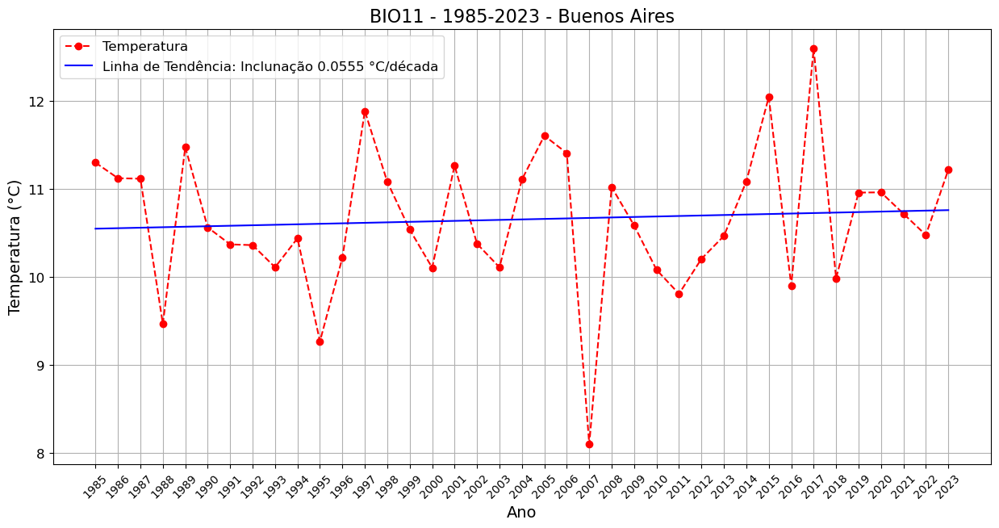

Inclinação da linha de tendência para Santiago (1985-2023): 0.0038


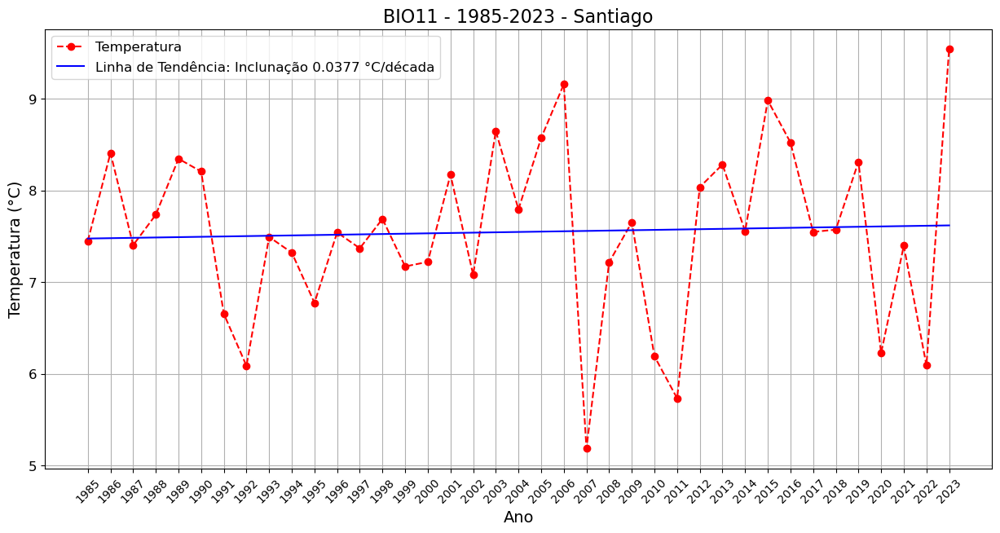

Inclinação da linha de tendência para Cusco (1985-2023): 0.0441


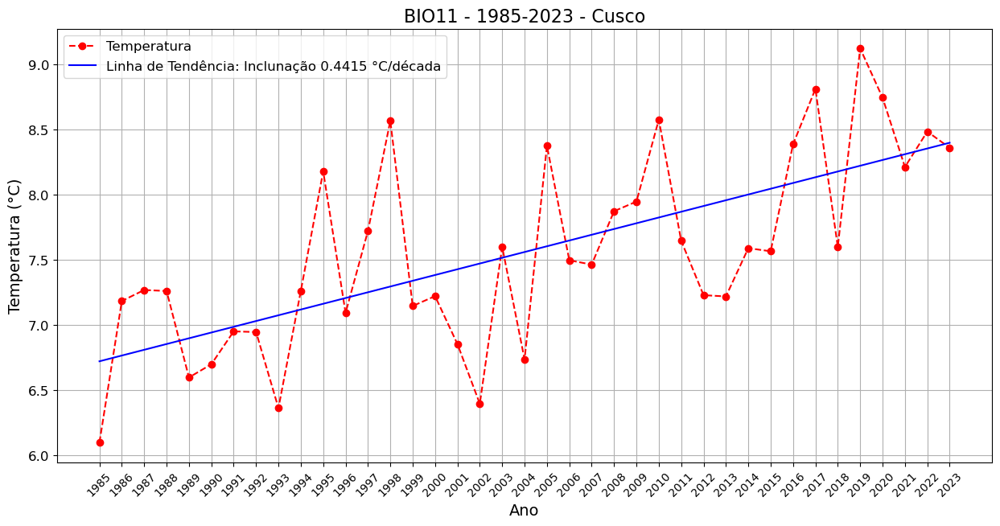

Inclinação da linha de tendência para La Paz (1985-2023): 0.0336


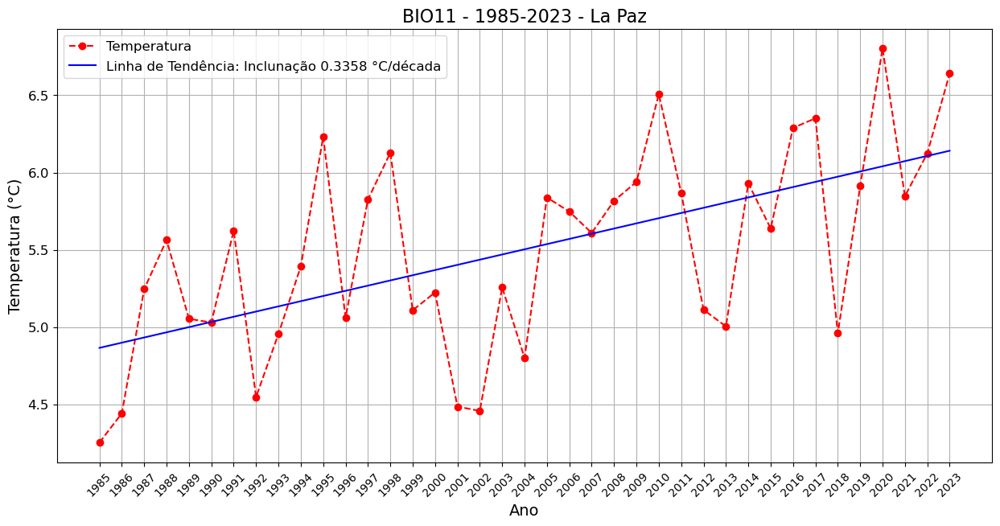

Inclinação da linha de tendência para Quito (1985-2023): 0.0115


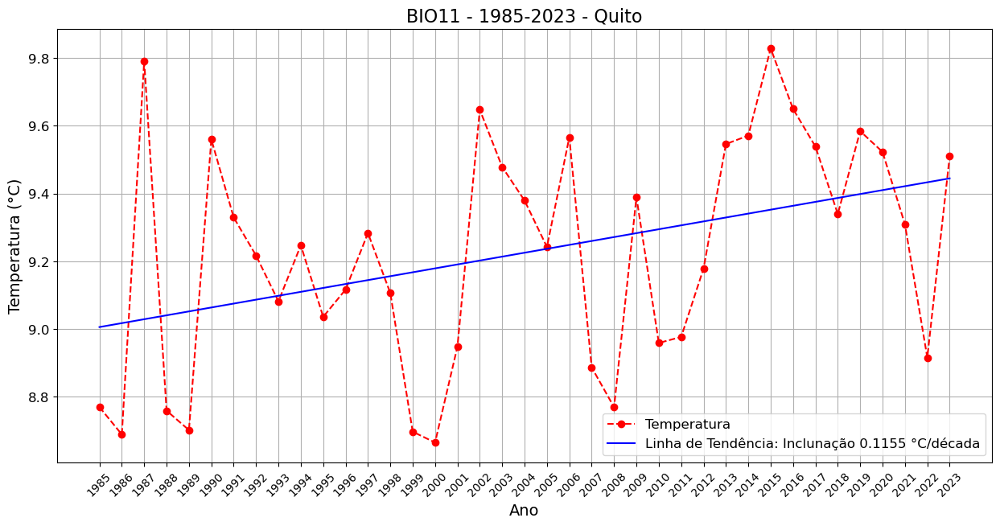

Inclinação da linha de tendência para Bogotá (1985-2023): 0.0024


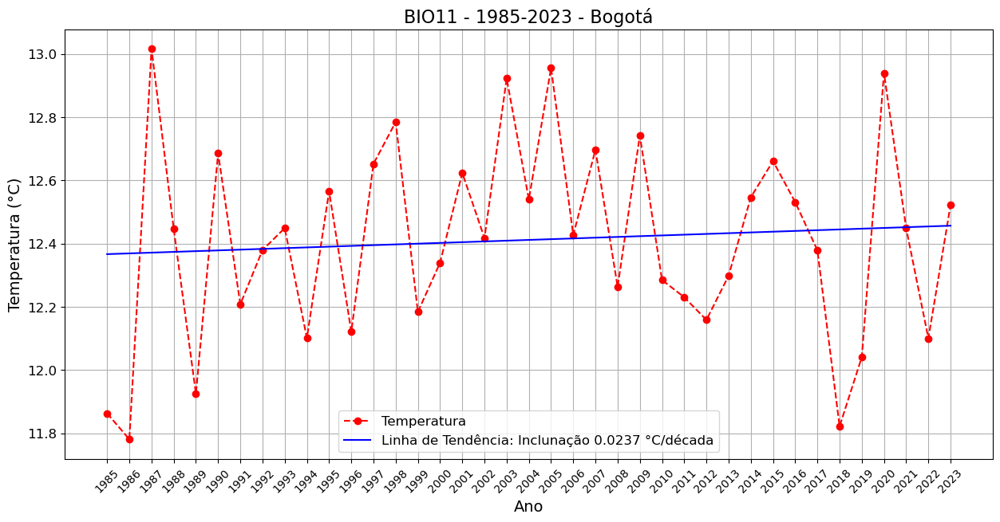

In [175]:
import matplotlib.pyplot as plt
import numpy as np

# Loop sobre as cidades no dataframe df_cap_AS
for i in range(len(df_cap_AS)):
    # Extrair anos e médias correspondentes de BIO01
    anos_texto = ['85','86','87','88','89','90','91','92','93','94','95','96','97','98','99',
                  '00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
                  '13','14', '15','16','17','18','19','20','21','22','23']  # Anos como strings
    
    temperaturas = []
    
    Dado = BIO11
    Nome = 'BIO11'
    Cidade = df_cap_AS.iloc[i]['Cidade']  # Acesso correto ao nome da cidade
    latitude = df_cap_AS.iloc[i]['Latitude']
    longitude = df_cap_AS.iloc[i]['Longitude']
    
    # Extrair os dados de temperatura nas coordenadas fornecidas
    Temp = Dado.sel(lon=longitude, lat=latitude, method='nearest')
    
    # Anos de 1985 a 2023
    anos = list(range(1985, 2024))
    
    # Extrair as temperaturas anuais
    for ano in anos:
        var_name = f'{Nome} {ano}'
        temperaturas.append(Temp[var_name].values)  # Adiciona as temperaturas dos anos
    
    # Converter os anos para valores numéricos para facilitar o cálculo e o gráfico
    anos_num = np.arange(1985, 2024)
    
    # Calcular a linha de tendência (regressão linear)
    coef = np.polyfit(anos_num, temperaturas, 1)  # Ajuste linear
    linha_tendencia = np.polyval(coef, anos_num)
    
    # A inclinação da reta de tendência
    inclinacao = coef[0]  # O primeiro valor do coef representa a inclinação (coeficiente angular)
    
    # Exibir a inclinação
    print(f'Inclinação da linha de tendência para {Cidade} (1985-2023): {inclinacao:.4f}')
    
    # Criar o gráfico
    plt.figure(figsize=(15, 7))
    plt.plot(anos_num, temperaturas, marker='o', linestyle='--', color='r', label='Temperatura')
    plt.plot(anos_num, linha_tendencia, linestyle='-', color='b', label=f'Linha de Tendência: Inclunação {inclinacao*10:.4f} °C/década')
    
    # Adicionar título e rótulos aos eixos
    plt.title(f'{Nome} - 1985-2023 - {Cidade}', fontsize=16)
    plt.xlabel('Ano', fontsize=14)
    plt.ylabel('Temperatura (°C)', fontsize=14)
    plt.xticks(anos_num, rotation=45, fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.legend(fontsize=12)
    
    plt.savefig(f"Mapas/Serie_Temp_BIO01_Temperatura_Anual_{Cidade}.png", dpi=300, bbox_inches='tight')
    
    # Exibir o gráfico
    plt.show()

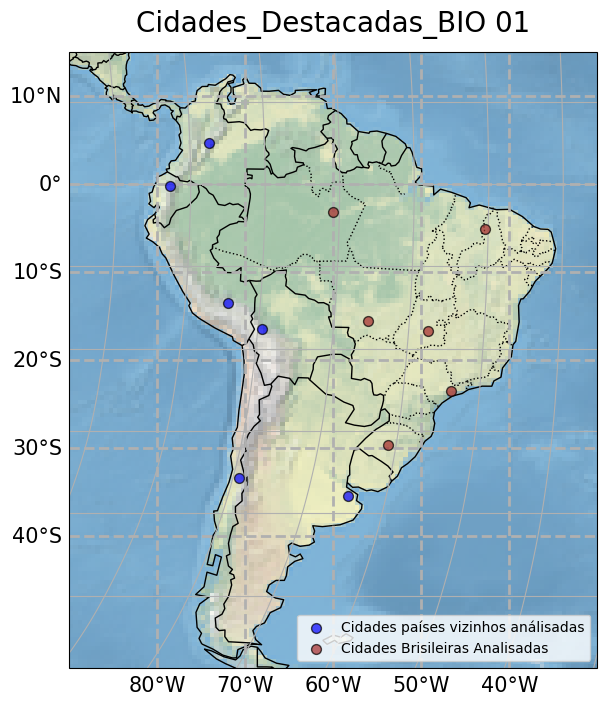

In [86]:
#Postando dados em cima do mapa 

fig = plt.figure(figsize=(10,8)) #Cria objeto de figura com tamanho

ax = fig.add_subplot(111,projection=ccrs.PlateCarree()) #Colocando eixos na fugura neste caso 1 linha por uma coluna para ocupar a primeira posição

#Inserindo elementos
ax.add_feature(cfeature.COASTLINE) #Adicionando as linhas dos continentes
ax.add_feature(cfeature.BORDERS) #Adicionando as frenteiras 


ax.gridlines(crs=ccrs.Robinson()) #Adicionando as linhas de grade
ax.set_title('Cidades_Destacadas_BIO 01',fontsize=20,y=1.02)

#ax.set_title('Projeção de Robinson',fontsize=20,y=1.02) #Criação de Título e ajuste do tamanho do título fontsize,
#y determina o espaçamento entre o título e a imagem

#Realização de corte para o Brasil somente 
ax.set_extent([-90,-30,15,-55],ccrs.PlateCarree()) 
#Lista de Longitude de Oeste (-90) a Longitude de Leste (-30))
#A latitude de Norte (10) e a Latitude de Sul (-40)

#Inserir limites estatuais do Brasil 

#As informações são baixadas do Natural Earth diretamento
#categoty - cultural (fronteiras internas dos países)
#nome - Admin 1 – States, provinces - DEntro dos dados de admin (site) descrição da informação que precisamos
#scale - Seleciona a escala 50 m faz só brasil - se quisesse colocar demais pais scale 10 m
#facecolor - poligonos dos estados coloridos - none - indica que não quero cores 

states = cfeature.NaturalEarthFeature(category='cultural',
                                      name='admin_1_states_provinces_lines',
                                      scale='50m',
                                     facecolor='none')

ax.add_feature(states,edgecolor='black',linestyle=':',linewidth=1)

#Inserindo as Capitais 
#por se tratar de dados de lat/long - preciso utilizar ccrs.PlateCarrer()
#ax.scatter(df_cidades['Longitude'],df_cidades['Latitude'],s=50,color='brown',edgecolor='black',linewidth=1,
#           alpha=0.7, zorder=10, transform=ccrs.PlateCarree(),label='Cidades Analisadas')

ax.scatter(df_cap_AS['Longitude'],df_cap_AS['Latitude'],s=50,color='b',edgecolor='black',linewidth=1,
           alpha=0.7, zorder=10, transform=ccrs.PlateCarree(),label='Cidades países vizinhos análisadas')

ax.scatter(df_cidades_copia['Longitude'],df_cidades_copia['Latitude'],s=50,color='brown',edgecolor='black',linewidth=1,
           alpha=0.7, zorder=10, transform=ccrs.PlateCarree(),label='Cidades Brisileiras Analisadas')

'''
    s=100,  # Tamanho dos marcadores (em pontos)
    color='red',  # Cor dos marcadores
    edgecolor='black',  # Cor da borda dos marcadores
    linewidth=1,  # Largura da borda dos marcadores
    alpha=0.7,  # Transparência dos marcadores
    zorder=10,  # Ordem em que os marcadores são desenhados
    transform=ccrs.PlateCarree()
'''
# Adicionando a legenda
ax.legend(loc='lower right', fontsize=10)

#Inserindo linhas de grade
g1 = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linestyle='--',linewidth=2)

#agora irei tirar as grades  superior e direita
# Remove as linhas de grade à direita
g1.ylabels_right = False  # Remove labels do eixo y à direita
g1.right_labels = False  # Remove a linha de grade à direita
g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas

# Remove as linhas de grade no topo (se necessário)
g1.xlabels_top = False  # Remove labels do eixo x no topo
g1.top_labels = False  # Remove a linha de grade no topo

#Caso tenha diferença entre os dados do label esquerdo do inferior 
g1.ylocator = mticker.FixedLocator(np.arange(-40,20,10))

g1.yformatter = LATITUDE_FORMATTER
g1.xformatter = LONGITUDE_FORMATTER

#AJUSTAR TAMANHO
g1.xlabel_style = {'size':15}
g1.ylabel_style = {'size':15}

#Inserindo um base map
ax.stock_img()

#Salvando o mapa em png
plt.savefig('Mapas/Cidades_Analisadas.png',dpi=300,bbox_inches='tight')

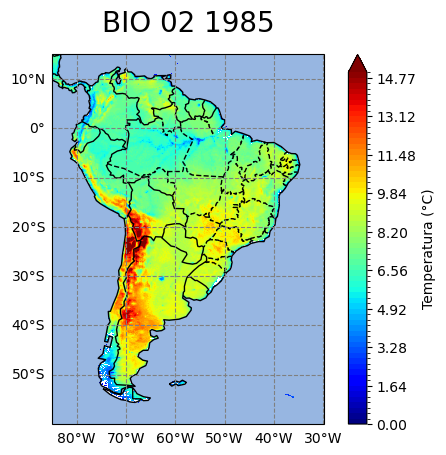

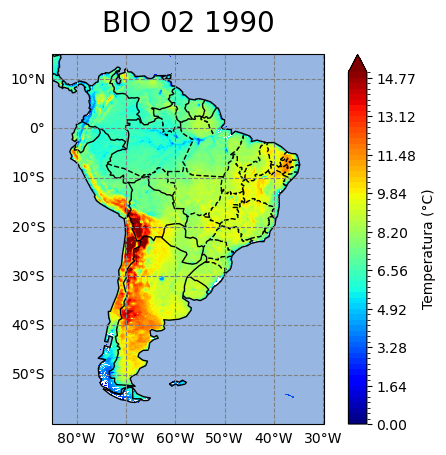

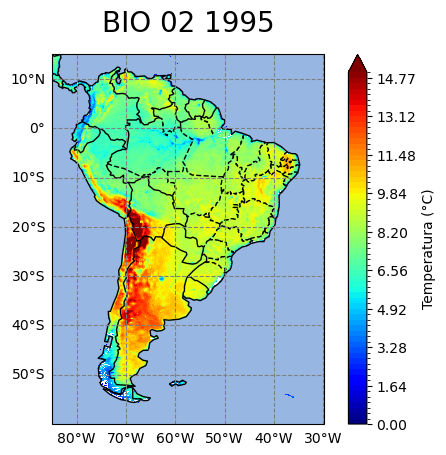

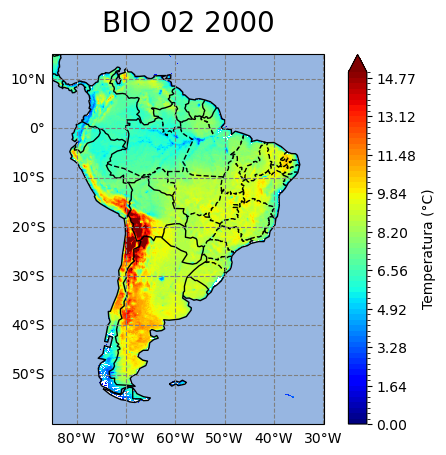

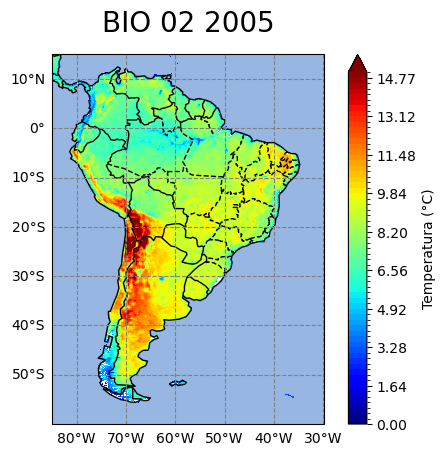

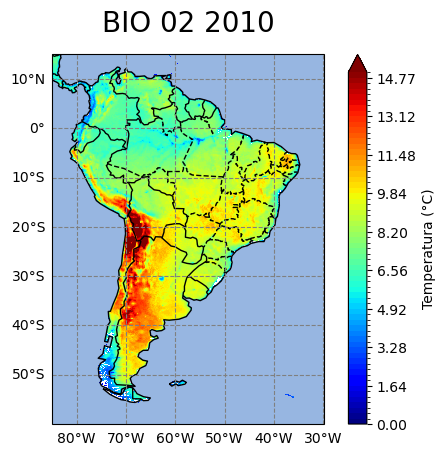

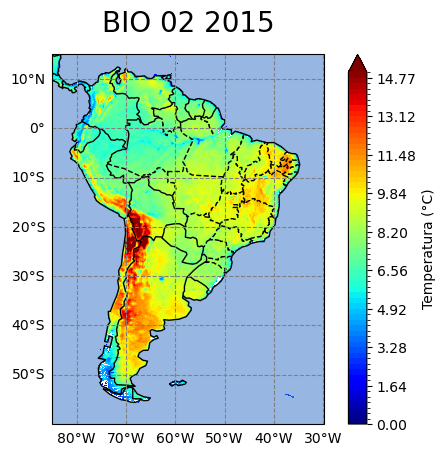

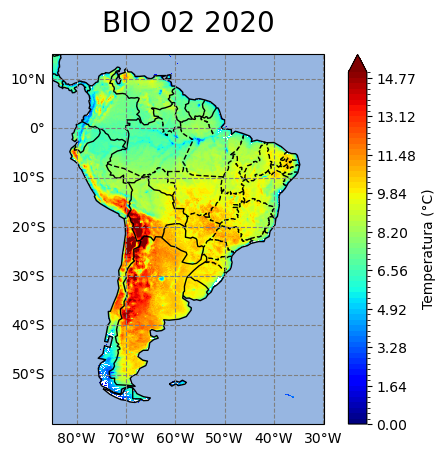

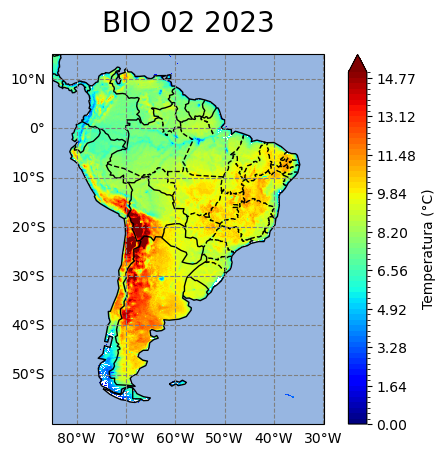

In [102]:
#Criando Mapa de Temperatura Anual média
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 02 {ano}'               
    Base= BIO02[valor]
    max = 15
    min = 0
    # Configurar o plot
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
        
    # Plotar a média da temperatura
        
    Base.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='jet',levels=np.linspace(min, max, 65), cbar_kwargs={'label': 'Temperatura (°C)'})
        
    #levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 
        
        
    #Adicionando o contorno dos continentes, países e estados do Brasil
    #Adicionando o contorno dos continentes
    ax.add_feature(cfeature.COASTLINE)
        
    #Adicionando os limites dos países
    ax.add_feature(cfeature.BORDERS)
        
    #Adicionando o oceano
    ax.add_feature(cfeature.OCEAN)
        
    #Adicionando os limites estaduais
    states = cfeature.NaturalEarthFeature(category='cultural',
                                              name='admin_1_states_provinces_lines',
                                              scale='50m',
                                              facecolor='none')
    ax.add_feature(states, edgecolor='k', linestyle='--')
        
    #Adicionando título a figura 
    ax.set_title(valor, fontsize=20, y=1.04)
        
    #Adicionando as linhas de grade
    g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)
        
    #Formatando os labels como latitude e longitude
    g1.yformatter = LATITUDE_FORMATTER
    g1.xformatter = LONGITUDE_FORMATTER
        
    #agora irei tirar as grades  superior e direita
    # Remove as linhas de grade à direita
    g1.ylabels_right = False  # Remove labels do eixo y à direita
    g1.right_labels = False  # Remove a linha de grade à direita
    g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas
        
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
        
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    g1.top_labels = False  # Remove a linha de grade no topo

    # Salvar e mostrar o gráfico
    plt.savefig(f"Mapas/Mapa_BIO02_Temperatura_Anual_{ano}.png", dpi=300, bbox_inches='tight')

Inclinação da linha de tendência para Buenos Aires (1985-2023): 0.8580


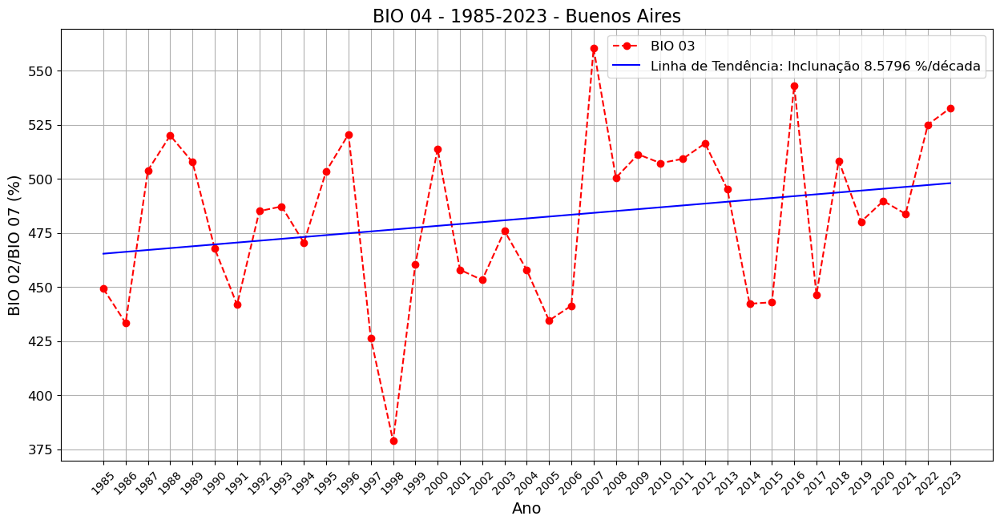

Inclinação da linha de tendência para Santiago (1985-2023): 0.4392


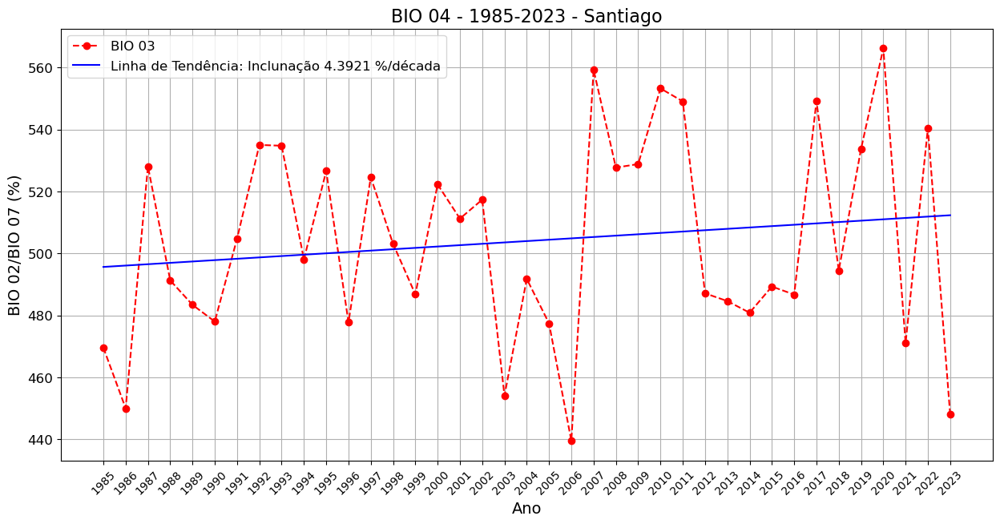

Inclinação da linha de tendência para Cusco (1985-2023): -0.4398


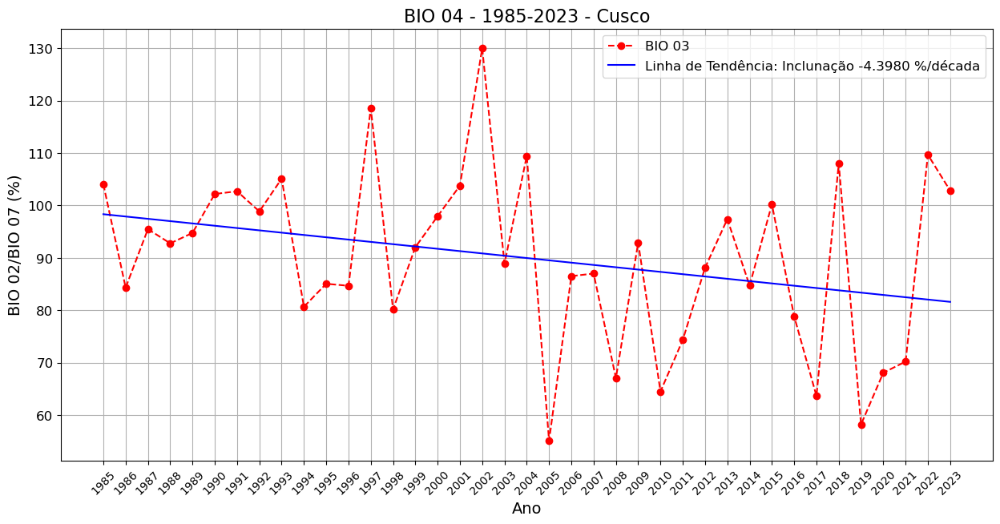

Inclinação da linha de tendência para La Paz (1985-2023): -0.8984


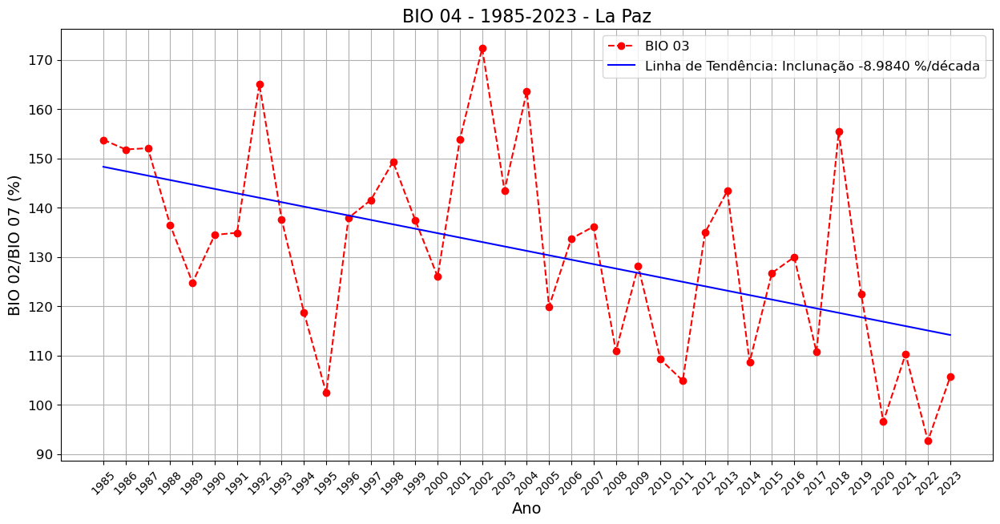

Inclinação da linha de tendência para Quito (1985-2023): 0.2266


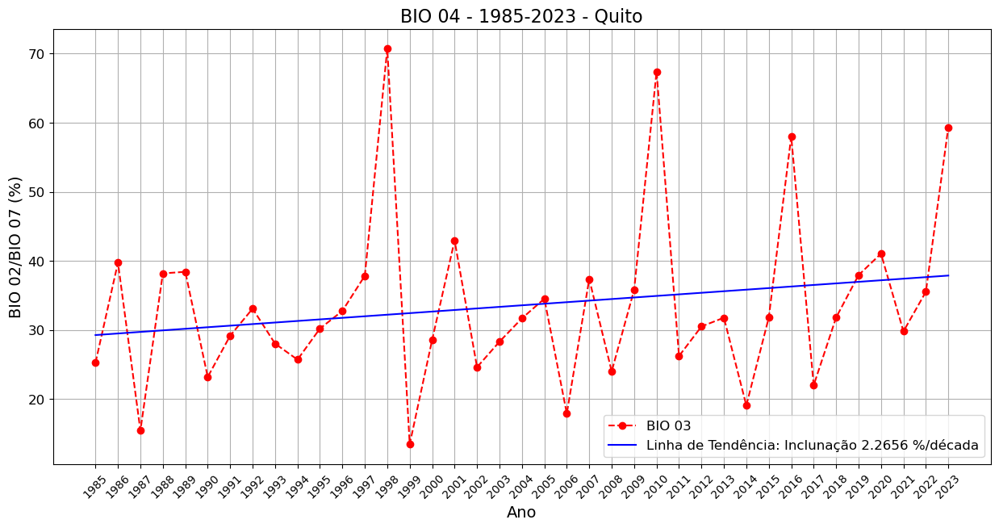

Inclinação da linha de tendência para Bogotá (1985-2023): -0.2070


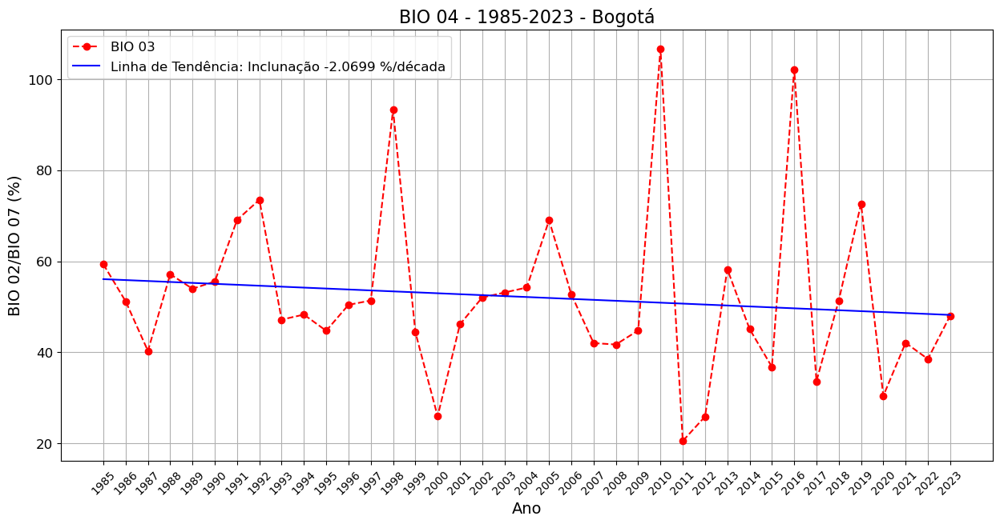

In [248]:
import matplotlib.pyplot as plt
import numpy as np

# Loop sobre as cidades no dataframe df_cap_AS
for i in range(len(df_cap_AS)):
    # Extrair anos e médias correspondentes de BIO01
    anos_texto = ['85','86','87','88','89','90','91','92','93','94','95','96','97','98','99',
                  '00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
                  '13','14', '15','16','17','18','19','20','21','22','23']  # Anos como strings
    
    temperaturas = []
    
    Dado = BIO04
    Nome = 'BIO 04'
    Cidade = df_cap_AS.iloc[i]['Cidade']  # Acesso correto ao nome da cidade
    latitude = df_cap_AS.iloc[i]['Latitude']
    longitude = df_cap_AS.iloc[i]['Longitude']
    
    # Extrair os dados de temperatura nas coordenadas fornecidas
    Temp = Dado.sel(lon=longitude, lat=latitude, method='nearest')
    
    # Anos de 1985 a 2023
    anos = list(range(1985, 2024))
    
    # Extrair as temperaturas anuais
    for ano in anos:
        var_name = f'{Nome} {ano}'
        temperaturas.append(Temp[var_name].values)  # Adiciona as temperaturas dos anos
    
    # Converter os anos para valores numéricos para facilitar o cálculo e o gráfico
    anos_num = np.arange(1985, 2024)
    
    # Calcular a linha de tendência (regressão linear)
    coef = np.polyfit(anos_num, temperaturas, 1)  # Ajuste linear
    linha_tendencia = np.polyval(coef, anos_num)
    
    # A inclinação da reta de tendência
    inclinacao = coef[0]  # O primeiro valor do coef representa a inclinação (coeficiente angular)
    
    # Exibir a inclinação
    print(f'Inclinação da linha de tendência para {Cidade} (1985-2023): {inclinacao:.4f}')
    
    # Criar o gráfico
    plt.figure(figsize=(15, 7))
    plt.plot(anos_num, temperaturas, marker='o', linestyle='--', color='r', label='BIO 03')
    plt.plot(anos_num, linha_tendencia, linestyle='-', color='b', label=f'Linha de Tendência: Inclunação {inclinacao*10:.4f} %/década')
    
    # Adicionar título e rótulos aos eixos
    plt.title(f'{Nome} - 1985-2023 - {Cidade}', fontsize=16)
    plt.xlabel('Ano', fontsize=14)
    plt.ylabel('BIO 02/BIO 07 (%)', fontsize=14)
    plt.xticks(anos_num, rotation=45, fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.legend(fontsize=12)
    
    plt.savefig(f"Mapas/Serie_Temp_{Nome}_{Cidade}.png", dpi=300, bbox_inches='tight')
    
    # Exibir o gráfico
    plt.show()


Inclinação da linha de tendência para São Paulo (1985-2023): -0.5915


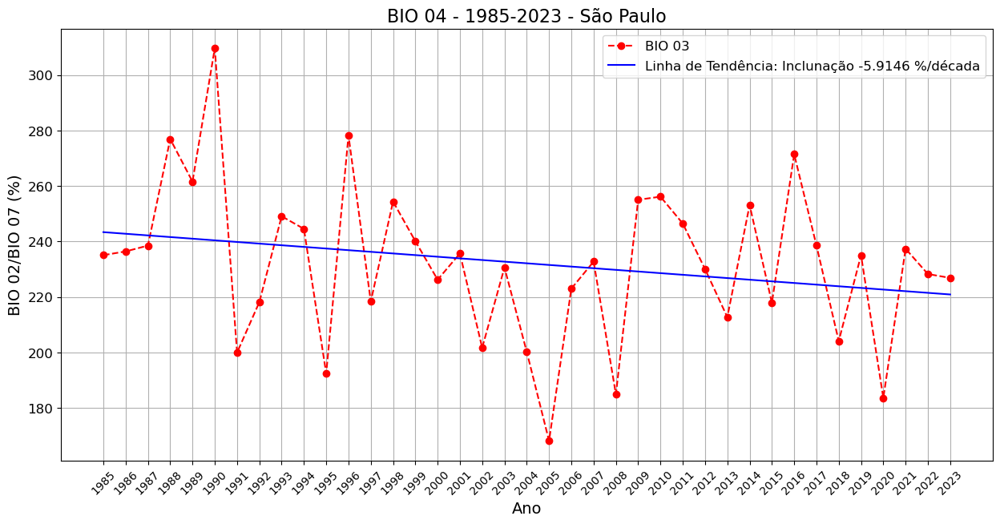

Inclinação da linha de tendência para Manaus (1985-2023): 1.3540


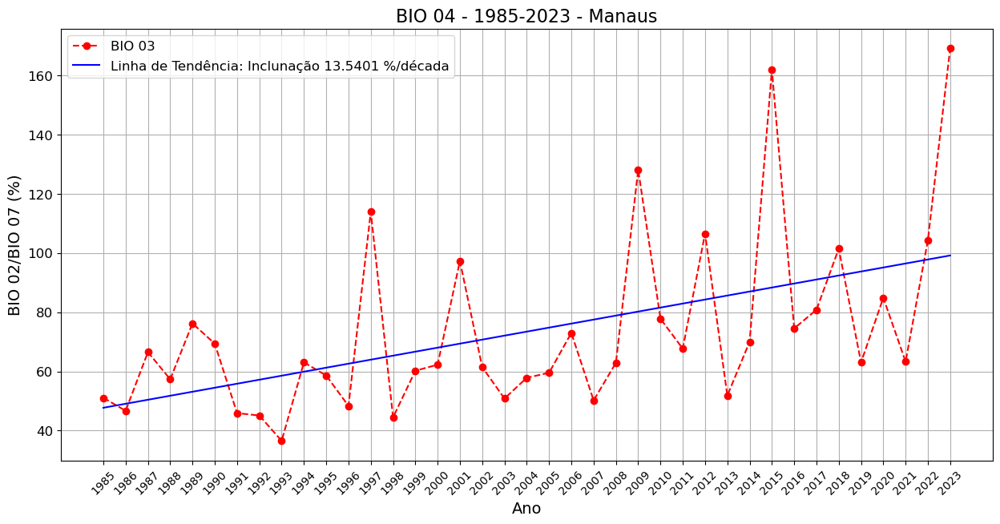

Inclinação da linha de tendência para Goiânia (1985-2023): 1.4081


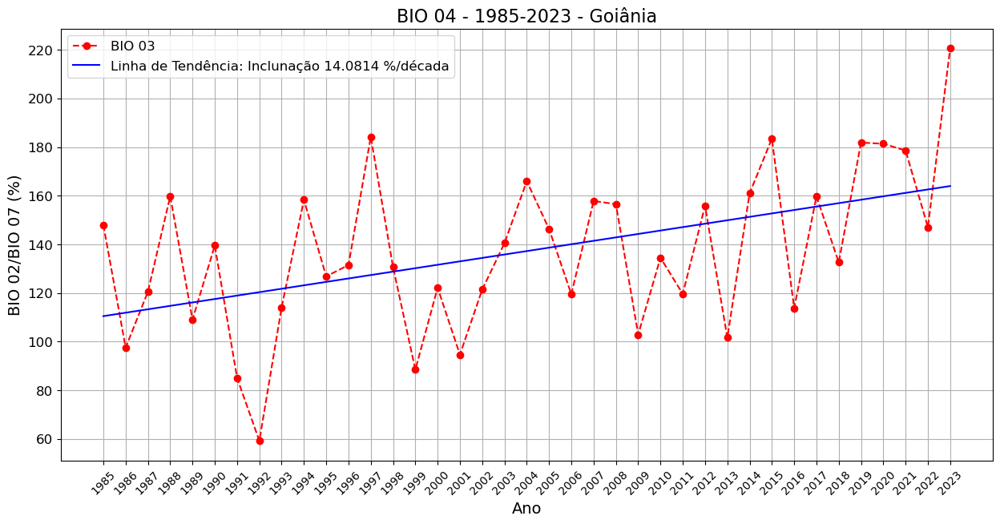

Inclinação da linha de tendência para Cuiabá (1985-2023): 0.7195


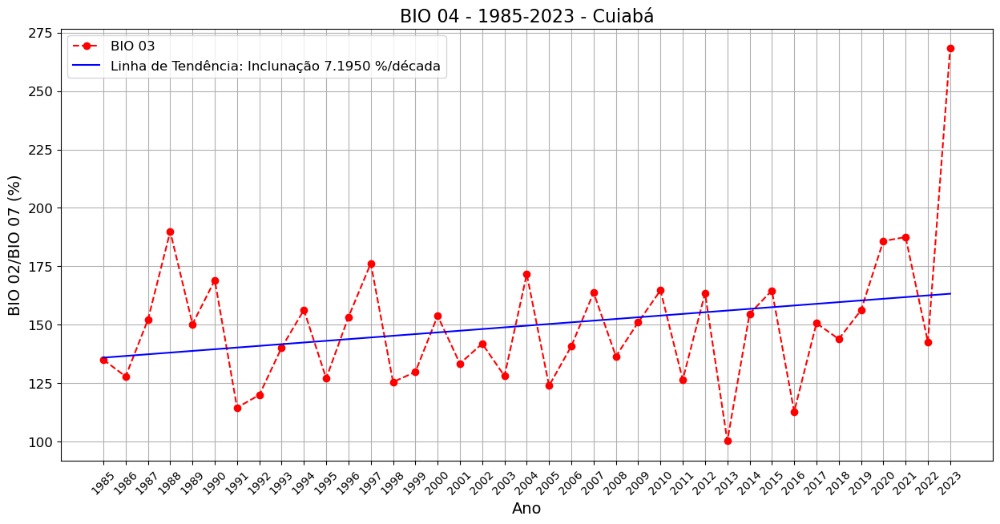

Inclinação da linha de tendência para Teresina (1985-2023): -0.2165


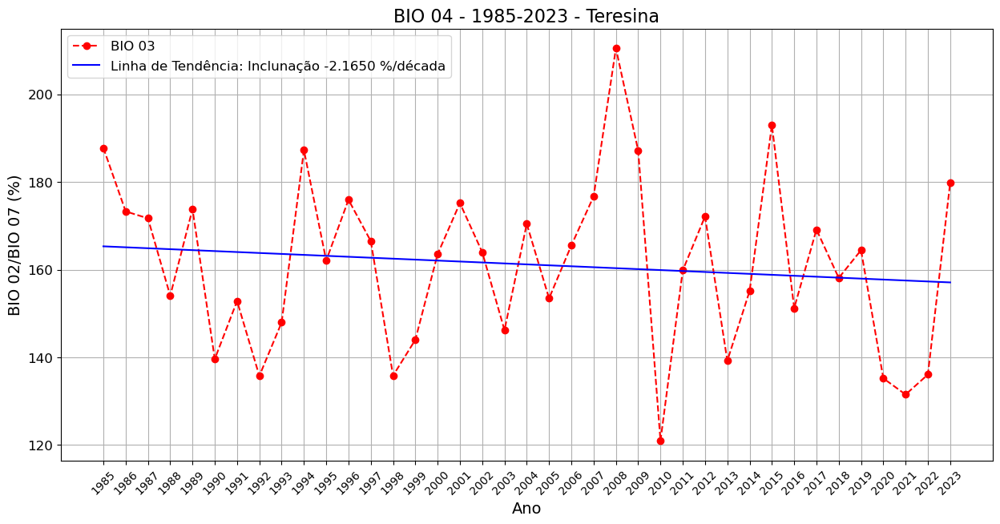

Inclinação da linha de tendência para Santa Maria (1985-2023): -0.1855


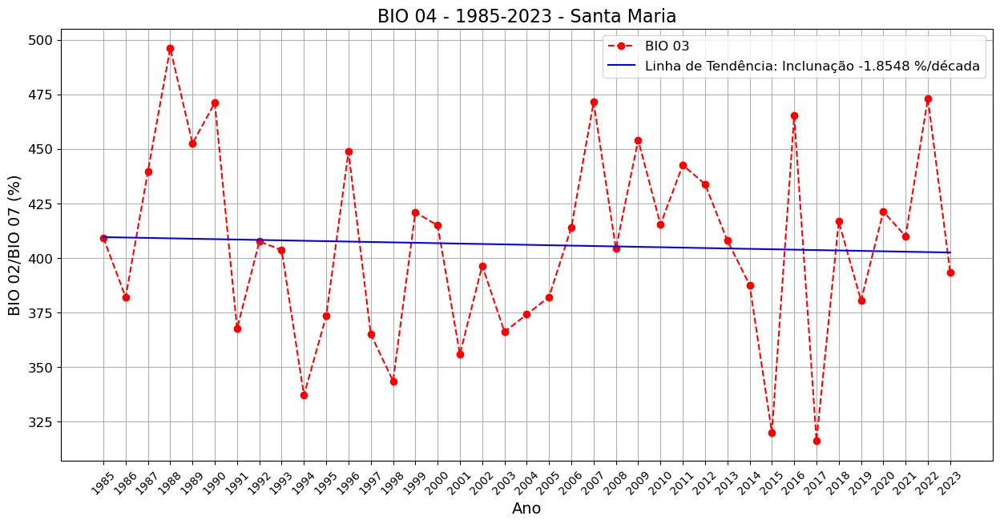

In [250]:
import matplotlib.pyplot as plt
import numpy as np

# Loop sobre as cidades no dataframe df_cap_AS
for i in range(len(df_cap_AS)):
    # Extrair anos e médias correspondentes de BIO01
    anos_texto = ['85','86','87','88','89','90','91','92','93','94','95','96','97','98','99',
                  '00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
                  '13','14', '15','16','17','18','19','20','21','22','23']  # Anos como strings
    
    temperaturas = []
    
    Dado = BIO04
    Nome = 'BIO 04'
    Cidade = df_cidades_copia.iloc[i]['Cidade']  # Acesso correto ao nome da cidade
    latitude = df_cidades_copia.iloc[i]['Latitude']
    longitude = df_cidades_copia.iloc[i]['Longitude']
    
    # Extrair os dados de temperatura nas coordenadas fornecidas
    Temp = Dado.sel(lon=longitude, lat=latitude, method='nearest')
    
    # Anos de 1985 a 2023
    anos = list(range(1985, 2024))
    
    # Extrair as temperaturas anuais
    for ano in anos:
        var_name = f'{Nome} {ano}'
        temperaturas.append(Temp[var_name].values)  # Adiciona as temperaturas dos anos
    
    # Converter os anos para valores numéricos para facilitar o cálculo e o gráfico
    anos_num = np.arange(1985, 2024)
    
    # Calcular a linha de tendência (regressão linear)
    coef = np.polyfit(anos_num, temperaturas, 1)  # Ajuste linear
    linha_tendencia = np.polyval(coef, anos_num)
    
    # A inclinação da reta de tendência
    inclinacao = coef[0]  # O primeiro valor do coef representa a inclinação (coeficiente angular)
    
    # Exibir a inclinação
    print(f'Inclinação da linha de tendência para {Cidade} (1985-2023): {inclinacao:.4f}')
    
    # Criar o gráfico
    plt.figure(figsize=(15, 7))
    plt.plot(anos_num, temperaturas, marker='o', linestyle='--', color='r', label='BIO 03')
    plt.plot(anos_num, linha_tendencia, linestyle='-', color='b', label=f'Linha de Tendência: Inclunação {inclinacao*10:.4f} %/década')
    
    # Adicionar título e rótulos aos eixos
    plt.title(f'{Nome} - 1985-2023 - {Cidade}', fontsize=16)
    plt.xlabel('Ano', fontsize=14)
    plt.ylabel('BIO 02/BIO 07 (%)', fontsize=14)
    plt.xticks(anos_num, rotation=45, fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.legend(fontsize=12)
    
    plt.savefig(f"Mapas/Serie_Temp_{Nome}_{Cidade}.png", dpi=300, bbox_inches='tight')
    
    # Exibir o gráfico
    plt.show()

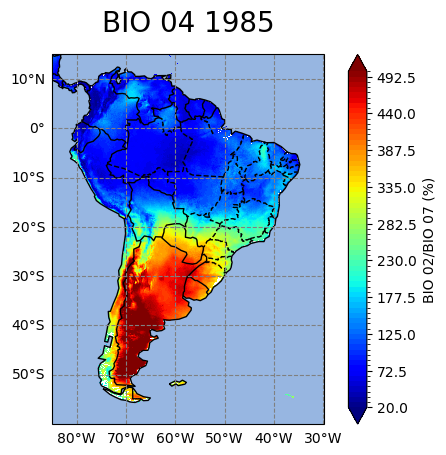

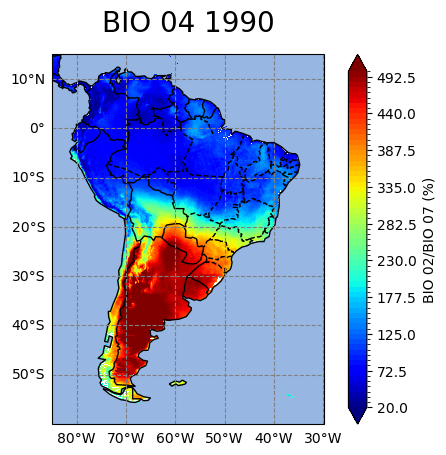

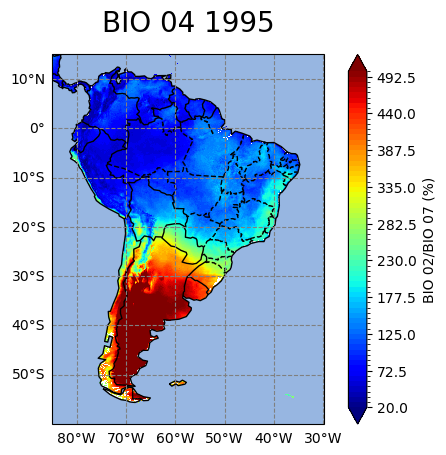

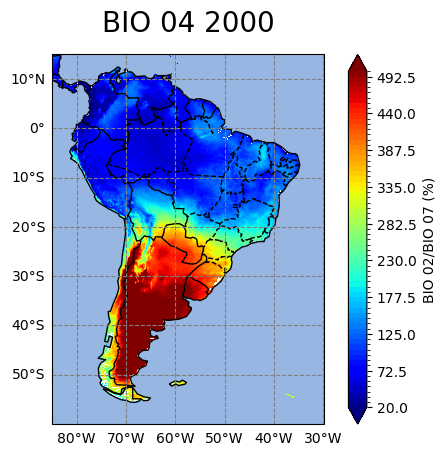

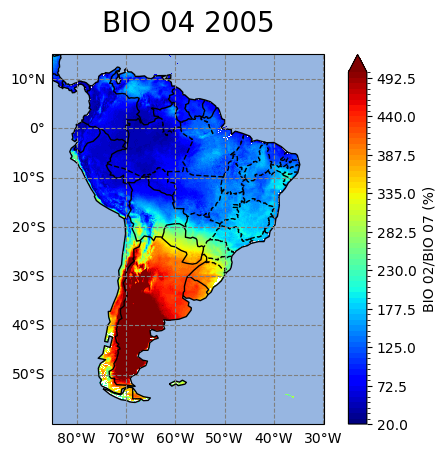

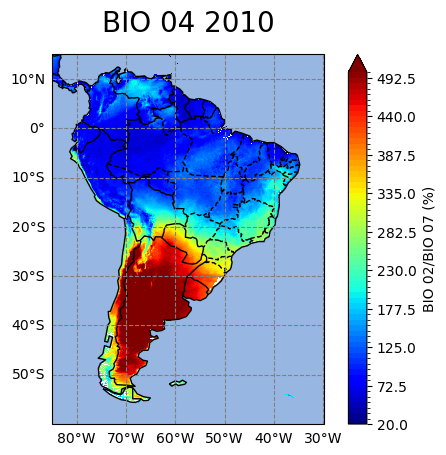

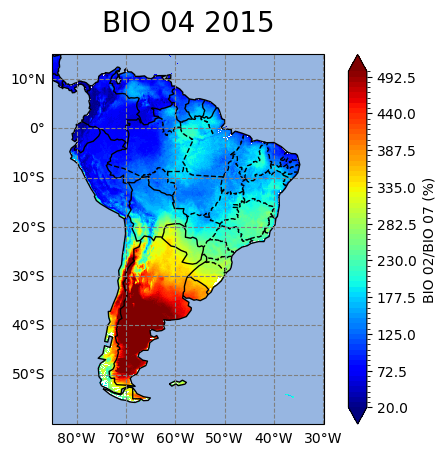

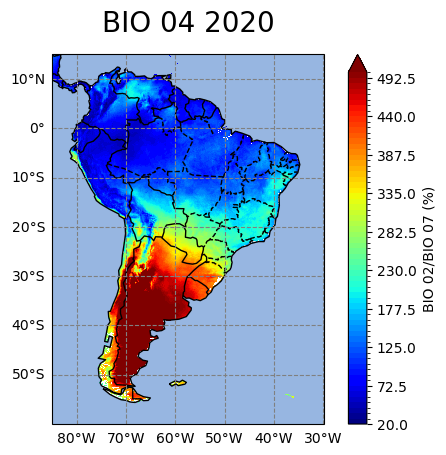

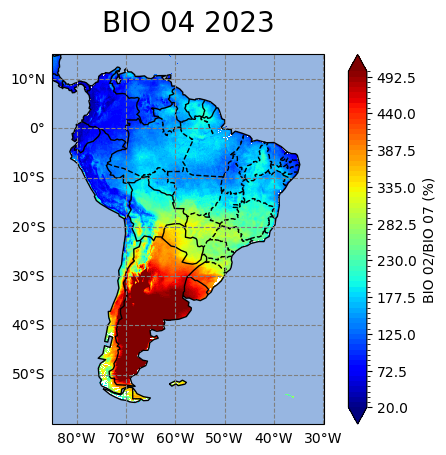

In [247]:
#Criando Mapa de Temperatura Anual média
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs # Escolha do sistema de coordenadas
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import xarray as xr
import cartopy.feature as cfeature

anos = list(range(1985,2023,5))+[2023]
for ano in anos:
    valor = f'BIO 04 {ano}'               
    Base= BIO04[valor]
    max = 500
    min = 20
    # Configurar o plot
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})
        
    # Plotar a média da temperatura
        
    Base.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='jet',levels=np.linspace(min, max, 65), cbar_kwargs={'label': 'BIO 02/BIO 07 (%)'})
    #Base.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='jet' , cbar_kwargs={'label': 'BIO 02/BIO 07 (%)'})   
    #levels=np.linspace(10, 30, 21) é utilizado para definir que a colorBar vai de 10° C até 30°, tendo 21 ponto 
        
        
    #Adicionando o contorno dos continentes, países e estados do Brasil
    #Adicionando o contorno dos continentes
    ax.add_feature(cfeature.COASTLINE)
        
    #Adicionando os limites dos países
    ax.add_feature(cfeature.BORDERS)
        
    #Adicionando o oceano
    ax.add_feature(cfeature.OCEAN)
        
    #Adicionando os limites estaduais
    states = cfeature.NaturalEarthFeature(category='cultural',
                                              name='admin_1_states_provinces_lines',
                                              scale='50m',
                                              facecolor='none')
    ax.add_feature(states, edgecolor='k', linestyle='--')
        
    #Adicionando título a figura 
    ax.set_title(valor, fontsize=20, y=1.04)
        
    #Adicionando as linhas de grade
    g1 = ax.gridlines(crs=ccrs.PlateCarree(), linestyle='--', color='gray', draw_labels=True)
        
    #Formatando os labels como latitude e longitude
    g1.yformatter = LATITUDE_FORMATTER
    g1.xformatter = LONGITUDE_FORMATTER
        
    #agora irei tirar as grades  superior e direita
    # Remove as linhas de grade à direita
    g1.ylabels_right = False  # Remove labels do eixo y à direita
    g1.right_labels = False  # Remove a linha de grade à direita
    g1.y_inline = False  # Evita que as linhas de grade internas sejam desenhadas
        
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
        
    # Remove as linhas de grade no topo (se necessário)
    g1.xlabels_top = False  # Remove labels do eixo x no topo
    g1.top_labels = False  # Remove a linha de grade no topo

    # Salvar e mostrar o gráfico
    #plt.savefig(f"Mapas/Mapa_{valor}.png", dpi=300, bbox_inches='tight')

In [188]:
import xarray as xr
# Criação do DataArray
TrimMaisFrio_ = xr.DataArray(
    data=TrimMaisFrio,  # Converte de Kelvin para Celsius
    dims=["lat","lon"],  # Dimensões
    coords=dict(
        lat=latitudes_unicas,  # Coordenadas de latitude (única)
        lon=longitudes_unicas  # Coordenadas de longitude (única)
    ),
    
)

# Visualização dos dados
display(TrimMaisFrio_ )

ValueError: different number of dimensions on data and dims: 0 vs 2

In [211]:
Tavgi

<xarray.DataArray (time: 470, lat: 750, lon: 551)> Size: 2GB
array([[[21.69163936, 21.42932552, 21.47783149, ...,         nan,
                 nan,         nan],
        [21.37450562, 21.30666578, 21.57105457, ...,         nan,
                 nan,         nan],
        [21.67657451, 21.9040929 , 22.06599874, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[22.5086034 , 22.31654293, 22.45373252, ...,         nan,
                 nan,         nan],
        [22.14458182, 22.2026298 , 22.50105847, ...,         nan,
                 nan,         nan],
        [22.50912519, 22.78266378, 22.99340128, ...,         nan,
                 nan,         nan],
...
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[23.63570241, 23.60928839, 24.07331185, ...,         nan,
                 nan,         nan],
        [23.48047475, 23.68755756, 23.78956599, ...,         nan,
                 nan,         nan],
        [24.07727414, 24.18500908, 24.03986958, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]]])
Coordinates:
  * time     (time) datetime64[ns] 4kB 1985-01-01 1985-02-01 ... 2024-02-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 4kB 1985 1985 1985 1985 1985 ... 2023 2023 2024 2024
Attributes:
    description:  Média entre as temperaturas máximas e mínimas mensais
    units:        °C
    source:       ERA-5 Land
    year:         1985 - 2023

In [243]:
import xarray as xr
import numpy as np
import pandas as pd

#temp = tmax-tmin
soma = xr.Dataset()
BIO04_2 = xr.Dataset()

#for ano in range(tmax['time'].dt.year.min().values,tmax['time'].dt.year.max().values):
for ano in range(2000,2001):
    print(ano)
    # Somar ao longo da dimensão 'time', ignorando NaN, e depois dividir por 12
    media = Tavgi.where(Tavgi['time'].dt.year == ano, drop=True).mean(dim='time')
    dado = Tavgi.where(Tavgi['time'].dt.year == ano, drop=True)
    
    for mes in range(tmax['time'].dt.month.min().values,tmax['time'].dt.month.max().values+1):
        print(mes)
        temp = dado.where(dado['time'].dt.month == mes, drop=True)
        #display(temp)
        if mes == 1:
            soma = ((teste-media)**2)
            display(teste)
        else:
            soma += ((teste-media)**2)
            display(soma)
        #BIO04_2[f'BIO 04 {ano}'] = 100*Tavgi.where(Tavgi['time'].dt.year == ano, drop=True).std(dim='time')
    BIO04_2 ['teste'] = (soma/12)**0.5

display(BIO04_2)



2000
1


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[339.33029889, 328.64112168, 335.06341518, ...,          nan,
                  nan,          nan],
        [325.77354853, 321.56534437, 338.54069329, ...,          nan,
                  nan,          nan],
        [334.01403085, 343.247165  , 359.94298874, ...,          nan,
                  nan,          nan],
        ...,
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan],
        [         nan,          nan,          nan, ...,          nan,
                  nan,          nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

2


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[198331.02015238, 185384.08543745, 193145.03083038, ...,
                     nan,             nan,             nan],
        [182070.01946025, 176992.03599196, 197404.45450674, ...,
                     nan,             nan,             nan],
        [191774.21816359, 202977.9161081 , 224556.36065212, ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

3


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[297496.53022856, 278076.12815618, 289717.54624557, ...,
                     nan,             nan,             nan],
        [273105.02919038, 265488.05398795, 296106.6817601 , ...,
                     nan,             nan,             nan],
        [287661.32724538, 304466.87416214, 336834.54097818, ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

4


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[396662.04030475, 370768.1708749 , 386290.06166076, ...,
                     nan,             nan,             nan],
        [364140.0389205 , 353984.07198393, 394808.90901347, ...,
                     nan,             nan,             nan],
        [383548.43632718, 405955.83221619, 449112.72130424, ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

5


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[495827.55038094, 463460.21359363, 482862.57707595, ...,
                     nan,             nan,             nan],
        [455175.04865063, 442480.08997991, 493511.13626684, ...,
                     nan,             nan,             nan],
        [479435.54540897, 507444.79027024, 561390.9016303 , ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

6


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[594993.06045713, 556152.25631236, 579435.09249114, ...,
                     nan,             nan,             nan],
        [546210.05838075, 530976.10797589, 592213.36352021, ...,
                     nan,             nan,             nan],
        [575322.65449077, 608933.74832429, 673669.08195636, ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

7


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[694158.57053332, 648844.29903108, 676007.60790633, ...,
                     nan,             nan,             nan],
        [637245.06811088, 619472.12597187, 690915.59077358, ...,
                     nan,             nan,             nan],
        [671209.76357256, 710422.70637834, 785947.26228242, ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

8


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[793324.08060951, 741536.34174981, 772580.12332151, ...,
                     nan,             nan,             nan],
        [728280.07784101, 707968.14396786, 789617.81802695, ...,
                     nan,             nan,             nan],
        [767096.87265435, 811911.66443238, 898225.44260847, ...,
                     nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan],
        [            nan,             nan,             nan, ...,
                     nan,             nan,             nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

9


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[ 892489.59068569,  834228.38446854,  869152.6387367 , ...,
                      nan,              nan,              nan],
        [ 819315.08757113,  796464.16196384,  888320.04528031, ...,
                      nan,              nan,              nan],
        [ 862983.98173615,  913400.62248643, 1010503.62293453, ...,
                      nan,              nan,              nan],
        ...,
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

10


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[ 991655.10076188,  926920.42718726,  965725.15415189, ...,
                      nan,              nan,              nan],
        [ 910350.09730126,  884960.17995982,  987022.27253368, ...,
                      nan,              nan,              nan],
        [ 958871.09081794, 1014889.58054048, 1122781.80326059, ...,
                      nan,              nan,              nan],
        ...,
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

11


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[1090820.61083807, 1019612.46990599, 1062297.66956708, ...,
                      nan,              nan,              nan],
        [1001385.10703138,  973456.1979558 , 1085724.49978705, ...,
                      nan,              nan,              nan],
        [1054758.19989974, 1116378.53859453, 1235059.98358665, ...,
                      nan,              nan,              nan],
        ...,
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

12


<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[1189986.12091426, 1112304.51262471, 1158870.18498227, ...,
                      nan,              nan,              nan],
        [1092420.11676151, 1061952.21595178, 1184426.72704042, ...,
                      nan,              nan,              nan],
        [1150645.30898153, 1217867.49664858, 1347338.16391271, ...,
                      nan,              nan,              nan],
        ...,
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan],
        [             nan,              nan,              nan, ...,
                      nan,              nan,              nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

<xarray.Dataset> Size: 3MB
Dimensions:  (time: 1, lat: 750, lon: 551)
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000
Data variables:
    teste    (time, lat, lon) float64 3MB 314.9 304.5 310.8 ... nan nan nan

In [217]:
teste=Tavgi.where(Tavgi['time'].dt.year == 2000, drop=True).mean(dim='time')

In [ ]:
teste2=Tavgi.where(Tavgi['time'].dt.year == 2000, drop=True)
teste3=teste2.where(teste2['time'].dt.month == 1, drop=True)
display(teste3)

In [221]:
teste3-teste

<xarray.DataArray (time: 1, lat: 750, lon: 551)> Size: 3MB
array([[[-2.45026965, -2.46149973, -2.44897745, ...,         nan,
                 nan,         nan],
        [-2.45036027, -2.47997951, -2.44379046, ...,         nan,
                 nan,         nan],
        [-2.46607845, -2.4792978 , -2.4272332 , ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]]])
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-01-01
  * lat      (lat) float64 6kB 14.95 14.85 14.75 14.65 ... -59.75 -59.85 -59.95
  * lon      (lon) float64 4kB -84.95 -84.85 -84.75 ... -30.15 -30.05 -29.95
    year     (time) int64 8B 2000

# Dados de Precipitação

In [25]:
print((2025-1999)*12)

#laço com os meses 1 - 12 com a adição de um zero antes do número e o corte de apenas dois números deixando números menores do que 10 com um zero antes.
data_GPM = np.array([[ str(ano)+"-"+("0"+str(mes))[-2:] for mes in range(1,13)] for ano in range(1998, 2024)]).flatten()

extra =  ['2024-01','2024-02']
data_GPM = np.append(data_GPM, extra)


# Converter para datetime64[ns]
data_GPM_datetime = np.array(data_GPM, dtype="datetime64[ns]")  # 'M' para precisão mensal

# Exibir shape e preview
print(data_GPM_datetime.shape)
print(data_GPM_datetime[:10])  # Visualizar as primeiras datas

312
(314,)
['1998-01-01T00:00:00.000000000' '1998-02-01T00:00:00.000000000'
 '1998-03-01T00:00:00.000000000' '1998-04-01T00:00:00.000000000'
 '1998-05-01T00:00:00.000000000' '1998-06-01T00:00:00.000000000'
 '1998-07-01T00:00:00.000000000' '1998-08-01T00:00:00.000000000'
 '1998-09-01T00:00:00.000000000' '1998-10-01T00:00:00.000000000']


In [26]:
import rasterio
#Abre o arquivo de Tmax tif.
Precip_GPM = rasterio.open("Precip.tif").read()
print('precip_GPM',Precip_GPM.shape)

precip_GPM (318, 750, 551)
